# Stock Analysis

## Part I : Business Case – Structured Problem Solving

### __Table of Content__ 

## Part II: Preliminary Steps - Data loading
1. Import relavent libraries required

2. Reading the datasets into dataframes

3. Data Preprocessing

    - a. Combining the datasets into single dataframe
    - b. Checking for null values
    - c. Including only the Close column from all the companies to form a final dataset
    - d. Final Data is the normalised data

## Part III: Data Exploration
4. Exploratory Data Analysis

    (I) Normalization
    
    - a. Technology Industry Stock Price and Volume with & without normalization
    - b. Aviation Industry Stock Price and Volume with & without normalization
    - c. Fixed Income Industry Stock Price and Volume with & without normalization
    - d. Health and Pharma Industry Stock Price and Volume with & without normalization
    (II). Moving Averages
    
    - a. Creating Moving Average based on Company and Index as Below
    - b. Moving Average for Open stock with SP500
    - c. Moving Average for Close stock with SP500
    - d. Moving Average for High stock with SP500
    - e. Moving Average for Low stock with SP500
    - f. Moving Average for Adj Close stock with SP500
    
    (III) Return Deviation — to determine risk and return
    
    - b. Daily return - Industry wise
    
    (IV) Understand the stock spread using box plots
    
    (V). What was the correlation between different stocks closing prices?
    
    - a. Aviation Correlation
    - b. Finance correlation
    - c. HealthPharma Correlation
    - d. Technology Correlation
    
    (VI) Outlier
    
    (VII) Stocks Returns Rate and Risk

## Part IV: Stock Analysis and Portfolio Management - CAPM
5. Performance Measures of a Portfolio

    - a. Daily return from each stock
    - b. Following dates shows the maximum and minimum drop for Securities
    - c. Average daily return from each stock
    - d. Total Portfolio Return
    - e. Cumulative return from the Portfolio
    - f. Portfolio Risk – Portfolio Standard Deviation
    - g. Sharpe Ratio - Industry wise
    - h. Monte Carlo Simulation and Efficient Frontier
    
        - (1) Portfolio 1
        - (2) Portfolio 2

6. Capital Asset Pricing Model (CAPM)

## Part V: Stock Price Prediction - Validation
    - a. Linear Regression - Portfolio 1
    - b. Linear Regression - Portfolio 2
    - c. Stock Price Prediction - Validation
    
        - (1) Time-Series - S&P500
        - (2) Time-Series - AAPL Model
        - (3) Time-Series - AMZN Model
        - (4) Time-Series - GOOG Model
        - (5) Time-Series - JNJ Model

## Part VI: Portfolio
- (1) Portfolio 1 and Return calculation
- (2) Portfolio 2 and Return calculation

## Part VI: Reporting

# Part 2: Preliminary Steps - Data loading

## 1.  Import relavent libraries required

In [1]:
#Basic libraries
!pip install PyPortfolioOpt
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime as dt
import warnings
import seaborn as sns
import matplotlib.dates as mdates
from matplotlib import style
import matplotlib as mpl
import re
from scipy import stats
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns
!pip install plotly
import plotly as px
warnings.filterwarnings("ignore")
%matplotlib inline
#%matplotlib notebook
import plotly.express as px

#Machine Learning Libraries
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
#from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
import itertools
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX

pd.set_option('display.max_columns', None)  # or 1000
pd.set_option('display.max_rows', None)  # or 1000
pd.set_option('display.max_colwidth', -1)  # or 199

## 2. Reading the datasets into dataframes

In [2]:
SP500 =  pd.read_csv('S&P500.csv', parse_dates=['Date'])
AAPL = pd.read_csv('AAPL.csv', parse_dates=['Date'])
AMZN = pd.read_csv('AMZN.csv', parse_dates=['Date'])
GOOG = pd.read_csv('GOOG.csv', parse_dates=['Date'])
ALK = pd.read_csv('ALK.csv',  parse_dates=['Date'])
HA = pd.read_csv('HA.csv',  parse_dates=['Date'])
AAL = pd.read_csv('AAL.csv', parse_dates=['Date'])
GS = pd.read_csv('GS.csv',  parse_dates=['Date'])
CS = pd.read_csv('CS.csv',  parse_dates=['Date'])
DB = pd.read_csv('DB.csv',  parse_dates=['Date'])
BHC = pd.read_csv('BHC.csv', parse_dates=['Date'])
JNJ = pd.read_csv('JNJ.csv', parse_dates=['Date'])
MRK = pd.read_csv('MRK.csv', parse_dates=['Date'])

## 3. Data Preprocessing

In [3]:
SP500.rename(columns={'Open': 'SP500_Open',
        'High': 'SP500_High',
        'Low': 'SP500_Low',
        'Close': 'SP500_Close',
        'Adj Close': 'SP500_Adj Close',
        'Volume': 'SP500_Volume'},inplace=True)
AAPL.rename(columns={'Open': 'AAPL_TECH_Open',
        'High': 'AAPL_TECH_High',
        'Low': 'AAPL_TECH_Low',
        'Close': 'AAPL_TECH_Close',
        'Adj Close': 'AAPL_TECH_Adj Close',
        'Volume': 'AAPL_TECH_Volume'},inplace=True)
AMZN.rename(columns={'Open': 'AMZN_TECH_Open',
        'High': 'AMZN_TECH_High',
        'Low': 'AMZN_TECH_Low',
        'Close': 'AMZN_TECH_Close',
        'Adj Close': 'AMZN_TECH_Adj Close',
        'Volume': 'AMZN_TECH_Volume'},inplace=True)
GOOG.rename(columns={'Open': 'GOOG_TECH_Open',
        'High': 'GOOG_TECH_High',
        'Low': 'GOOG_TECH_Low',
        'Close': 'GOOG_TECH_Close',
        'Adj Close': 'GOOG_TECH_Adj Close',
        'Volume': 'GOOG_TECH_Volume'},inplace=True)
ALK.rename(columns={'Open': 'ALK_AV_Open',
        'High': 'ALK_AV_High',
        'Low': 'ALK_AV_Low',
        'Close': 'ALK_AV_Close',
        'Adj Close': 'ALK_AV_Adj Close',
        'Volume': 'ALK_AV_Volume'},inplace=True)
HA.rename(columns={'Open': 'HA_AV_Open',
        'High': 'HA_AV_High',
        'Low': 'HA_AV_Low',
        'Close': 'HA_AV_Close',
        'Adj Close': 'HA_AV_Adj Close',
        'Volume': 'HA_AV_Volume'},inplace=True)
AAL.rename(columns={'Open': 'AAL_AV_Open',
        'High': 'AAL_AV_High',
        'Low': 'AAL_AV_Low',
        'Close': 'AAL_AV_Close',
        'Adj Close': 'AAL_AV_Adj Close',
        'Volume': 'AAL_AV_Volume'},inplace=True)
GS.rename(columns={'Open': 'GS_FI_Open',
        'High': 'GS_FI_High',
        'Low': 'GS_FI_Low',
        'Close': 'GS_FI_Close',
        'Adj Close': 'GS_FI_Adj Close',
        'Volume': 'GS_FI_Volume'},inplace=True)
CS.rename(columns={'Open': 'CS_FI_Open',
        'High': 'CS_FI_High',
        'Low': 'CS_FI_Low',
        'Close': 'CS_FI_Close',
        'Adj Close': 'CS_FI_Adj Close',
        'Volume': 'CS_FI_Volume'},inplace=True)
DB.rename(columns={'Open': 'DB_FI_Open',
        'High': 'DB_FI_High',
        'Low': 'DB_FI_Low',
        'Close': 'DB_FI_Close',
        'Adj Close': 'DB_FI_Adj Close',
        'Volume': 'DB_FI_Volume'},inplace=True)
BHC.rename(columns={'Open': 'BHC_HP_Open',
        'High': 'BHC_HP_High',
        'Low': 'BHC_HP_Low',
        'Close': 'BHC_HP_Close',
        'Adj Close': 'BHC_HP_Adj Close',
        'Volume': 'BHC_HP_Volume'},inplace=True)
JNJ.rename(columns={'Open': 'JNJ_HP_Open',
        'High': 'JNJ_HP_High',
        'Low': 'JNJ_HP_Low',
        'Close': 'JNJ_HP_Close',
        'Adj Close': 'JNJ_HP_Adj Close',
        'Volume': 'JNJ_HP_Volume'},inplace=True)
MRK.rename(columns={'Open': 'MRK_HP_Open',
        'High': 'MRK_HP_High',
        'Low': 'MRK_HP_Low',
        'Close': 'MRK_HP_Close',
        'Adj Close': 'MRK_HP_Adj Close',
        'Volume': 'MRK_HP_Volume'},inplace=True)

In [4]:
print('SP500',SP500.head(5))
print('AAPL',AAPL.head(5))
print('AMZN',AMZN.head(5))
print('GOOG',GOOG.head(5))
print('ALK',ALK.head(5))
print('HA',HA.head(5))
print('AAL',AAL.head(5))
print('GS',GS.head(5))
print('CS',CS.head(5))
print('DB',DB.head(5))
print('BHC',BHC.head(5))
print('JNJ',JNJ.head(5))
print('MRK',MRK.head(5))

SP500         Date   SP500_Open   SP500_High    SP500_Low  SP500_Close  \
0 2010-01-10  1143.489990  1150.300049  1139.420044  1146.239990   
1 2010-04-10  1144.959961  1148.160034  1131.869995  1137.030029   
2 2010-05-10  1140.680054  1162.760010  1140.680054  1160.750000   
3 2010-06-10  1159.810059  1162.329956  1154.849976  1159.969971   
4 2010-07-10  1161.569946  1163.869995  1151.410034  1158.060059   

   SP500_Adj Close  SP500_Volume  
0  1146.239990      4298910000    
1  1137.030029      3604110000    
2  1160.750000      4068840000    
3  1159.969971      4073160000    
4  1158.060059      3910550000    
AAPL         Date  AAPL_TECH_Open  AAPL_TECH_High  AAPL_TECH_Low  AAPL_TECH_Close  \
0 2010-01-10  10.219643       10.235000       10.048214      10.090000         
1 2010-04-10  10.057143       10.103572       9.920357       9.951428          
2 2010-05-10  10.071428       10.337500       10.065000      10.319285         
3 2010-06-10  10.342500       10.428214       10.1

In [5]:
# SP500['Name']='SP500'
# AAPL['Name']='AAPL'
# AMZN['Name']='AMZN'
# GOOG['Name']='GOOG'
# ALK['Name']='ALK'
# HA['Name']='HA'
# AAL['Name']='AAL'
# GS['Name']='GS'
# CS['Name']='CS'
# DB['Name']='DB'
# BHC['Name']='BHC'
# JNJ['Name']='JNJ'
# MRK['Name']='MRK'

In [6]:
# SP500['Industry']='SP500'
# AAPL['Industry']='Technology'
# AMZN['Industry']='Technology'
# GOOG['Industry']='Technology'
# ALK['Industry']='Aviation'
# HA['Industry']='Aviation'
# AAL['Industry']='Aviation'
# GS['Industry']='Finance'
# CS['Industry']='Finance'
# DB['Industry']='Finance'
# BHC['Industry']='Healthcare_Pharma'
# JNJ['Industry']='Healthcare_Pharma'
# MRK['Industry']='Healthcare_Pharma'

In [7]:
SP500 = SP500.set_index('Date')
AAPL = AAPL.set_index('Date')
AMZN = AMZN.set_index('Date')
GOOG = GOOG.set_index('Date')
ALK = ALK.set_index('Date')
HA = HA.set_index('Date')
AAL = AAL.set_index('Date')
GS = GS.set_index('Date')
CS = CS.set_index('Date')
DB = DB.set_index('Date')
BHC = BHC.set_index('Date')
JNJ = JNJ.set_index('Date')
MRK = MRK.set_index('Date')

In [8]:
SP500_df = SP500.copy()
AAPL_df = AAPL.copy()
AMZN_df = AMZN.copy()
GOOG_df = GOOG.copy()
ALK_df = ALK.copy()
HA_df = HA.copy()
AAL_df = AAL.copy()
GS_df = GS.copy()
CS_df = CS.copy()
DB_df = DB.copy()
BHC_df = BHC.copy()
JNJ_df = JNJ.copy()
MRK_df = MRK.copy()

In [9]:
SP500.head(5)

,SP500_Open,SP500_High,SP500_Low,SP500_Close,SP500_Adj Close,SP500_Volume
Date,,,,,,
2010-01-10,1143.489990,1150.300049,1139.420044,1146.239990,1146.239990,4298910000
2010-04-10,1144.959961,1148.160034,1131.869995,1137.030029,1137.030029,3604110000
2010-05-10,1140.680054,1162.760010,1140.680054,1160.750000,1160.750000,4068840000
2010-06-10,1159.810059,1162.329956,1154.849976,1159.969971,1159.969971,4073160000
2010-07-10,1161.569946,1163.869995,1151.410034,1158.060059,1158.060059,3910550000


### 3 a. Combining the datasets into single dataframe

In [10]:
securities = [AAPL, AMZN, GOOG, ALK, HA, AAL, GS, CS, DB, BHC, JNJ, MRK]
data=SP500
#data=pd.concat(csv, axis=1, join='inner')

for x in securities:
    data = pd.merge(data, x, on="Date", how='left')
data.head()

,SP500_Open,SP500_High,SP500_Low,SP500_Close,SP500_Adj Close,SP500_Volume,AAPL_TECH_Open,AAPL_TECH_High,AAPL_TECH_Low,AAPL_TECH_Close,AAPL_TECH_Adj Close,AAPL_TECH_Volume,AMZN_TECH_Open,AMZN_TECH_High,AMZN_TECH_Low,AMZN_TECH_Close,AMZN_TECH_Adj Close,AMZN_TECH_Volume,GOOG_TECH_Open,GOOG_TECH_High,GOOG_TECH_Low,GOOG_TECH_Close,GOOG_TECH_Adj Close,GOOG_TECH_Volume,ALK_AV_Open,ALK_AV_High,ALK_AV_Low,ALK_AV_Close,ALK_AV_Adj Close,ALK_AV_Volume,HA_AV_Open,HA_AV_High,HA_AV_Low,HA_AV_Close,HA_AV_Adj Close,HA_AV_Volume,AAL_AV_Open,AAL_AV_High,AAL_AV_Low,AAL_AV_Close,AAL_AV_Adj Close,AAL_AV_Volume,GS_FI_Open,GS_FI_High,GS_FI_Low,GS_FI_Close,GS_FI_Adj Close,GS_FI_Volume,CS_FI_Open,CS_FI_High,CS_FI_Low,CS_FI_Close,CS_FI_Adj Close,CS_FI_Volume,DB_FI_Open,DB_FI_High,DB_FI_Low,DB_FI_Close,DB_FI_Adj Close,DB_FI_Volume,BHC_HP_Open,BHC_HP_High,BHC_HP_Low,BHC_HP_Close,BHC_HP_Adj Close,BHC_HP_Volume,JNJ_HP_Open,JNJ_HP_High,JNJ_HP_Low,JNJ_HP_Close,JNJ_HP_Adj Close,JNJ_HP_Volume,MRK_HP_Open,MRK_HP_High,MRK_HP_Low,MRK_HP_Close,MRK_HP_Adj Close,MRK_HP_Volume
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-10,1143.489990,1150.300049,1139.420044,1146.239990,1146.239990,4298910000,10.219643,10.235000,10.048214,10.090000,8.719163,448142800,157.080002,157.440002,152.199997,153.710007,153.710007,8683400.0,264.010437,264.319275,260.523499,261.828613,261.828613,4466600.0,12.9325,12.9625,12.3675,12.4475,10.972344,1663600.0,6.02,6.05,5.88,5.96,5.742526,645400.0,9.29,9.39,9.21,9.29,8.758067,3603800,145.199997,148.500000,144.820007,147.699997,127.147858,7439800.0,41.835938,42.285156,41.562500,42.226563,30.167257,1814900.0,52.585876,52.862595,52.003819,52.595421,44.981487,2010600.0,25.120001,25.879999,25.100000,25.750000,24.757708,5778700.0,62.090000,62.250000,61.570000,61.750000,45.970119,9773200.0,36.759998,36.840000,36.349998,36.599998,26.052284,11741900.0
2010-04-10,1144.959961,1148.160034,1131.869995,1137.030029,1137.030029,3604110000,10.057143,10.103572,9.920357,9.951428,8.599421,435302000,153.949997,155.960007,152.789993,155.389999,155.389999,5346500.0,261.494843,263.138702,258.456238,260.199707,260.199707,3895400.0,12.4300,12.5900,11.9975,12.1425,10.703489,1512400.0,5.96,6.00,5.73,5.75,5.540189,618900.0,9.24,9.48,9.05,9.12,8.597802,3856800,147.699997,148.470001,144.699997,146.570007,126.175117,5866700.0,42.265625,42.431641,41.582031,41.914063,29.943998,1085600.0,52.204197,52.604961,51.412212,51.755726,44.263348,1245600.0,25.750000,25.990000,25.590000,25.870001,24.873083,4187200.0,61.540001,61.980000,61.299999,61.669998,45.910553,8703600.0,36.490002,36.750000,36.290001,36.520000,25.995331,9234900.0
2010-05-10,1140.680054,1162.760010,1140.680054,1160.750000,1160.750000,4068840000,10.071428,10.337500,10.065000,10.319285,8.917298,501967200,157.080002,161.210007,157.009995,160.869995,160.869995,5620000.0,263.203461,268.991760,262.291870,268.110046,268.110046,7040400.0,12.2600,12.2850,11.9450,12.2150,10.767396,2567200.0,5.82,5.93,5.77,5.85,5.636539,534800.0,9.27,9.35,9.15,9.23,8.701504,3896600,147.559998,150.279999,146.070007,149.570007,128.757706,8724700.0,42.607422,43.427734,42.509766,43.154297,30.830046,1025300.0,52.891220,54.427483,52.795803,53.950382,46.140301,2270900.0,26.040001,26.330000,25.830000,26.299999,25.286512,4610300.0,62.080002,62.939999,62.009998,62.799999,46.751797,12439400.0,36.860001,37.150002,36.700001,37.020000,26.351234,10669200.0
2010-06-10,1159.810059,1162.329956,1154.849976,1159.969971,1159.969971,4073160000,10.342500,10.428214,10.187857,10.328215,8.925013,670868800,160.600006,160.679993,154.600006,155.399994,155.399994,6060800.0,268.623138,268.966858,263.980530,266.177307,266.177307,5545200.0,12.2200,12.3950,12.0875,12.1875,10.743157,1043600.0,5.85,6.05,5.85,5.97,5.752162,2563900.0,9.27,9.40,9.15,9.23,8.701504,3230200,149.750000,152.330002,149.130005,150.839996,129.850906,6330600.0,43.496094,43.701172,43.330078,43.437500,31.032362,871300.0,54.723282,54.971375,54.398853,54.608780,46.703384,18

##### Complete combined dataset in complete_data

In [11]:
complete_data = data.copy()

In [12]:
complete_col = list(complete_data.columns)

In [13]:
sec_name = ["SP500", "AAPL", "AMZN", "GOOG", "ALK", "HA", "AAL", "GS", "CS", "DB", "BHC", "JNJ", "MRK"]

# data=[]
# for x in csv:
#     #df = pd.read_csv(x)
#     data.append(x)
#     #print(x)
# data = pd.concat(data)
# #data.reset_index(inplace=True, drop=True)
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2517 entries, 2010-01-10 to 2020-09-30
Data columns (total 78 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   SP500_Open           2517 non-null   float64
 1   SP500_High           2517 non-null   float64
 2   SP500_Low            2517 non-null   float64
 3   SP500_Close          2517 non-null   float64
 4   SP500_Adj Close      2517 non-null   float64
 5   SP500_Volume         2517 non-null   int64  
 6   AAPL_TECH_Open       2517 non-null   float64
 7   AAPL_TECH_High       2517 non-null   float64
 8   AAPL_TECH_Low        2517 non-null   float64
 9   AAPL_TECH_Close      2517 non-null   float64
 10  AAPL_TECH_Adj Close  2517 non-null   float64
 11  AAPL_TECH_Volume     2517 non-null   int64  
 12  AMZN_TECH_Open       2517 non-null   float64
 13  AMZN_TECH_High       2517 non-null   float64
 14  AMZN_TECH_Low        2517 non-null   float64
 15  AMZN_TECH_Close     

### 3 b. Checking for null values

In [14]:
data.isnull().sum()

SP500_Open             0
SP500_High             0
SP500_Low              0
SP500_Close            0
SP500_Adj Close        0
SP500_Volume           0
AAPL_TECH_Open         0
AAPL_TECH_High         0
AAPL_TECH_Low          0
AAPL_TECH_Close        0
AAPL_TECH_Adj Close    0
AAPL_TECH_Volume       0
AMZN_TECH_Open         0
AMZN_TECH_High         0
AMZN_TECH_Low          0
AMZN_TECH_Close        0
AMZN_TECH_Adj Close    0
AMZN_TECH_Volume       0
GOOG_TECH_Open         0
GOOG_TECH_High         0
GOOG_TECH_Low          0
GOOG_TECH_Close        0
GOOG_TECH_Adj Close    0
GOOG_TECH_Volume       0
ALK_AV_Open            0
ALK_AV_High            0
ALK_AV_Low             0
ALK_AV_Close           0
ALK_AV_Adj Close       0
ALK_AV_Volume          0
HA_AV_Open             0
HA_AV_High             0
HA_AV_Low              0
HA_AV_Close            0
HA_AV_Adj Close        0
HA_AV_Volume           0
AAL_AV_Open            0
AAL_AV_High            0
AAL_AV_Low             0
AAL_AV_Close           0


In [15]:
data.shape

(2517, 78)

### 3 c. Including only the Close column from all the companies to form a final dataset

In [16]:
data_1 = data[['SP500_Close', 'AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close', 'MRK_HP_Close']]
data_1.shape

(2517, 13)

In [17]:
data_1.head()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,,,,,,,,,
2010-01-10,1146.239990,10.090000,153.710007,261.828613,12.4475,5.96,9.29,147.699997,42.226563,52.595421,25.750000,61.750000,36.599998
2010-04-10,1137.030029,9.951428,155.389999,260.199707,12.1425,5.75,9.12,146.570007,41.914063,51.755726,25.870001,61.669998,36.520000
2010-05-10,1160.750000,10.319285,160.869995,268.110046,12.2150,5.85,9.23,149.570007,43.154297,53.950382,26.299999,62.799999,37.020000
2010-06-10,1159.969971,10.328215,155.399994,266.177307,12.1875,5.97,9.23,150.839996,43.437500,54.608780,26.690001,63.209999,37.009998
2010-07-10,1158.060059,10.329286,156.270004,264.015411,11.6250,6.15,9.24,151.110001,43.671875,54.036259,26.600000,63.220001,36.709999


In [18]:
data_1.describe()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
count,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000
mean,2111.392732,33.454670,854.636107,730.426139,50.031176,22.870413,29.397636,179.598184,21.501379,27.304930,61.880687,105.277378,57.161053
std,612.227235,20.630118,745.201139,364.685720,24.187020,15.483034,15.211889,42.405475,8.988043,15.409974,57.170002,28.174233,15.164505
min,1099.229980,9.951428,153.029999,236.553345,11.620000,3.780000,4.000000,87.699997,6.670000,5.480000,8.510000,57.660000,29.809999
25%,1562.170044,18.961428,266.489990,403.642059,26.780001,7.030000,13.010000,154.990005,13.740000,13.470000,22.170000,81.930000,45.730000
50%,2071.219971,27.592501,533.750000,651.789978,58.540001,21.910000,32.520000,177.229996,19.639999,28.370001,38.759998,104.040001,57.180000
75%,2656.300049,42.962502,1500.000000,1055.810059,67.260002,36.900002,42.200001,211.580002,27.750000,41.049618,90.269997,130.979996,64.089996
max,3580.840088,134.179993,3531.449951,1728.280029,100.239998,60.299999,58.470001,273.380005,46.513672,62.624046,262.519989,155.509995,92.040001


In [19]:
data_1_col = list(data_1.iloc[0])
data_1_col

[1146.23999,
 10.09,
 153.710007,
 261.828613,
 12.4475,
 5.96,
 9.29,
 147.699997,
 42.226563,
 52.595421,
 25.75,
 61.75,
 36.599998]

### 3 d. Final Data is the normalised data

In [20]:
sub = list(data_1.iloc[0])
sub

[1146.23999,
 10.09,
 153.710007,
 261.828613,
 12.4475,
 5.96,
 9.29,
 147.699997,
 42.226563,
 52.595421,
 25.75,
 61.75,
 36.599998]

In [21]:
complete_sub = list(complete_data.iloc[0])
complete_sub

[1143.48999,
 1150.300049,
 1139.420044,
 1146.23999,
 1146.23999,
 4298910000.0,
 10.219643,
 10.235,
 10.048214,
 10.09,
 8.719163,
 448142800.0,
 157.080002,
 157.440002,
 152.199997,
 153.710007,
 153.710007,
 8683400.0,
 264.010437,
 264.319275,
 260.523499,
 261.828613,
 261.828613,
 4466600.0,
 12.9325,
 12.9625,
 12.3675,
 12.4475,
 10.972344,
 1663600.0,
 6.02,
 6.05,
 5.88,
 5.96,
 5.742526,
 645400.0,
 9.29,
 9.39,
 9.21,
 9.29,
 8.758067,
 3603800.0,
 145.199997,
 148.5,
 144.820007,
 147.699997,
 127.147858,
 7439800.0,
 41.835938,
 42.285156,
 41.5625,
 42.226563,
 30.167257,
 1814900.0,
 52.585876,
 52.862595,
 52.003819,
 52.595421,
 44.981487,
 2010600.0,
 25.120001,
 25.879999,
 25.1,
 25.75,
 24.757708,
 5778700.0,
 62.09,
 62.25,
 61.57,
 61.75,
 45.970119,
 9773200.0,
 36.759998,
 36.84,
 36.349998,
 36.599998,
 26.052284,
 11741900.0]

In [22]:
complete_data_scaled = complete_data.div(complete_sub, axis='columns')
complete_data_scaled.head(2)

,SP500_Open,SP500_High,SP500_Low,SP500_Close,SP500_Adj Close,SP500_Volume,AAPL_TECH_Open,AAPL_TECH_High,AAPL_TECH_Low,AAPL_TECH_Close,AAPL_TECH_Adj Close,AAPL_TECH_Volume,AMZN_TECH_Open,AMZN_TECH_High,AMZN_TECH_Low,AMZN_TECH_Close,AMZN_TECH_Adj Close,AMZN_TECH_Volume,GOOG_TECH_Open,GOOG_TECH_High,GOOG_TECH_Low,GOOG_TECH_Close,GOOG_TECH_Adj Close,GOOG_TECH_Volume,ALK_AV_Open,ALK_AV_High,ALK_AV_Low,ALK_AV_Close,ALK_AV_Adj Close,ALK_AV_Volume,HA_AV_Open,HA_AV_High,HA_AV_Low,HA_AV_Close,HA_AV_Adj Close,HA_AV_Volume,AAL_AV_Open,AAL_AV_High,AAL_AV_Low,AAL_AV_Close,AAL_AV_Adj Close,AAL_AV_Volume,GS_FI_Open,GS_FI_High,GS_FI_Low,GS_FI_Close,GS_FI_Adj Close,GS_FI_Volume,CS_FI_Open,CS_FI_High,CS_FI_Low,CS_FI_Close,CS_FI_Adj Close,CS_FI_Volume,DB_FI_Open,DB_FI_High,DB_FI_Low,DB_FI_Close,DB_FI_Adj Close,DB_FI_Volume,BHC_HP_Open,BHC_HP_High,BHC_HP_Low,BHC_HP_Close,BHC_HP_Adj Close,BHC_HP_Volume,JNJ_HP_Open,JNJ_HP_High,JNJ_HP_Low,JNJ_HP_Close,JNJ_HP_Adj Close,JNJ_HP_Volume,MRK_HP_Open,MRK_HP_High,MRK_HP_Low,MRK_HP_Close,MRK_HP_Adj Close,MRK_HP_Volume
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-10,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0000,1.000000,1.00000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.00000,1.000000,1.00000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2010-04-10,1.001286,0.99814,0.993374,0.991965,0.991965,0.838378,0.984099,0.987159,0.987276,0.986266,0.986267,0.971347,0.980074,0.9906,1.003876,1.01093,1.01093,0.615715,0.990472,0.995534,0.992065,0.993779,0.993779,0.872117,0.961144,0.971263,0.970083,0.975497,0.975497,0.909113,0.990033,0.991736,0.97449,0.964765,0.964765,0.95894,0.994618,1.009585,0.982628,0.981701,0.981701,1.070204,1.017218,0.999798,0.999171,0.992349,0.99235,0.788556,1.010271,1.003464,1.00047,0.992599,0.992599,0.59816,0.992742,0.995126,0.988624,0.984035,0.984035,0.619517,1.02508,1.00425,1.019522,1.00466,1.00466,0.724592,0.991142,0.995663,0.995615,0.998704,0.998704,0.890558,0.992655,0.997557,0.998349,0.997814,0.997814,0.786491


In [23]:
final_data_scaled = data_1.div(sub, axis='columns')
final_data_scaled.head(2)

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,,,,,,,,,
2010-01-10,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000
2010-04-10,0.991965,0.986266,1.01093,0.993779,0.975497,0.964765,0.981701,0.992349,0.992599,0.984035,1.00466,0.998704,0.997814


In [24]:
# from sklearn.preprocessing import MinMaxScaler
# scaler = MinMaxScaler()


In [25]:
# complete_data_scaled = scaler.fit_transform(complete_data)
# complete_data_scaled = pd.DataFrame(complete_data_scaled, columns=complete_col)
# complete_data_scaled.head(5)

In [26]:
# final_data_scaled = scaler.fit_transform(data_1)
# final_data_scaled = pd.DataFrame(final_data_scaled, columns=["SP500_Close", "AAPL_TECH_Close", "AMZN_TECH_Close", "GOOG_TECH_Close", "ALK_AV_Close", "HA_AV_Close", "AAL_AV_Close", "GS_FI_Close", "CS_FI_Close", "DB_FI_Close", "BHC_HP_Close", "JNJ_HP_Close", "MRK_HP_Close"])
# final_data_scaled.head(6)

In [27]:
# final_data = data_1.div(data_1_col, axis="columns")
# final_data

# from sklearn.preprocessing import StandardScaler
# sc = StandardScaler()
# final_data = sc.fit_transform(data_1)
# final_data

# Part III: Data Exploration

## 4. Exploratory Data Analysis

## 4 (I) Normalization

### a. Technology Industry Stock Price and Volume with & without normalization

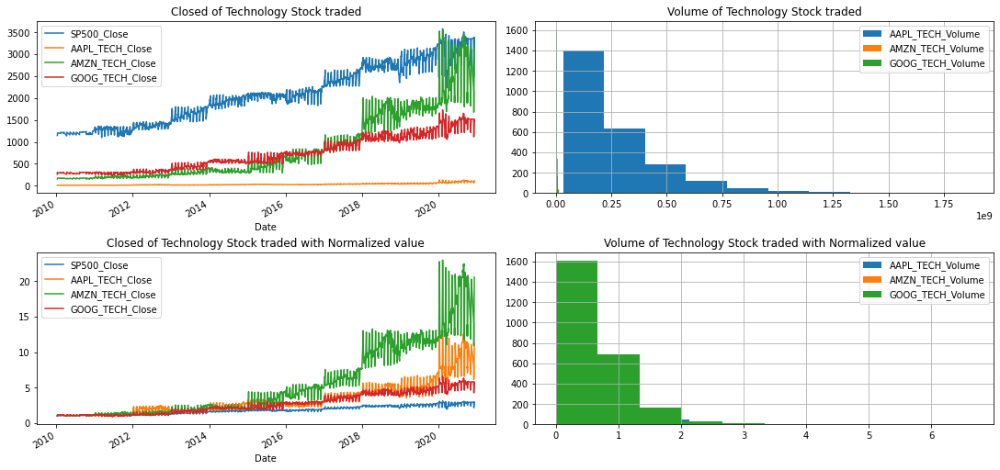

In [28]:
#Technology Industry Stock Price without normalization
########################################################
# Plot the Close price without Normalization
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(15,10), constrained_layout=True)
data_1['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax= ax1)
data_1['AAPL_TECH_Close'].plot(label = "AAPL_TECH_Close", ax= ax1)
data_1['AMZN_TECH_Close'].plot(label = 'AMZN_TECH_Close', ax= ax1)
data_1['GOOG_TECH_Close'].plot(label = 'GOOG_TECH_Close', ax= ax1)
ax1.set_title('Closed of Technology Stock traded')
ax1.legend()
plt.plot()

#Technology Industry Volume without normalization
########################################################
#complete_data['SP500_Volume'].hist(label = 'SP500_Volume', figsize = (15,7))
complete_data['AAPL_TECH_Volume'].hist(label = "AAPL_TECH_Volume", ax= ax2)
complete_data['AMZN_TECH_Volume'].hist(label = 'AMZN_TECH_Volume', ax= ax2)
complete_data['GOOG_TECH_Volume'].hist(label = 'GOOG_TECH_Volume', ax= ax2)
ax2.set_title('Volume of Technology Stock traded')
ax2.legend()

#Technology Industry Stock Price with normalization
########################################################
# Plot the Close price with normalization
final_data_scaled['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax= ax3)
final_data_scaled['AAPL_TECH_Close'].plot(label = "AAPL_TECH_Close", ax= ax3)
final_data_scaled['AMZN_TECH_Close'].plot(label = 'AMZN_TECH_Close', ax= ax3)
final_data_scaled['GOOG_TECH_Close'].plot(label = 'GOOG_TECH_Close', ax= ax3)
ax3.set_title('Closed of Technology Stock traded with Normalized value')
ax3.legend()
plt.plot()

#Technology Industry Volume with normalization
########################################################
#complete_data_scaled['SP500_Volume'].hist(label = 'SP500_Volume', figsize = (15,7), ax= ax4)
complete_data_scaled['AAPL_TECH_Volume'].hist(label = "AAPL_TECH_Volume", ax= ax4)
complete_data_scaled['AMZN_TECH_Volume'].hist(label = 'AMZN_TECH_Volume', ax= ax4)
complete_data_scaled['GOOG_TECH_Volume'].hist(label = 'GOOG_TECH_Volume', ax= ax4)
ax4.set_title('Volume of Technology Stock traded with Normalized value')
ax4.legend()

### Technology Industry Stock Price with normalization data

- Uptrend: S&P500 with all Technology industry companies are in uptrend. (AAPL, AMZN & GOOG)
- __GOOG seems having lot of volume in market__

## 4 (I) b. Aviation Industry Stock Price and Volume with & without normalization

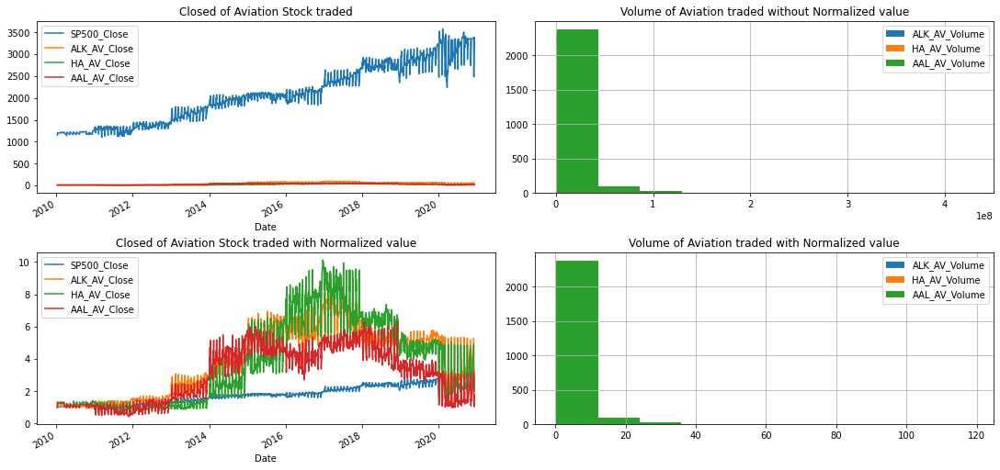

In [29]:
#Aviation Industry Stock Price without normalization
########################################################
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(15,10), constrained_layout=True)
data_1['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax= ax1)
data_1['ALK_AV_Close'].plot(label = "ALK_AV_Close", ax= ax1)
data_1['HA_AV_Close'].plot(label = 'HA_AV_Close', ax= ax1)
data_1['AAL_AV_Close'].plot(label = 'AAL_AV_Close', ax= ax1)
ax1.set_title('Closed of Aviation Stock traded')
ax1.legend()
plt.plot()

#Aviation Industry Volume without normalization
########################################################
#complete_data['SP500_Volume'].hist(label = 'SP500_Volume', figsize = (15,7))
#complete_data['SP500_Close'].hist(label = 'SP500_Close', figsize = (15,7), ax= ax2)
complete_data['ALK_AV_Volume'].hist(label = "ALK_AV_Volume", ax= ax2)
complete_data['HA_AV_Volume'].hist(label = 'HA_AV_Volume', ax= ax2)
complete_data['AAL_AV_Volume'].hist(label = 'AAL_AV_Volume', ax= ax2)
ax2.set_title('Volume of Aviation traded without Normalized value')
ax2.legend()

#Aviation Industry Stock Price with normalization
########################################################
final_data_scaled['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax= ax3)
final_data_scaled['ALK_AV_Close'].plot(label = "ALK_AV_Close", ax= ax3)
final_data_scaled['HA_AV_Close'].plot(label = 'HA_AV_Close', ax= ax3)
final_data_scaled['AAL_AV_Close'].plot(label = 'AAL_AV_Close', ax= ax3)
ax3.set_title('Closed of Aviation Stock traded with Normalized value')
ax3.legend()
plt.plot()

#Aviation Industry Volume with normalization
########################################################
#complete_data_scaled['SP500_Volume'].hist(label = 'SP500_Volume', figsize = (15,7), ax= ax4)
complete_data_scaled['ALK_AV_Volume'].hist(label = "ALK_AV_Volume", ax= ax4)
complete_data_scaled['HA_AV_Volume'].hist(label = 'HA_AV_Volume', ax= ax4)
complete_data_scaled['AAL_AV_Volume'].hist(label = 'AAL_AV_Volume', ax= ax4)
ax4.set_title('Volume of Aviation traded with Normalized value')
ax4.legend()

### Aviation Industry Stock Price with normalization

#### No trend : Aviation Companies are with no trend( ALK, HA & AAL)

## 4 (I) c. Fixed Income Industry Stock Price and Volume with & without normalization

No handles with labels found to put in legend.


[]

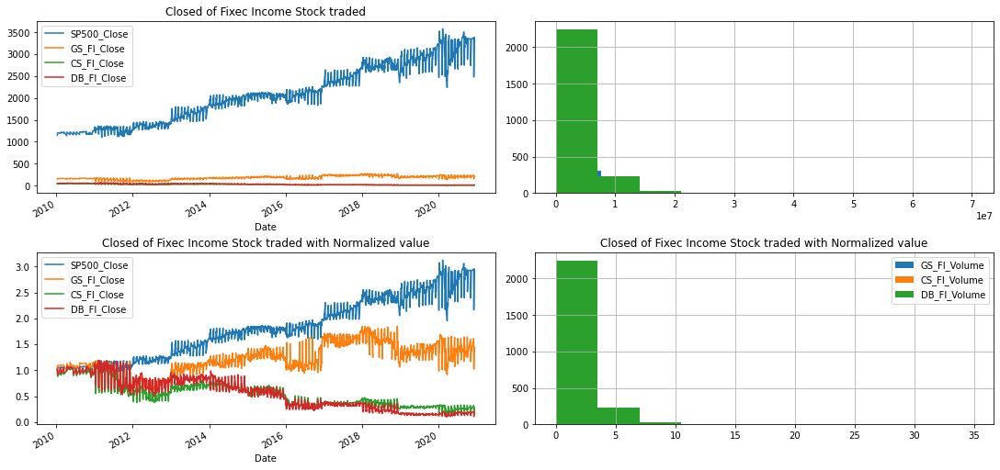

In [30]:
#Fixec Income Industry Stock Price without normalization
########################################################
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(15,10), constrained_layout=True)
data_1['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax=ax1)
data_1['GS_FI_Close'].plot(label = "GS_FI_Close", ax=ax1)
data_1['CS_FI_Close'].plot(label = 'CS_FI_Close', ax=ax1)
data_1['DB_FI_Close'].plot(label = 'DB_FI_Close', ax=ax1)
ax1.set_title('Closed of Fixec Income Stock traded')
ax1.legend()
plt.plot()

#Fixec Income Industry Volume without normalization
########################################################
#complete_data['SP500_Volume'].hist(label = 'SP500_Volume', figsize = (15,7), ax=ax2)
complete_data['GS_FI_Volume'].hist(label = "GS_FI_Volume", ax=ax2)
complete_data['CS_FI_Volume'].hist(label = 'CS_FI_Volume', ax=ax2)
complete_data['DB_FI_Volume'].hist(label = 'DB_FI_Volume', ax=ax2)
ax3.set_title('Closed of Fixec Income Stock traded without Normalized value')
ax3.legend()
plt.plot()


#Fixec Income Industry Stock Price with normalization
########################################################
# Plot the Close price
final_data_scaled['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax=ax3)
final_data_scaled['GS_FI_Close'].plot(label = "GS_FI_Close", ax=ax3)
final_data_scaled['CS_FI_Close'].plot(label = 'CS_FI_Close', ax=ax3)
final_data_scaled['DB_FI_Close'].plot(label = 'DB_FI_Close', ax=ax3)
ax3.set_title('Closed of Fixec Income Stock traded with Normalized value')
ax3.legend()
plt.plot()


#Fixec Income Industry Volume with normalization
########################################################
#complete_data['SP500_Volume'].hist(label = 'SP500_Volume', figsize = (15,7), ax=ax4)
complete_data_scaled['GS_FI_Volume'].hist(label = "GS_FI_Volume", ax=ax4)
complete_data_scaled['CS_FI_Volume'].hist(label = 'CS_FI_Volume', ax=ax4)
complete_data_scaled['DB_FI_Volume'].hist(label = 'DB_FI_Volume', ax=ax4)
ax4.set_title('Closed of Fixec Income Stock traded with Normalized value')
ax4.legend()
plt.plot()

- __Downtrend: : Fixed Income Companies are with down trend(CS & DB)__
- __No trend: : Fixed Income Company with no trend(GS)__
- __DB in Fixed Income have more volume of stock__

## 4 (I) d. Health and Pharma Industry Stock Price and Volume with & without normalization

[]

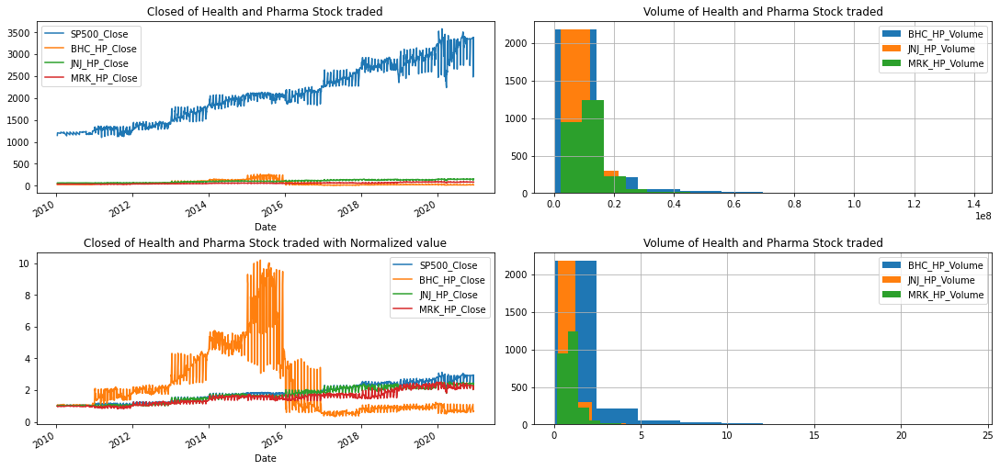

In [31]:
#Health and Pharma Industry Stock Price without normalization
########################################################
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(15,10), constrained_layout=True)
data_1['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax=ax1)
data_1['BHC_HP_Close'].plot(label = "BHC_HP_Close", ax=ax1)
data_1['JNJ_HP_Close'].plot(label = 'JNJ_HP_Close', ax=ax1)
data_1['MRK_HP_Close'].plot(label = 'MRK_HP_Close', ax=ax1)
ax1.set_title('Closed of Health and Pharma Stock traded')
ax1.legend()
plt.plot()

#Health and Pharma Industry Volume without normalization
########################################################
#complete_data['SP500_Volume'].plot(label = 'SP500_Volume', figsize = (15,7), ax=ax2)
complete_data['BHC_HP_Volume'].hist(label = "BHC_HP_Volume", ax=ax2)
complete_data['JNJ_HP_Volume'].hist(label = 'JNJ_HP_Volume', ax=ax2)
complete_data['MRK_HP_Volume'].hist(label = 'MRK_HP_Volume', ax=ax2)
ax2.set_title('Volume of Health and Pharma Stock traded')
ax2.legend()
plt.plot()

#Health and Pharma Industry Stock Price with normalization
########################################################
# Plot the Close price
final_data_scaled['SP500_Close'].plot(label = 'SP500_Close', figsize = (15,7), ax=ax3)
final_data_scaled['BHC_HP_Close'].plot(label = "BHC_HP_Close", ax=ax3)
final_data_scaled['JNJ_HP_Close'].plot(label = 'JNJ_HP_Close', ax=ax3)
final_data_scaled['MRK_HP_Close'].plot(label = 'MRK_HP_Close', ax=ax3)
ax3.set_title('Closed of Health and Pharma Stock traded with Normalized value')
ax3.legend()
plt.plot()

#Health and Pharma Industry Volume with normalization
########################################################
#complete_data['SP500_Volume'].plot(label = 'SP500_Volume', figsize = (15,7), ax=ax2)
complete_data_scaled['BHC_HP_Volume'].hist(label = "BHC_HP_Volume", ax=ax4)
complete_data_scaled['JNJ_HP_Volume'].hist(label = 'JNJ_HP_Volume', ax=ax4)
complete_data_scaled['MRK_HP_Volume'].hist(label = 'MRK_HP_Volume', ax=ax4)
ax4.set_title('Volume of Health and Pharma Stock traded')
ax4.legend()
plt.plot()


## Summary of stocks that are in:

#### 1> Uptrend: AAPL, AMZN, GOOG, JNJ, MRK & S&P500 - Positive Correlation

#### 2> No trend / sideways :  ALK, HA, AAL & GS - Neither Negative nor Positive

#### 3> Downtrend: CS, DB & BHC  - Negative correlation

#### Observation: Stocks in down trend are to be avoided. We will only focus on stocks that are in an Uptrend

In [32]:
print('SP500',SP500.head(5))
print('AAPL',AAPL.head(5))
print('AMZN',AMZN.head(5))
print('GOOG',GOOG.head(5))
print('ALK',ALK.head(5))
print('HA',HA.head(5))
print('AAL',AAL.head(5))
print('GS',GS.head(5))
print('CS',CS.head(5))
print('DB',DB.head(5))
print('BHC',BHC.head(5))
print('JNJ',JNJ.head(5))
print('MRK',MRK.head(5))

SP500              SP500_Open   SP500_High    SP500_Low  SP500_Close  \
Date                                                             
2010-01-10  1143.489990  1150.300049  1139.420044  1146.239990   
2010-04-10  1144.959961  1148.160034  1131.869995  1137.030029   
2010-05-10  1140.680054  1162.760010  1140.680054  1160.750000   
2010-06-10  1159.810059  1162.329956  1154.849976  1159.969971   
2010-07-10  1161.569946  1163.869995  1151.410034  1158.060059   

            SP500_Adj Close  SP500_Volume  
Date                                       
2010-01-10  1146.239990      4298910000    
2010-04-10  1137.030029      3604110000    
2010-05-10  1160.750000      4068840000    
2010-06-10  1159.969971      4073160000    
2010-07-10  1158.060059      3910550000    
AAPL             AAPL_TECH_Open  AAPL_TECH_High  AAPL_TECH_Low  AAPL_TECH_Close  \
Date                                                                         
2010-01-10  10.219643       10.235000       10.048214      10.

## 4 (II). Moving Averages
As we know the stock prices are highly volatile and prices change quickly with time. To observe any trend or pattern we can take the help of a 50-days and 200-days average

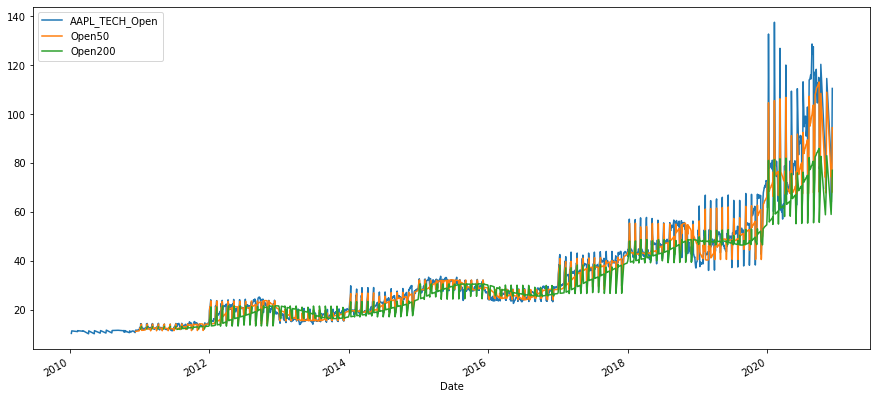

In [33]:
AAPL['Open50'] = AAPL['AAPL_TECH_Open'].rolling(50).mean()
AAPL['Open200'] = AAPL['AAPL_TECH_Open'].rolling(200).mean()
AAPL['AAPL_TECH_Open'].plot(figsize = (15,7),kind='line')
AAPL['Open50'].plot(kind='line')
AAPL['Open200'].plot(kind='line')
plt.legend()

In [34]:
# securities_name = [SP500, AAPL, AMZN, GOOG, ALK, HA, AAL, GS, CS, DB, BHC, JNJ, MRK]
# security_SP500 = ["SP500_Open", "SP500_Close", "SP500_High", "SP500_Low", "SP500_Adj Close", "SP500_Volume"]
# security_AAPL = ["AAPL_TECH_Open", "AAPL_TECH_Close", "AAPL_TECH_High", "AAPL_TECH_Low", "AAPL_TECH_Adj Close", "AAPL_TECH_Volume"]
# security_AMZN = ["AMZN_TECH_Open", "AMZN_TECH_Close", "AMZN_TECH_High", "AMZN_TECH_Low", "AMZN_TECH_Adj Close", "AMZN_TECH_Volume"]
# security_GOOG = ["GOOG_TECH_Open", "GOOG_TECH_Close", "GOOG_TECH_High", "GOOG_TECH_Low", "GOOG_TECH_Adj Close", "GOOG_TECH_Volume"]
# security_ALK = ["ALK_AV_Open", "ALK_AV_Close", "ALK_AV_High", "ALK_AV_Low", "ALK_AV_Adj Close", "ALK_AV_Volume"]
# security_HA = ["HA_AV_Open", "HA_AV_Close", "HA_AV_High", "HA_AV_Low", "HA_AV_Adj Close", "HA_AV_Volume"]
# security_AAL =  ["AAL_AV_Open", "AAL_AV_Close", "AAL_AV_High", "AAL_AV_Low", "AAL_AV_Adj Close", "AAL_AV_Volume"]
# security_GS = ["GS_FI_Open", "GS_FI_Close", "GS_FI_High", "GS_FI_Low", "GS_FI_Adj Close", "GS_FI_Volume"]
# security_CS =  ["CS_FI_Open", "CS_FI_Close", "CS_FI_High", "CS_FI_Low", "CS_FI_Adj Close", "CS_FI_Volume"]
# security_DB =  ["DB_FI_Open", "DB_FI_Close", "DB_FI_High", "DB_FI_Low", "DB_FI_Adj Close", "DB_FI_Volume"]
# security_BHC =  ["BHC_HP_Open", "BHC_HP_Close", "BHC_HP_High", "BHC_HP_Low", "BHC_HP_Adj Close", "BHC_HP_Volume"]
# security_JNJ = ["JNJ_HP_Open", "JNJ_HP_Close", "JNJ_HP_High", "JNJ_HP_Low", "JNJ_HP_Adj Close", "JNJ_HP_Volume"]
# security_MRK = ["MRK_HP_Open", "MRK_HP_Close", "MRK_HP_High", "MRK_HP_Low", "MRK_HP_Adj Close", "MRK_HP_Volume"]

__Creating a function to calculate the Moving average for 50 and 200 days.

In [35]:
def rolled(x, y, z):
    # Adjusting the size of matplotlib
    import matplotlib as mpl
    mpl.rc('figure', figsize=(8, 7))
    mpl.__version__

    # Adjusting the style of matplotlib
    style.use('ggplot')

    x[y+'50'] = x[y].rolling(50).mean()
    x[y+'200'] = x[y].rolling(200).mean()
    
    x[y].plot(figsize = (15,7), ax=z)
    x[y+'50'].plot(figsize = (15,7), ax=z)
    x[y+'200'].plot(figsize = (15,7), ax=z)
    z.set_title(y)
    z.legend(loc='best')
    #plt.legend()
    return

### 4 (II) a. Creating Moving Average based on Company and Index as Below

Rolling mean/Moving Average (MA) smooths out price data by creating a constantly updated average price. This is useful to cut down “noise” in our price chart. Furthermore, this Moving Average could act as “Resistance” meaning from the downtrend and uptrend of stocks you could expect it will follow the trend and less likely to deviate outside its resistance point.

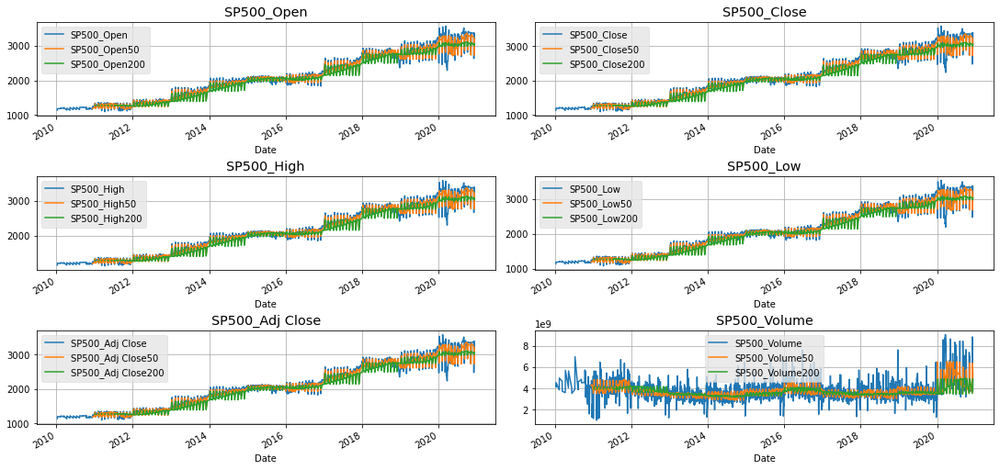

In [36]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(SP500, "SP500_Open", ax1)
rolled(SP500, "SP500_Close", ax2)
rolled(SP500, "SP500_High", ax3)
rolled(SP500, "SP500_Low", ax4)
rolled(SP500, "SP500_Adj Close", ax5)
rolled(SP500, "SP500_Volume", ax6)

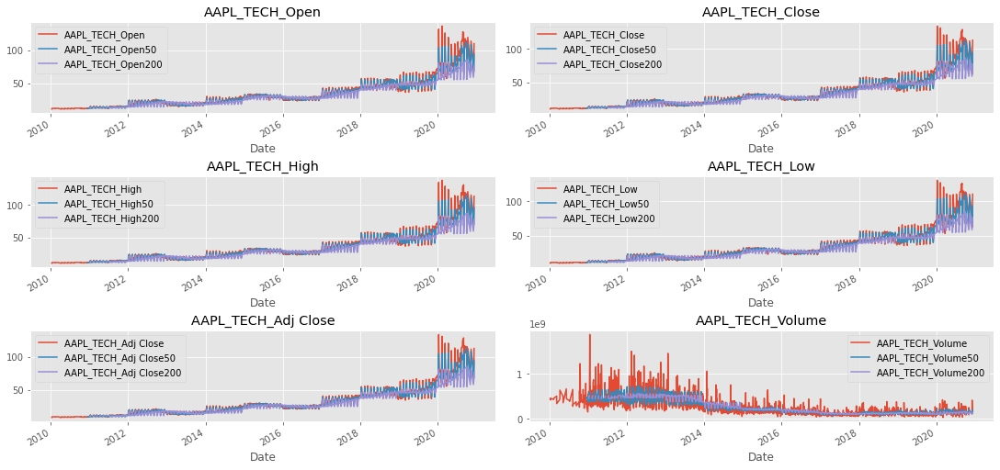

In [37]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(AAPL, "AAPL_TECH_Open", ax1)
rolled(AAPL, "AAPL_TECH_Close", ax2)
rolled(AAPL, "AAPL_TECH_High", ax3)
rolled(AAPL, "AAPL_TECH_Low", ax4)
rolled(AAPL, "AAPL_TECH_Adj Close", ax5)
rolled(AAPL, "AAPL_TECH_Volume", ax6)

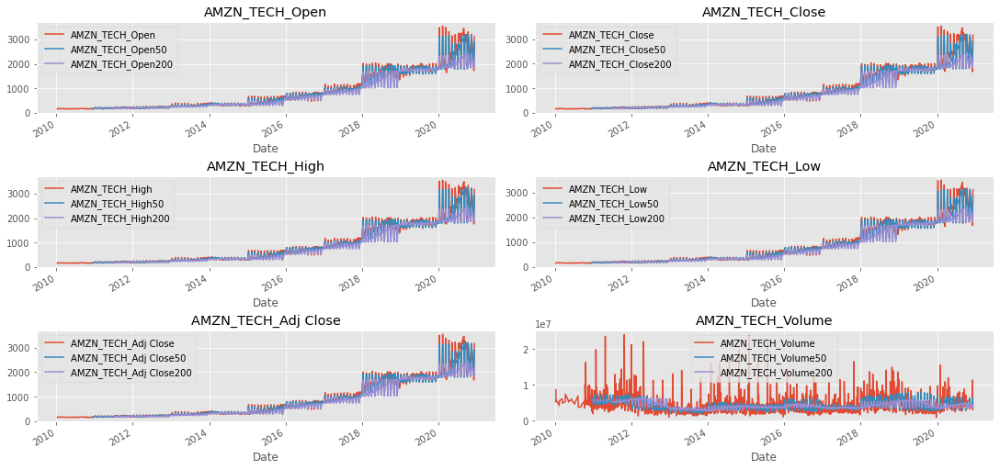

In [38]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(AMZN, "AMZN_TECH_Open", ax1)
rolled(AMZN, "AMZN_TECH_Close", ax2)
rolled(AMZN, "AMZN_TECH_High", ax3)
rolled(AMZN, "AMZN_TECH_Low", ax4)
rolled(AMZN, "AMZN_TECH_Adj Close", ax5)
rolled(AMZN, "AMZN_TECH_Volume", ax6)

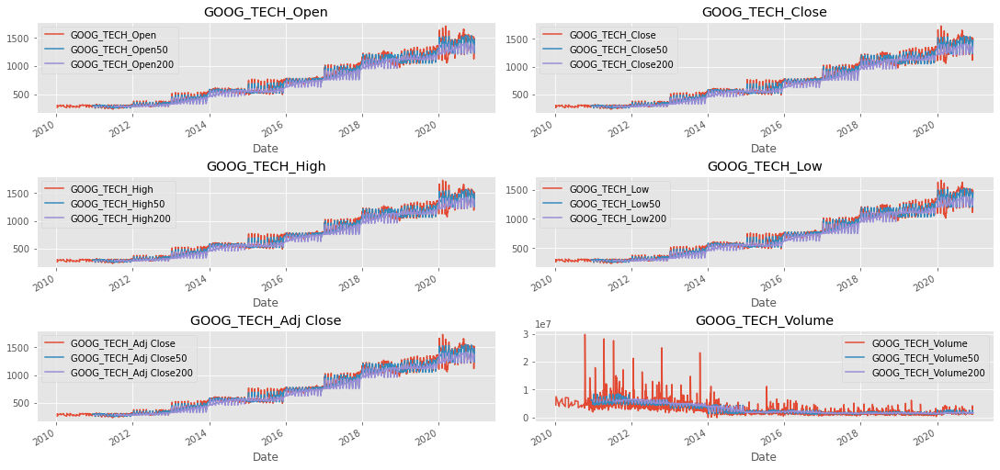

In [39]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(GOOG, "GOOG_TECH_Open", ax1)
rolled(GOOG, "GOOG_TECH_Close", ax2)
rolled(GOOG, "GOOG_TECH_High", ax3)
rolled(GOOG, "GOOG_TECH_Low", ax4)
rolled(GOOG, "GOOG_TECH_Adj Close", ax5)
rolled(GOOG, "GOOG_TECH_Volume", ax6)

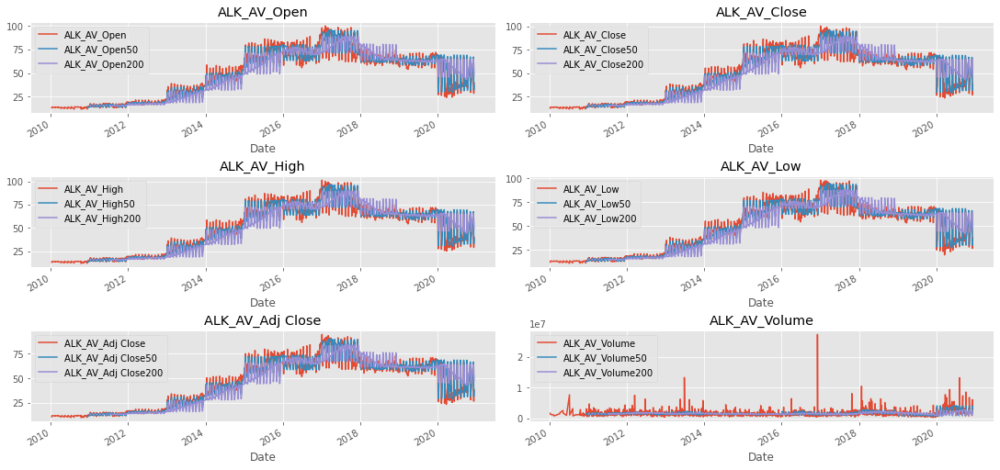

In [40]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(ALK, "ALK_AV_Open", ax1)
rolled(ALK, "ALK_AV_Close", ax2)
rolled(ALK, "ALK_AV_High", ax3)
rolled(ALK, "ALK_AV_Low", ax4)
rolled(ALK, "ALK_AV_Adj Close", ax5)
rolled(ALK, "ALK_AV_Volume", ax6)

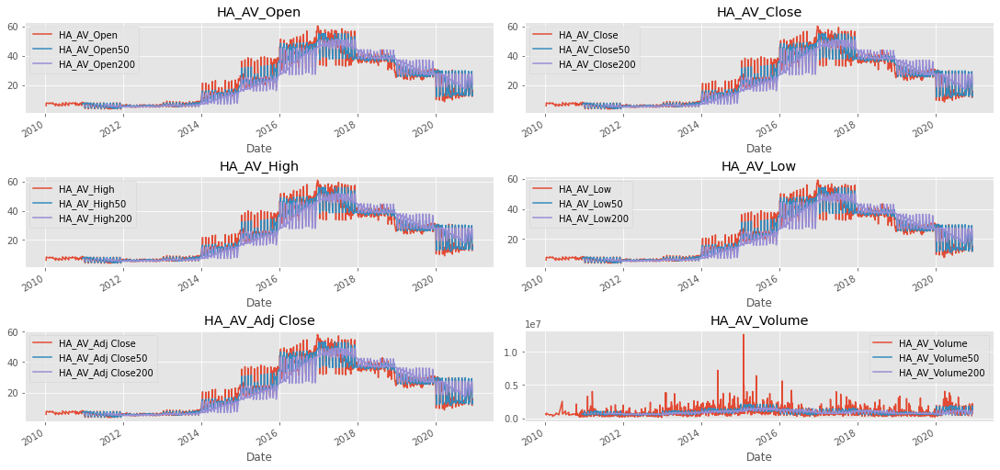

In [41]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(HA, "HA_AV_Open", ax1)
rolled(HA, "HA_AV_Close", ax2)
rolled(HA, "HA_AV_High", ax3)
rolled(HA, "HA_AV_Low", ax4)
rolled(HA, "HA_AV_Adj Close", ax5)
rolled(HA, "HA_AV_Volume", ax6)

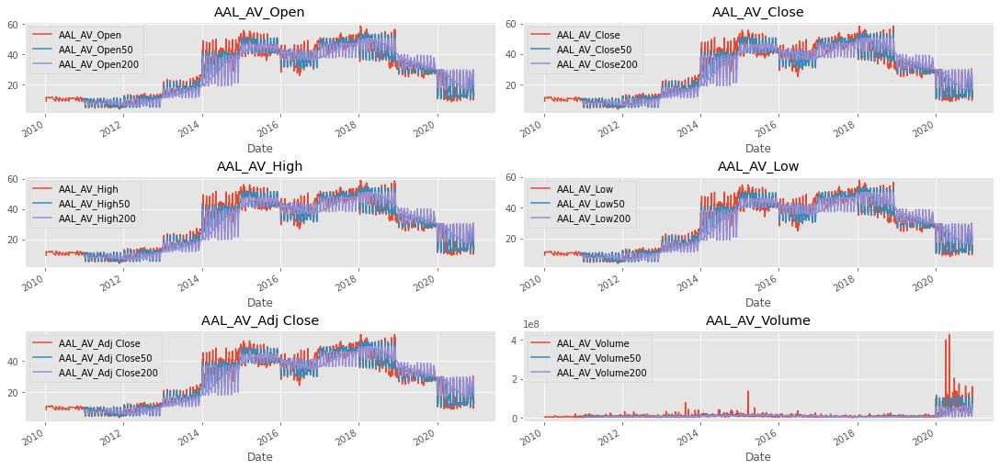

In [42]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(AAL, "AAL_AV_Open", ax1)
rolled(AAL, "AAL_AV_Close", ax2)
rolled(AAL, "AAL_AV_High", ax3)
rolled(AAL, "AAL_AV_Low", ax4)
rolled(AAL, "AAL_AV_Adj Close", ax5)
rolled(AAL, "AAL_AV_Volume", ax6)

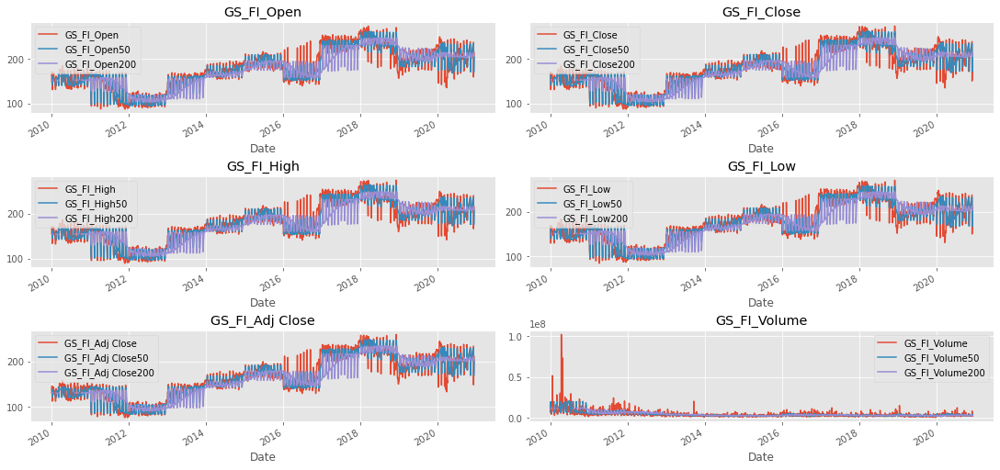

In [43]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(GS, "GS_FI_Open", ax1)
rolled(GS, "GS_FI_Close", ax2)
rolled(GS, "GS_FI_High", ax3)
rolled(GS, "GS_FI_Low", ax4)
rolled(GS, "GS_FI_Adj Close", ax5)
rolled(GS, "GS_FI_Volume", ax6)

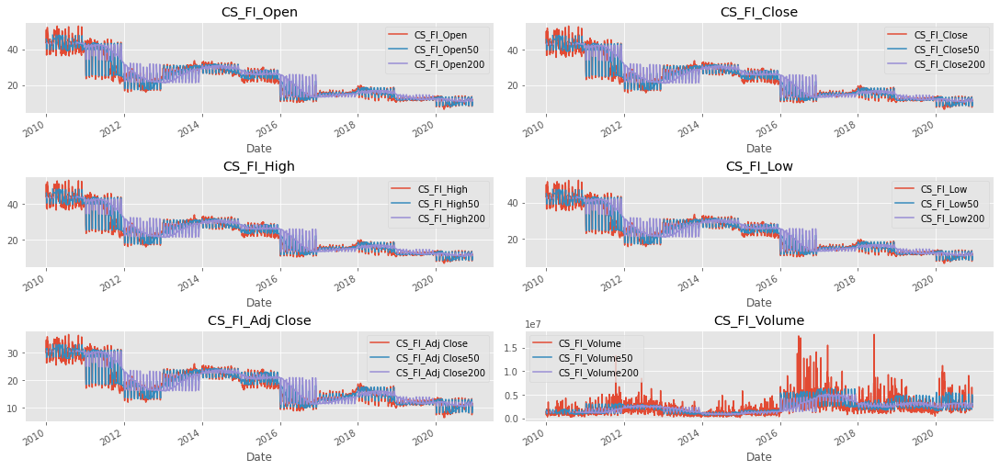

In [44]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(CS, "CS_FI_Open", ax1)
rolled(CS, "CS_FI_Close", ax2)
rolled(CS, "CS_FI_High", ax3)
rolled(CS, "CS_FI_Low", ax4)
rolled(CS, "CS_FI_Adj Close", ax5)
rolled(CS, "CS_FI_Volume", ax6)

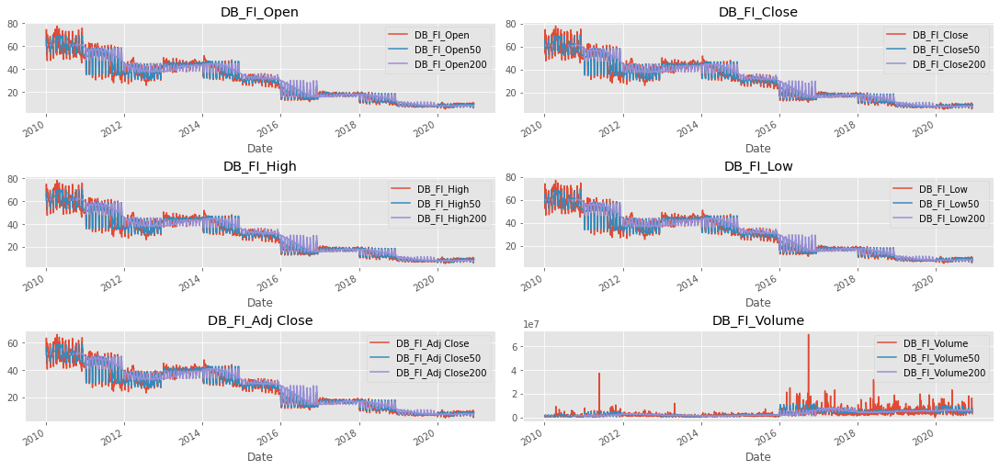

In [45]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(DB, "DB_FI_Open", ax1)
rolled(DB, "DB_FI_Close", ax2)
rolled(DB, "DB_FI_High", ax3)
rolled(DB, "DB_FI_Low", ax4)
rolled(DB, "DB_FI_Adj Close", ax5)
rolled(DB, "DB_FI_Volume", ax6)

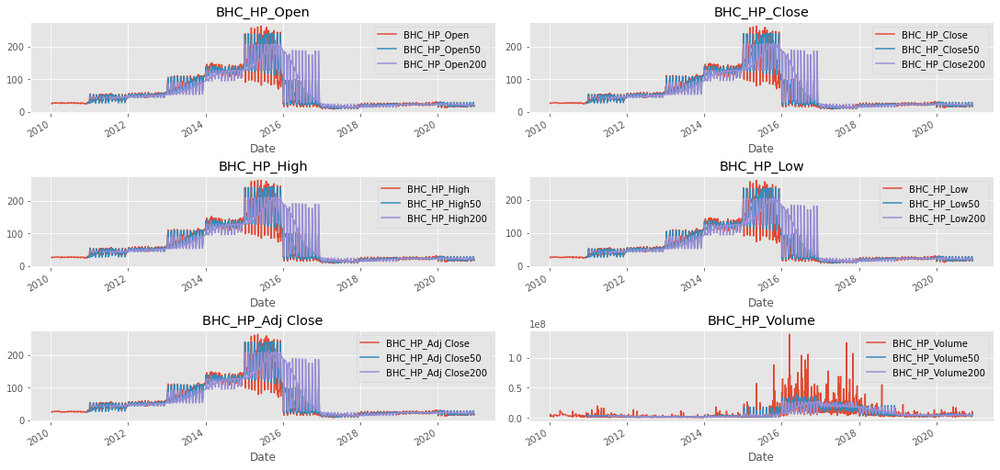

In [46]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(7,10), constrained_layout=True)
rolled(BHC, "BHC_HP_Open", ax1)
rolled(BHC, "BHC_HP_Close", ax2)
rolled(BHC, "BHC_HP_High", ax3)
rolled(BHC, "BHC_HP_Low", ax4)
rolled(BHC, "BHC_HP_Adj Close", ax5)
rolled(BHC, "BHC_HP_Volume", ax6)

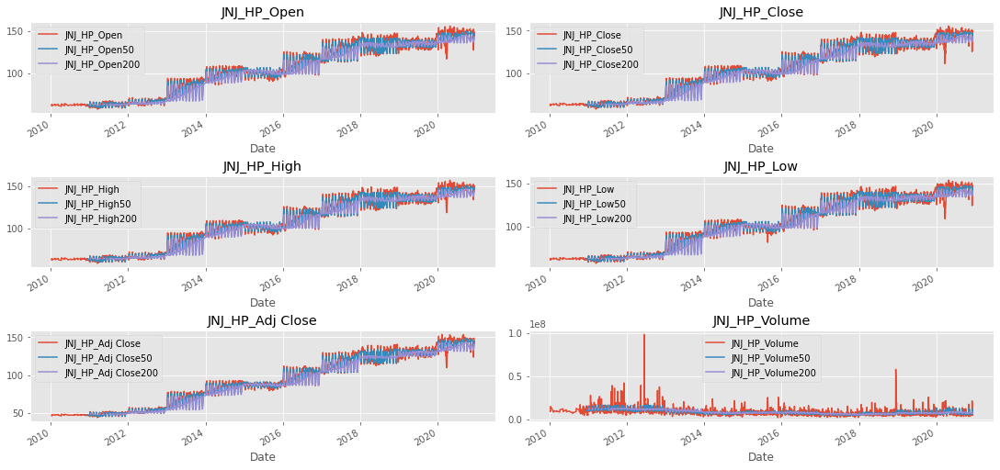

In [47]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(JNJ, "JNJ_HP_Open", ax1)
rolled(JNJ, "JNJ_HP_Close", ax2)
rolled(JNJ, "JNJ_HP_High", ax3)
rolled(JNJ, "JNJ_HP_Low", ax4)
rolled(JNJ, "JNJ_HP_Adj Close", ax5)
rolled(JNJ, "JNJ_HP_Volume", ax6)

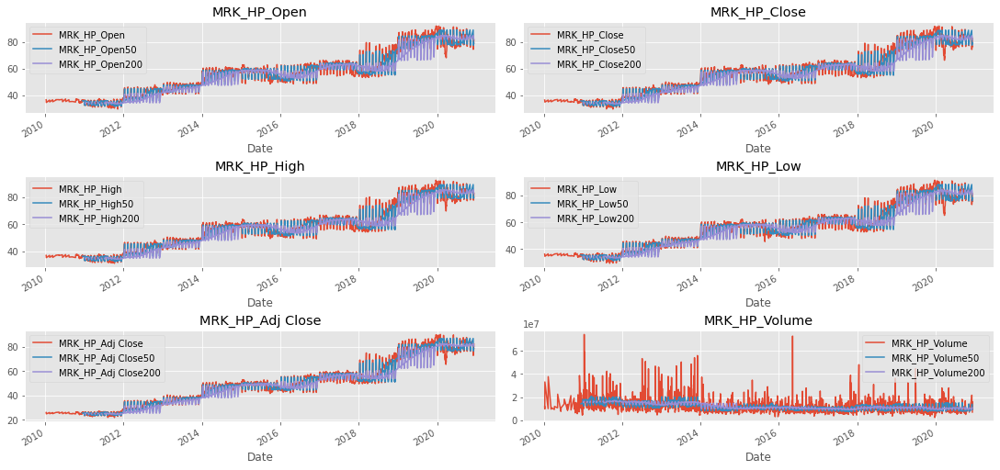

In [48]:
fig,((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(3,2,figsize=(15,10), constrained_layout=True)
rolled(MRK, "MRK_HP_Open", ax1)
rolled(MRK, "MRK_HP_Close", ax2)
rolled(MRK, "MRK_HP_High", ax3)
rolled(MRK, "MRK_HP_Low", ax4)
rolled(MRK, "MRK_HP_Adj Close", ax5)
rolled(MRK, "MRK_HP_Volume", ax6)

### 4 (II) b. Moving Average for Open stock with SP500

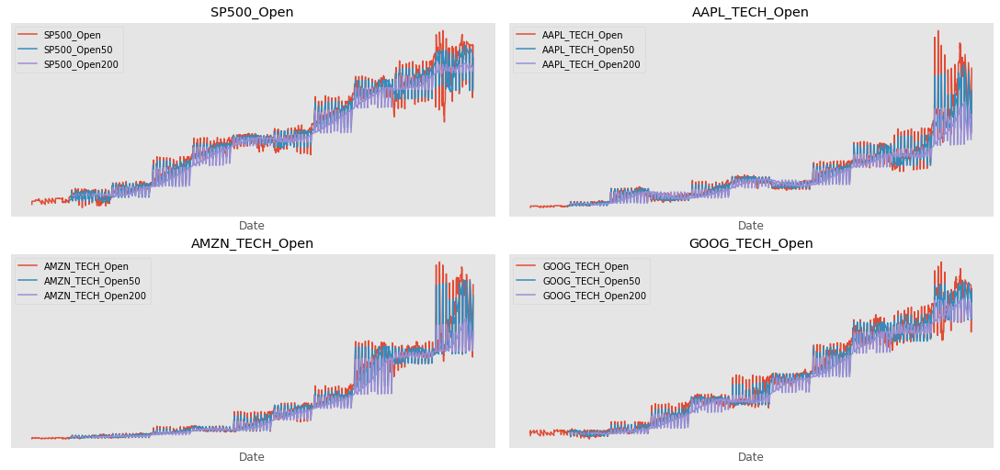

In [49]:
#### Moving Average for Technology with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Open", ax1)
rolled(AAPL, "AAPL_TECH_Open", ax2)
rolled(AMZN, "AMZN_TECH_Open", ax3)
rolled(GOOG, "GOOG_TECH_Open", ax4)

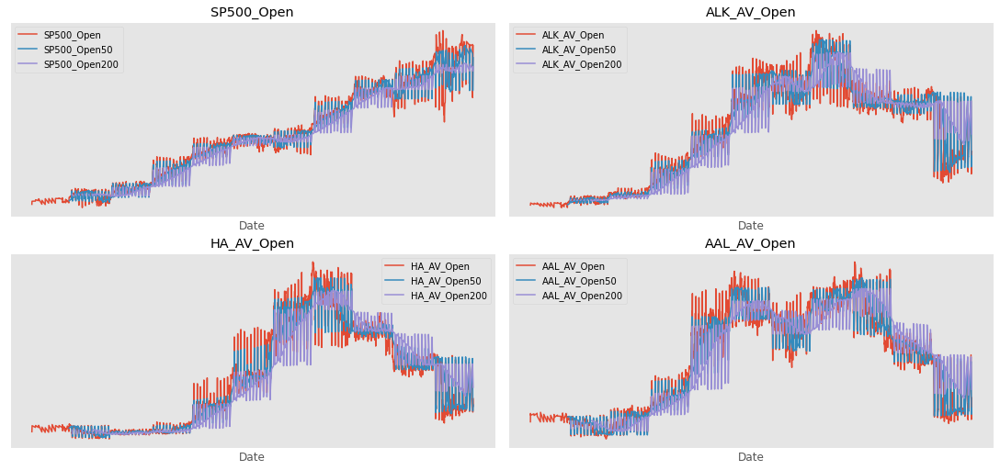

In [50]:
## Moving Average for Aviation with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Open", ax1)
rolled(ALK, "ALK_AV_Open", ax2)
rolled(HA, "HA_AV_Open", ax3)
rolled(AAL, "AAL_AV_Open", ax4)

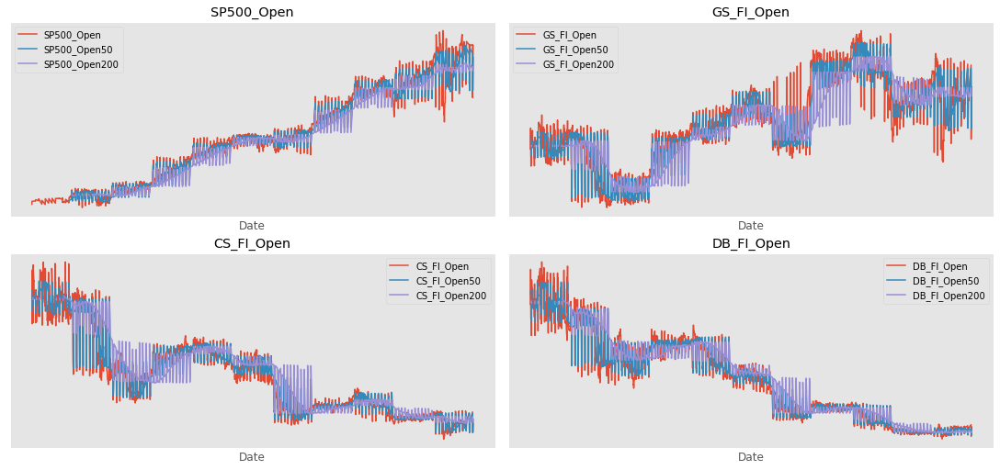

In [51]:
## Moving Average for Fixed Income with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Open", ax1)
rolled(GS, "GS_FI_Open", ax2)
rolled(CS, "CS_FI_Open", ax3)
rolled(DB, "DB_FI_Open", ax4)


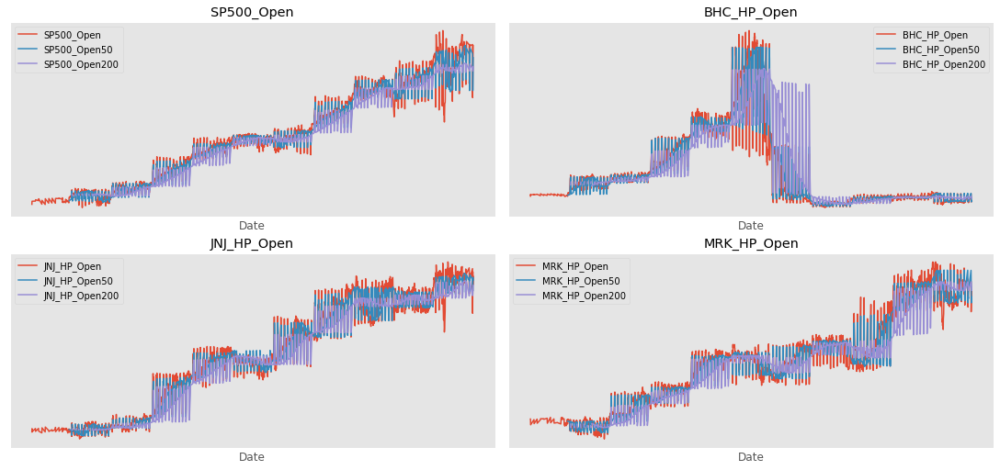

In [52]:
## Moving Average for Health and Pharma with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Open", ax1)
rolled(BHC, "BHC_HP_Open", ax2)
rolled(JNJ, "JNJ_HP_Open", ax3)
rolled(MRK, "MRK_HP_Open", ax4)

### 4 (II) c. Moving Average for Close stock with SP500

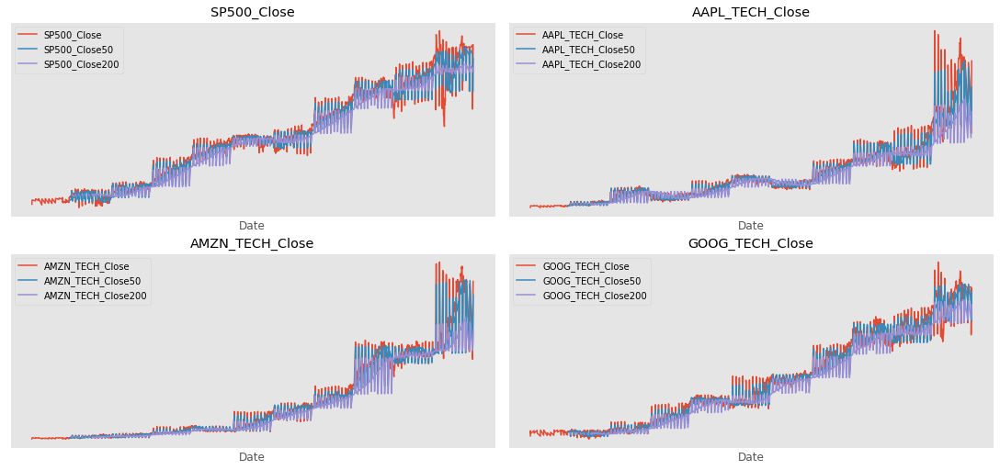

In [53]:
## Moving Average for Technology with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Close", ax1)
rolled(AAPL, "AAPL_TECH_Close", ax2)
rolled(AMZN, "AMZN_TECH_Close", ax3)
rolled(GOOG, "GOOG_TECH_Close", ax4)

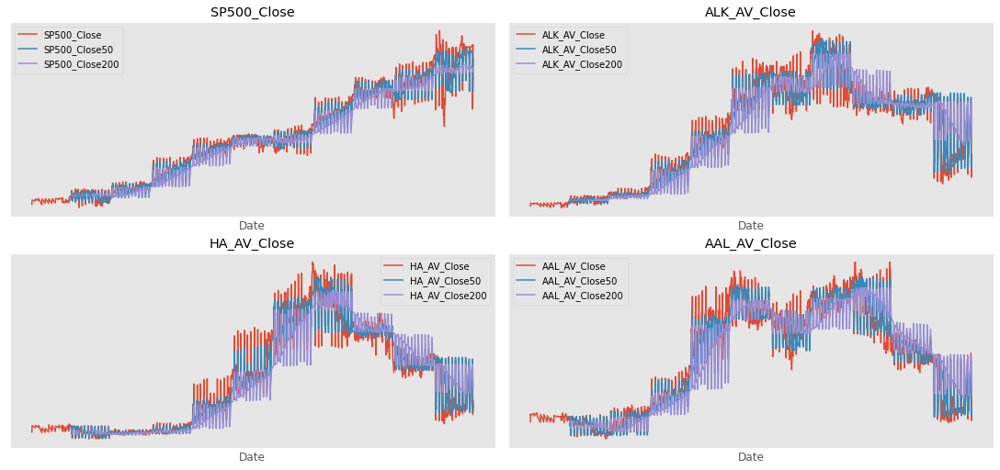

In [54]:
## Moving Average for Aviation with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Close", ax1)
rolled(ALK, "ALK_AV_Close", ax2)
rolled(HA, "HA_AV_Close", ax3)
rolled(AAL, "AAL_AV_Close", ax4)

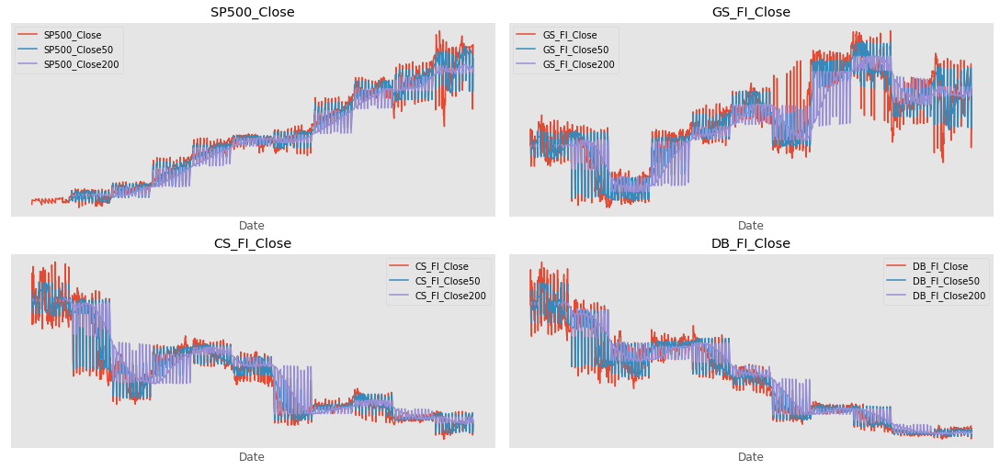

In [55]:
## Moving Average for Fixed Income with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Close", ax1)
rolled(GS, "GS_FI_Close", ax2)
rolled(CS, "CS_FI_Close", ax3)
rolled(DB, "DB_FI_Close", ax4)

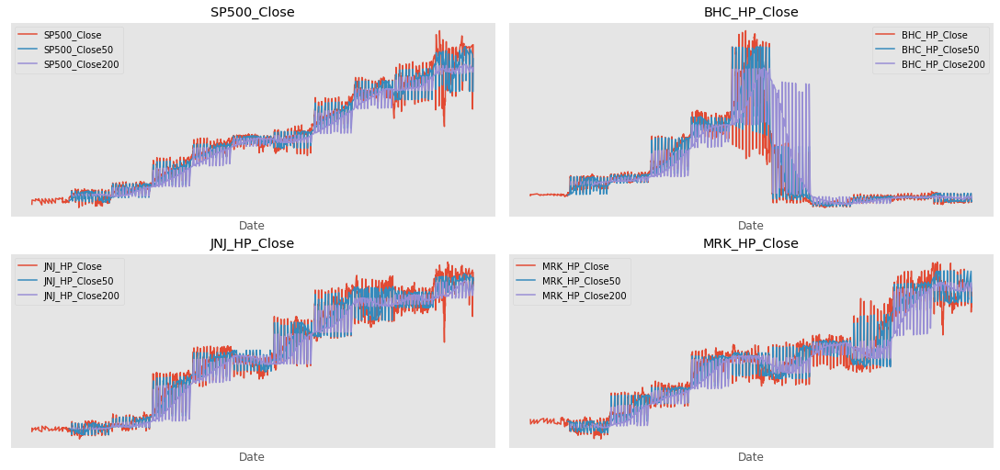

In [56]:
## Moving Average for Health and Pharma with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Close", ax1)
rolled(BHC, "BHC_HP_Close", ax2)
rolled(JNJ, "JNJ_HP_Close", ax3)
rolled(MRK, "MRK_HP_Close", ax4)

### 4 (II) d. Moving Average for High stock with SP500

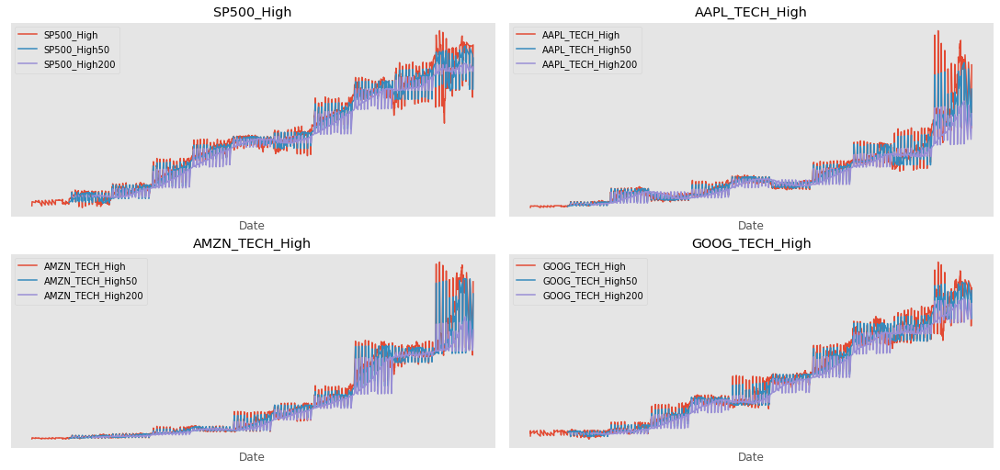

In [57]:
## Moving Average for Technology with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_High", ax1)
rolled(AAPL, "AAPL_TECH_High", ax2)
rolled(AMZN, "AMZN_TECH_High", ax3)
rolled(GOOG, "GOOG_TECH_High", ax4)

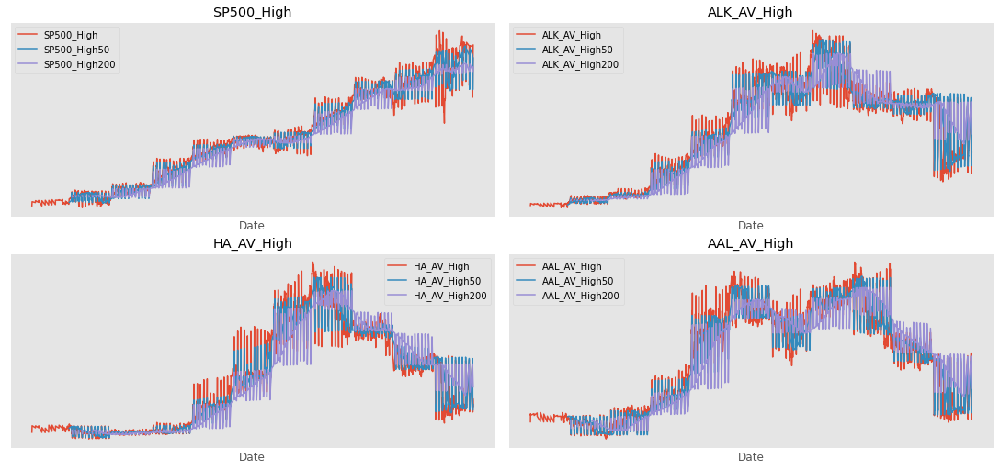

In [58]:
## Moving Average for Aviation with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_High", ax1)
rolled(ALK, "ALK_AV_High", ax2)
rolled(HA, "HA_AV_High", ax3)
rolled(AAL, "AAL_AV_High", ax4)

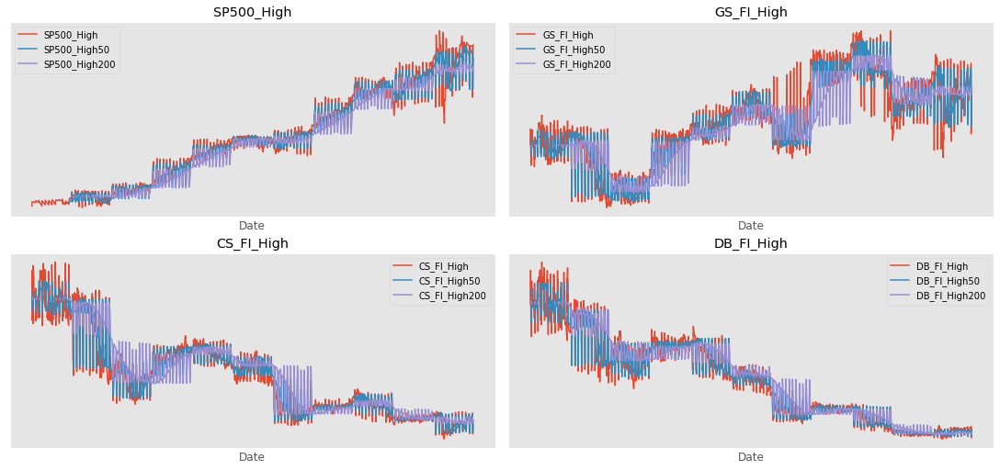

In [59]:
## Moving Average for Fixed Income with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_High", ax1)
rolled(GS, "GS_FI_High", ax2)
rolled(CS, "CS_FI_High", ax3)
rolled(DB, "DB_FI_High", ax4)

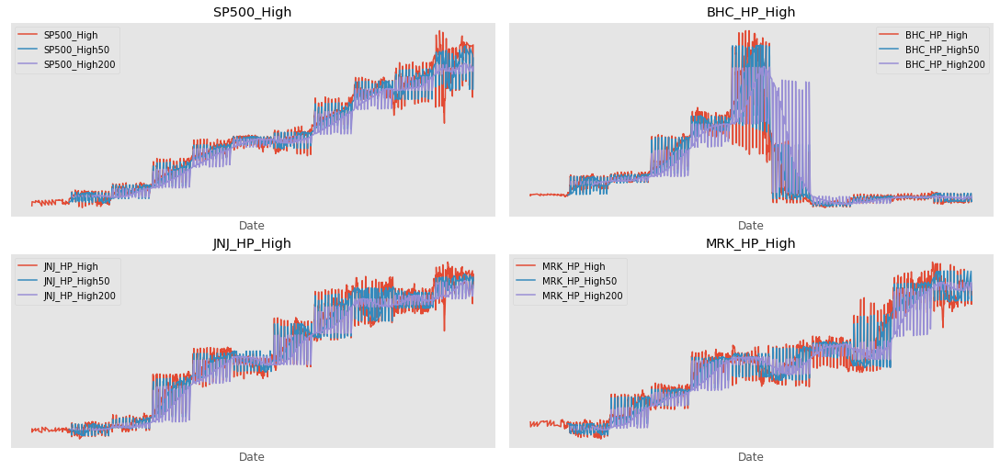

In [60]:
## Moving Average for Health and Pharma with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_High", ax1)
rolled(BHC, "BHC_HP_High", ax2)
rolled(JNJ, "JNJ_HP_High", ax3)
rolled(MRK, "MRK_HP_High", ax4)

### 4 (II) e. Moving Average for Low stock with SP500

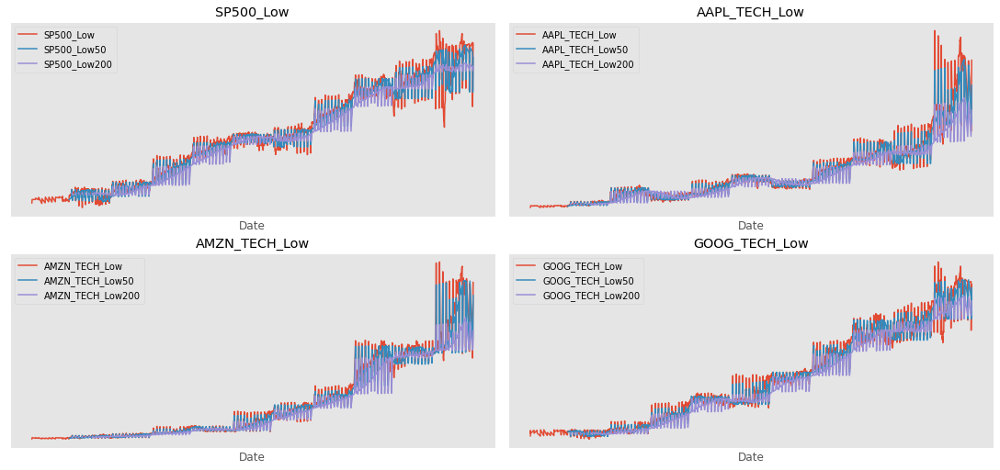

In [61]:
## Moving Average for Technology with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Low", ax1)
rolled(AAPL, "AAPL_TECH_Low", ax2)
rolled(AMZN, "AMZN_TECH_Low", ax3)
rolled(GOOG, "GOOG_TECH_Low", ax4)

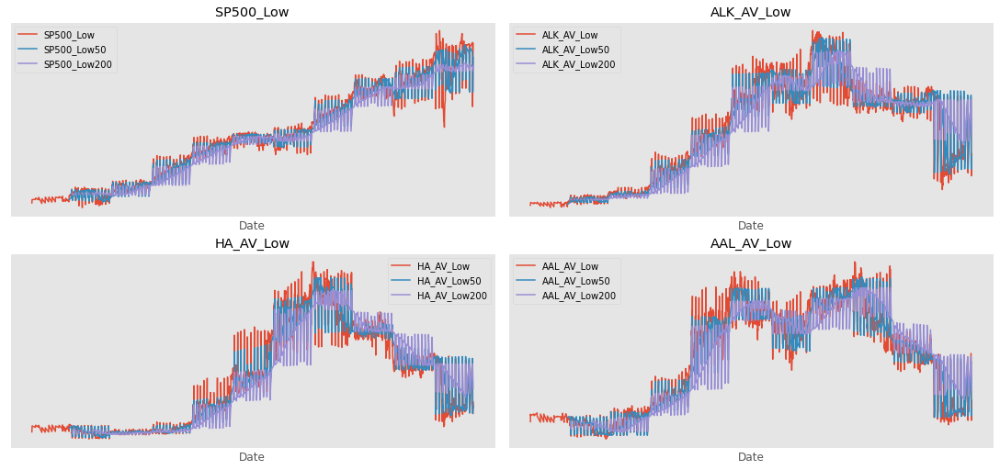

In [62]:
## Moving Average for Aviation with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Low", ax1)
rolled(ALK, "ALK_AV_Low", ax2)
rolled(HA, "HA_AV_Low", ax3)
rolled(AAL, "AAL_AV_Low", ax4)

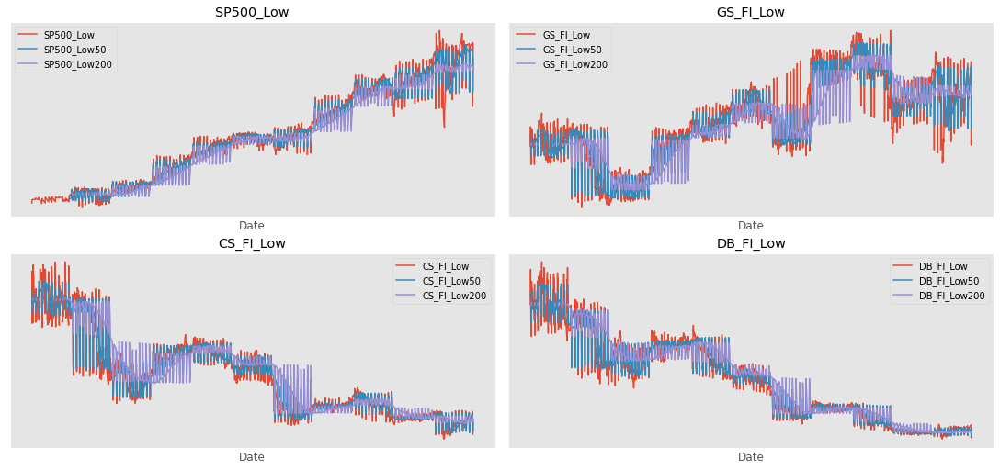

In [63]:
## Moving Average for Fixed Income with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Low", ax1)
rolled(GS, "GS_FI_Low", ax2)
rolled(CS, "CS_FI_Low", ax3)
rolled(DB, "DB_FI_Low", ax4)

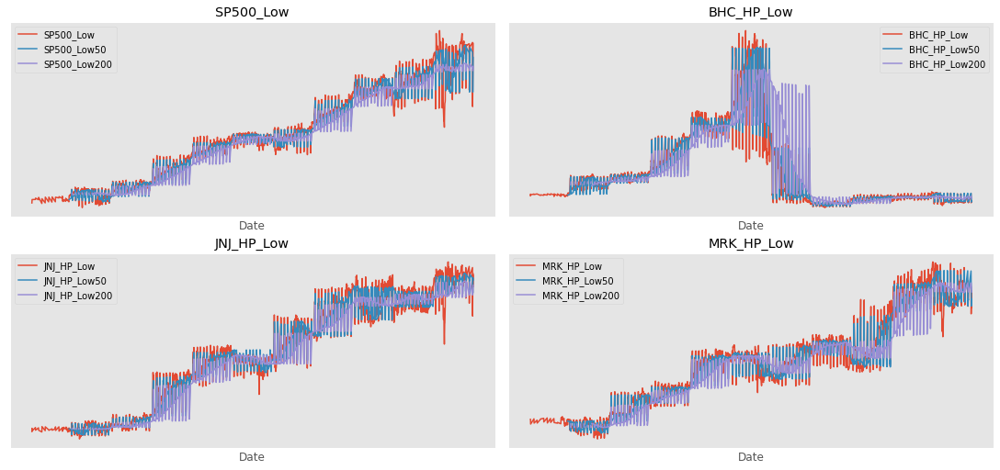

In [64]:
## Moving Average for Health and Pharma with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Low", ax1)
rolled(BHC, "BHC_HP_Low", ax2)
rolled(JNJ, "JNJ_HP_Low", ax3)
rolled(MRK, "MRK_HP_Low", ax4)

### 4 (II) f. Moving Average for Adj Close stock with SP500

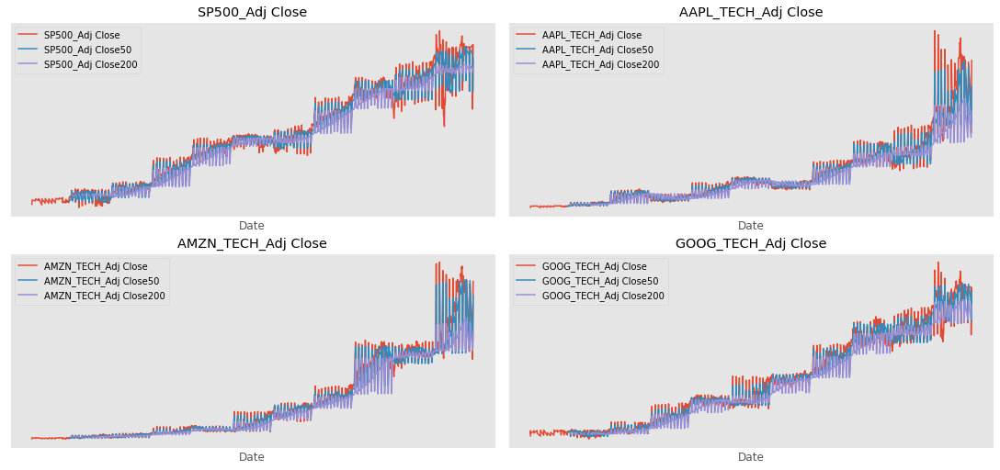

In [65]:
## Moving Average for Technology with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Adj Close", ax1)
rolled(AAPL, "AAPL_TECH_Adj Close", ax2)
rolled(AMZN, "AMZN_TECH_Adj Close", ax3)
rolled(GOOG, "GOOG_TECH_Adj Close", ax4)

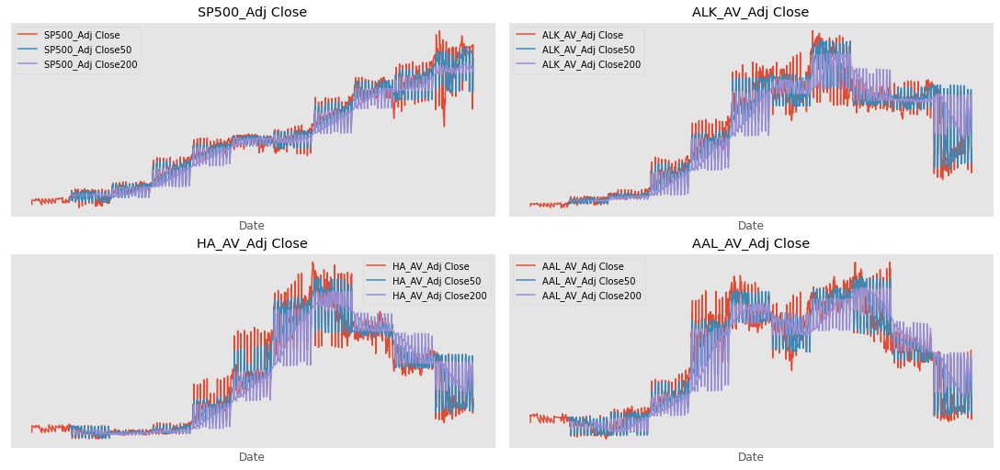

In [66]:
## Moving Average for Aviation with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Adj Close", ax1)
rolled(ALK, "ALK_AV_Adj Close", ax2)
rolled(HA, "HA_AV_Adj Close", ax3)
rolled(AAL, "AAL_AV_Adj Close", ax4)

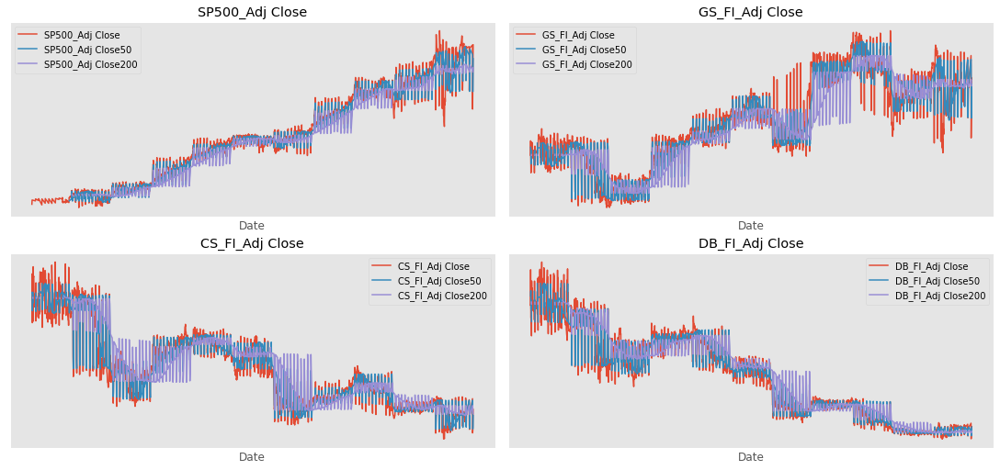

In [67]:
## Moving Average for Fixed Income with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Adj Close", ax1)
rolled(GS, "GS_FI_Adj Close", ax2)
rolled(CS, "CS_FI_Adj Close", ax3)
rolled(DB, "DB_FI_Adj Close", ax4)

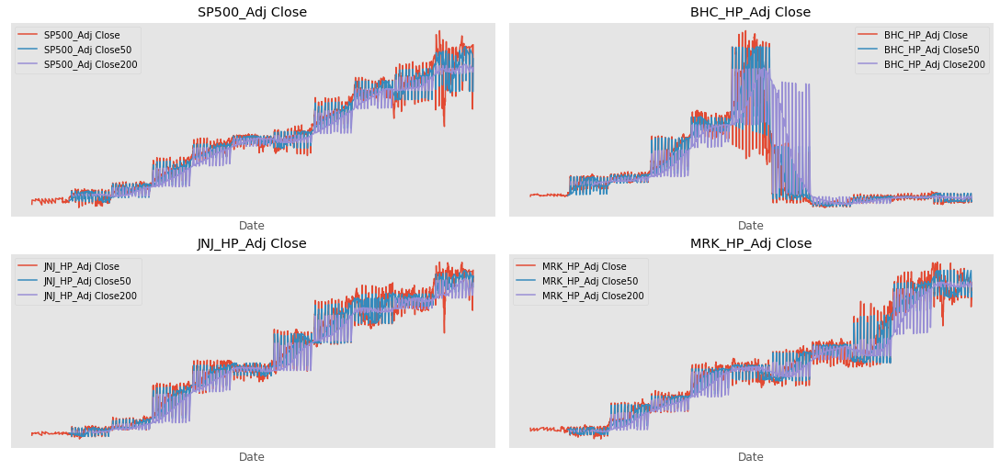

In [68]:
## Moving Average for Health and Pharma with SP500
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,3), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
rolled(SP500, "SP500_Adj Close", ax1)
rolled(BHC, "BHC_HP_Adj Close", ax2)
rolled(JNJ, "JNJ_HP_Adj Close", ax3)
rolled(MRK, "MRK_HP_Adj Close", ax4)

In [69]:
short_rolling = complete_data_scaled.rolling(window=20).mean()
short_rolling.head(20)

,SP500_Open,SP500_High,SP500_Low,SP500_Close,SP500_Adj Close,SP500_Volume,AAPL_TECH_Open,AAPL_TECH_High,AAPL_TECH_Low,AAPL_TECH_Close,AAPL_TECH_Adj Close,AAPL_TECH_Volume,AMZN_TECH_Open,AMZN_TECH_High,AMZN_TECH_Low,AMZN_TECH_Close,AMZN_TECH_Adj Close,AMZN_TECH_Volume,GOOG_TECH_Open,GOOG_TECH_High,GOOG_TECH_Low,GOOG_TECH_Close,GOOG_TECH_Adj Close,GOOG_TECH_Volume,ALK_AV_Open,ALK_AV_High,ALK_AV_Low,ALK_AV_Close,ALK_AV_Adj Close,ALK_AV_Volume,HA_AV_Open,HA_AV_High,HA_AV_Low,HA_AV_Close,HA_AV_Adj Close,HA_AV_Volume,AAL_AV_Open,AAL_AV_High,AAL_AV_Low,AAL_AV_Close,AAL_AV_Adj Close,AAL_AV_Volume,GS_FI_Open,GS_FI_High,GS_FI_Low,GS_FI_Close,GS_FI_Adj Close,GS_FI_Volume,CS_FI_Open,CS_FI_High,CS_FI_Low,CS_FI_Close,CS_FI_Adj Close,CS_FI_Volume,DB_FI_Open,DB_FI_High,DB_FI_Low,DB_FI_Close,DB_FI_Adj Close,DB_FI_Volume,BHC_HP_Open,BHC_HP_High,BHC_HP_Low,BHC_HP_Close,BHC_HP_Adj Close,BHC_HP_Volume,JNJ_HP_Open,JNJ_HP_High,JNJ_HP_Low,JNJ_HP_Close,JNJ_HP_Adj Close,JNJ_HP_Volume,MRK_HP_Open,MRK_HP_High,MRK_HP_Low,MRK_HP_Close,MRK_HP_Adj Close,MRK_HP_Volume
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-04-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-05-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-07-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-08-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-11-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-12-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-10-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [70]:
long_rolling = data_1.rolling(window=100).mean()
long_rolling.tail()
my_year_month_fmt = mdates.DateFormatter('%d/%m/%y')

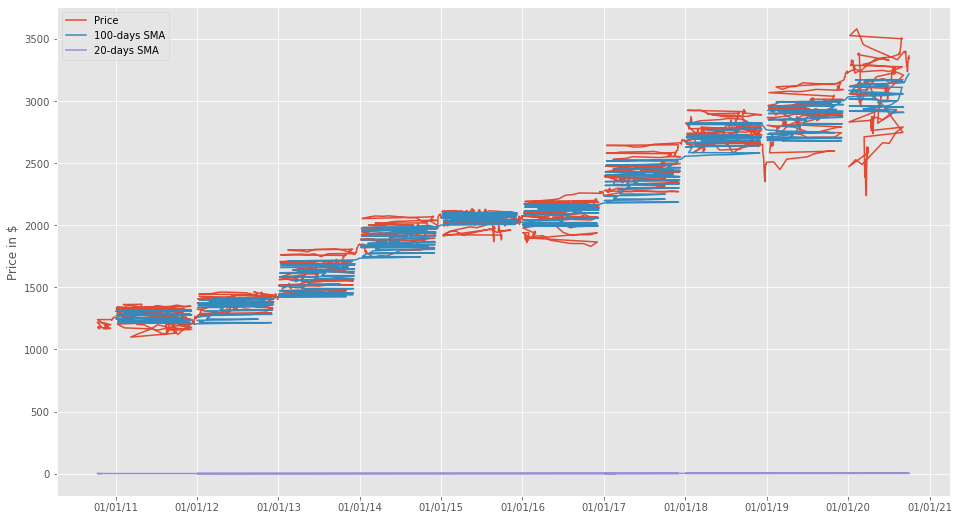

In [71]:
start_date = '10/2010'
end_date = '09/2020'


fig, ax = plt.subplots(figsize=(16,9))

ax.plot(data_1.loc[start_date:end_date, :].index, data_1.loc[start_date:end_date, 'SP500_Close'], label='Price')
ax.plot(long_rolling.loc[start_date:end_date, :].index, long_rolling.loc[start_date:end_date, 'SP500_Close'], label = '100-days SMA')
ax.plot(short_rolling.loc[start_date:end_date, :].index, short_rolling.loc[start_date:end_date, 'SP500_Close'], label = '20-days SMA')

ax.legend(loc='best')
ax.set_ylabel('Price in $')
ax.xaxis.set_major_formatter(my_year_month_fmt)

## 4 (III) Return Deviation — to determine risk and return

Expected Return measures the mean, or expected value, of the probability distribution of investment returns. The expected return of a portfolio is calculated by multiplying the weight of each asset by its expected return and adding the values for each investment — Investopedia.
Following is the formula you could refer to:

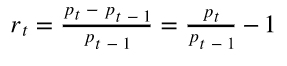
Formula for Returns


In [72]:
df = data_1.copy()
df[['m_returns']] = SP500[['SP500_Adj Close']]

In [73]:
px.line(df/df.iloc[0])

In [74]:
df_ret = df/df.shift(1)-1

In [75]:
df_ret.head(5)

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close,m_returns
Date,,,,,,,,,,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-04-10,-0.008035,-0.013734,0.010930,-0.006221,-0.024503,-0.035235,-0.018299,-0.007651,-0.007401,-0.015965,0.004660,-0.001296,-0.002186,-0.008035
2010-05-10,0.020861,0.036965,0.035266,0.030401,0.005971,0.017391,0.012061,0.020468,0.029590,0.042404,0.016621,0.018323,0.013691,0.020861
2010-06-10,-0.000672,0.000865,-0.034003,-0.007209,-0.002251,0.020513,0.000000,0.008491,0.006563,0.012204,0.014829,0.006529,-0.000270,-0.000672
2010-07-10,-0.001647,0.000104,0.005599,-0.008122,-0.046154,0.030151,0.001083,0.001790,0.005396,-0.010484,-0.003372,0.000158,-0.008106,-0.001647


In [76]:
df_ret.columns

Index(['SP500_Close', 'AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close',
       'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close',
       'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close',
       'MRK_HP_Close', 'm_returns'],
      dtype='object')

In [77]:
px.box(df_ret[['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close']])

In [78]:
px.box(df_ret[['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close']])

In [79]:
px.box(df_ret[['ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close']])

In [80]:
px.box(df_ret[['GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close']])

In [81]:
px.box(df_ret[['BHC_HP_Close', 'JNJ_HP_Close','MRK_HP_Close']])

In [82]:
px.violin(df_ret)

Logically, our ideal stocks should return as high and stable as possible. If you are risk averse, avoid those stocks as you saw around the 10% drop. Hence we dropping following securities AAPL, CS & DB 

## 4 (III) b. Daily return - Industry wise

AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)


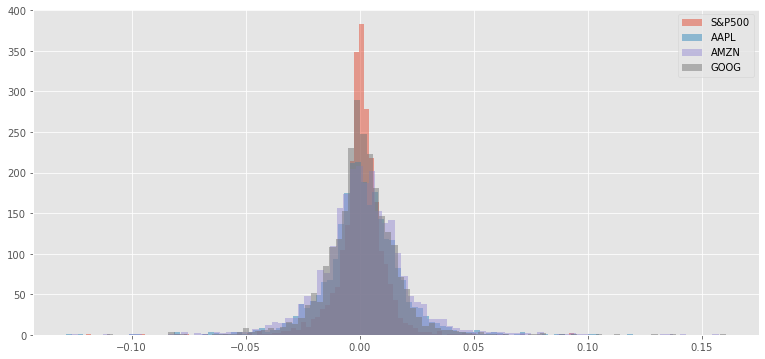

count    2516.000000
mean     0.000488   
std      0.010934   
min     -0.119841   
25%     -0.003308   
50%      0.000653   
75%      0.005229   
max      0.093828   
Name: SP500_Close, dtype: float64
count    2516.000000
mean     0.001128   
std      0.017719   
min     -0.128647   
25%     -0.006971   
50%      0.000891   
75%      0.010209   
max      0.119808   
Name: AAPL_TECH_Close, dtype: float64
count    2516.000000
mean     0.001398   
std      0.019889   
min     -0.126568   
25%     -0.008133   
50%      0.001107   
75%      0.011457   
max      0.157457   
Name: AMZN_TECH_Close, dtype: float64
count    2516.000000
mean     0.000818   
std      0.016288   
min     -0.111008   
25%     -0.006431   
50%      0.000659   
75%      0.008646   
max      0.160524   
Name: GOOG_TECH_Close, dtype: float64


In [83]:
# calculate Daily Returns based on industry with S&P500
final_data_sp500_return = data_1['SP500_Close'].pct_change()
final_data_aapl_tech_return = data_1['AAPL_TECH_Close'].pct_change() 
final_data_amzn_tech_return = data_1['AMZN_TECH_Close'].pct_change() 
final_data_goog_tech_return = data_1['GOOG_TECH_Close'].pct_change() 

# plot the Daily Returns
print(final_data_sp500_return.hist(bins=100, label='S&P500', alpha=0.5, figsize = (13,6)))
print(final_data_aapl_tech_return.hist(bins=100, label='AAPL', alpha=0.5, figsize = (13,6)))
print(final_data_amzn_tech_return.hist(bins=100, label='AMZN', alpha=0.5, figsize = (13,6)))
print(final_data_goog_tech_return.hist(bins=100, label='GOOG', alpha=0.5, figsize = (13,6)))
plt.legend(loc='best')
plt.show()


# summarize the daily returns
print(final_data_sp500_return.describe())
print(final_data_aapl_tech_return.describe())
print(final_data_amzn_tech_return.describe())
print(final_data_goog_tech_return.describe())

AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)


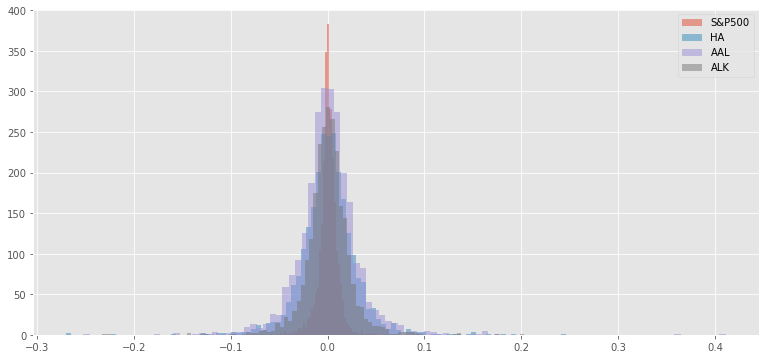

count    2516.000000
mean     0.000488   
std      0.010934   
min     -0.119841   
25%     -0.003308   
50%      0.000653   
75%      0.005229   
max      0.093828   
Name: SP500_Close, dtype: float64
count    2516.000000
mean     0.000765   
std      0.030147   
min     -0.269722   
25%     -0.013826   
50%      0.000451   
75%      0.015317   
max      0.245837   
Name: HA_AV_Close, dtype: float64
count    2516.000000
mean     0.000637   
std      0.032726   
min     -0.252246   
25%     -0.014116   
50%      0.000216   
75%      0.015593   
max      0.410970   
Name: AAL_AV_Close, dtype: float64
count    2516.000000
mean     0.000709   
std      0.023562   
min     -0.232385   
25%     -0.010126   
50%      0.000788   
75%      0.011655   
max      0.203079   
Name: ALK_AV_Close, dtype: float64


In [84]:
# calculate Daily Returns based on industry with S&P500
final_data_sp500_return = data_1['SP500_Close'].pct_change()
final_data_ha_av_return = data_1['HA_AV_Close'].pct_change() 
final_data_aal_av_return = data_1['AAL_AV_Close'].pct_change() 
final_data_alk_av_return = data_1['ALK_AV_Close'].pct_change() 

# data1_av_return = data_1['SP500_Close', 'HA_AV_Close', 'AAL_AV_Close', 'ALK_AV_Close'].pct_change()
# data1_fi_return = data_1['SP500_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close'].pct_change()
# data1_hp_return = data_1['SP500_Close', 'BHC_HP_Close', 'BHC_HP_Close', 'MRK_HP_Close'].pct_change()


# plot the Daily Returns
print(final_data_sp500_return.hist(bins=100, label='S&P500', alpha=0.5, figsize = (13,6)))
print(final_data_ha_av_return.hist(bins=100, label='HA', alpha=0.5, figsize = (13,6)))
print(final_data_aal_av_return.hist(bins=100, label='AAL', alpha=0.5, figsize = (13,6)))
print(final_data_alk_av_return.hist(bins=100, label='ALK', alpha=0.5, figsize = (13,6)))
plt.legend(loc='best')
plt.show()


# summarize the daily returns
print(final_data_sp500_return.describe())
print(final_data_ha_av_return.describe())
print(final_data_aal_av_return.describe())
print(final_data_alk_av_return.describe())

AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)


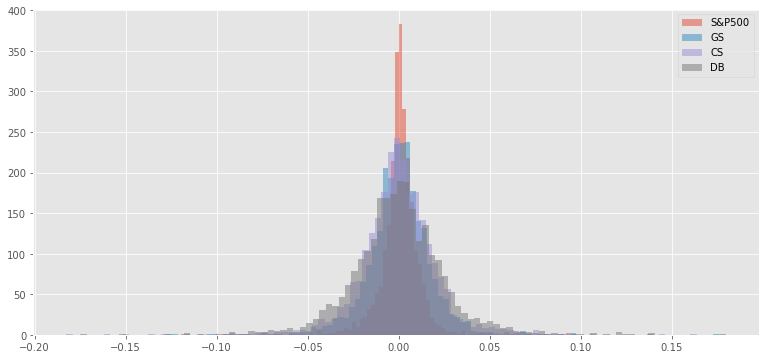

count    2516.000000
mean     0.000488   
std      0.010934   
min     -0.119841   
25%     -0.003308   
50%      0.000653   
75%      0.005229   
max      0.093828   
Name: SP500_Close, dtype: float64
count    2516.000000
mean     0.000291   
std      0.018331   
min     -0.127053   
25%     -0.008367   
50%      0.000490   
75%      0.009413   
max      0.175803   
Name: GS_FI_Close, dtype: float64
count    2516.000000
mean    -0.000325   
std      0.022206   
min     -0.182598   
25%     -0.010897   
50%      0.000000   
75%      0.010796   
max      0.163447   
Name: CS_FI_Close, dtype: float64
count    2516.000000
mean    -0.000381   
std      0.026374   
min     -0.174888   
25%     -0.013920   
50%     -0.000495   
75%      0.013712   
max      0.179506   
Name: DB_FI_Close, dtype: float64


In [85]:
# calculate Daily Returns based on industry with S&P500
final_data_sp500_return = data_1['SP500_Close'].pct_change()
final_data_gs_fi_return = data_1['GS_FI_Close'].pct_change() 
final_data_cs_fi_return = data_1['CS_FI_Close'].pct_change() 
final_data_db_fi_return = data_1['DB_FI_Close'].pct_change() 

# plot the Daily Returns
print(final_data_sp500_return.hist(bins=100, label='S&P500', alpha=0.5, figsize = (13,6)))
print(final_data_gs_fi_return.hist(bins=100, label='GS', alpha=0.5, figsize = (13,6)))
print(final_data_cs_fi_return.hist(bins=100, label='CS', alpha=0.5, figsize = (13,6)))
print(final_data_db_fi_return.hist(bins=100, label='DB', alpha=0.5, figsize = (13,6)))
plt.legend(loc='best')
plt.show()


# summarize the daily returns
print(final_data_sp500_return.describe())
print(final_data_gs_fi_return.describe())
print(final_data_cs_fi_return.describe())
print(final_data_db_fi_return.describe())

AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)


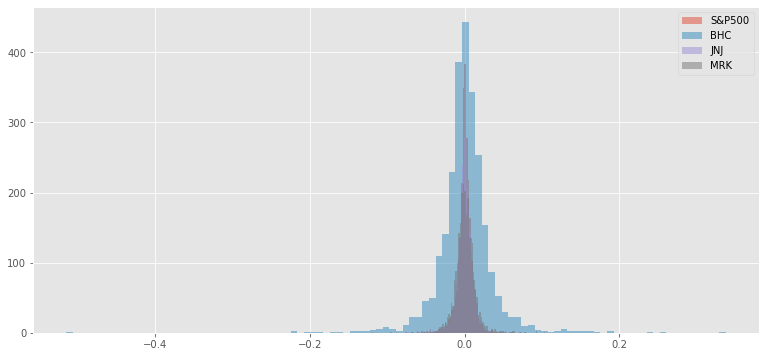

count    2516.000000
mean     0.000488   
std      0.010934   
min     -0.119841   
25%     -0.003308   
50%      0.000653   
75%      0.005229   
max      0.093828   
Name: SP500_Close, dtype: float64
count    2516.000000
mean     0.000464   
std      0.035700   
min     -0.514629   
25%     -0.013011   
50%      0.000431   
75%      0.014973   
max      0.337444   
Name: BHC_HP_Close, dtype: float64
count    2516.000000
mean     0.000409   
std      0.010847   
min     -0.100379   
25%     -0.004283   
50%      0.000299   
75%      0.005656   
max      0.079977   
Name: JNJ_HP_Close, dtype: float64
count    2516.000000
mean     0.000410   
std      0.013049   
min     -0.088990   
25%     -0.006119   
50%      0.000283   
75%      0.007303   
max      0.104080   
Name: MRK_HP_Close, dtype: float64


In [86]:
# calculate Daily Returns based on industry with S&P500
final_data_sp500_return = data_1['SP500_Close'].pct_change()
final_data_bhc_hp_return = data_1['BHC_HP_Close'].pct_change() 
final_data_jnj_hp_return = data_1['JNJ_HP_Close'].pct_change() 
final_data_mrk_hp_return = data_1['MRK_HP_Close'].pct_change() 

# plot the Daily Returns
print(final_data_sp500_return.hist(bins=100, label='S&P500', alpha=0.5, figsize = (13,6)))
print(final_data_bhc_hp_return.hist(bins=100, label='BHC', alpha=0.5, figsize = (13,6)))
print(final_data_jnj_hp_return.hist(bins=100, label='JNJ', alpha=0.5, figsize = (13,6)))
print(final_data_mrk_hp_return.hist(bins=100, label='MRK', alpha=0.5, figsize = (13,6)))
plt.legend(loc='best')
plt.show()


# summarize the daily returns
print(final_data_sp500_return.describe())
print(final_data_bhc_hp_return.describe())
print(final_data_jnj_hp_return.describe())
print(final_data_mrk_hp_return.describe())

<u>Observation</u>: 
Higher the standard deviation, more volatile is the stock. So, in the above figures a volatile stock will cover more area. This is based on the below formula

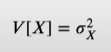

## 4 (IV) Understand the stock spread using box plots

In [87]:
final_data_sp500_return

Date
2010-01-10   NaN      
2010-04-10   -0.008035
2010-05-10    0.020861
2010-06-10   -0.000672
2010-07-10   -0.001647
2010-08-10    0.006122
2010-11-10    0.000146
2010-12-10    0.003819
2010-10-13    0.007121
2010-10-14   -0.003641
2010-10-15    0.002027
2010-10-18    0.007244
2010-10-19   -0.015877
2010-10-20    0.010524
2010-10-21    0.001774
2010-10-22    0.002389
2010-10-25    0.002147
2010-10-26    0.000017
2010-10-27   -0.002691
2010-10-28    0.001125
2010-10-29   -0.000439
2010-01-11    0.000947
2010-02-11    0.007759
2010-03-11    0.003678
2010-04-11    0.019283
2010-05-11    0.003923
2010-08-11   -0.002121
2010-09-11   -0.008052
2010-10-11    0.004376
2010-11-11   -0.004242
2010-12-11   -0.011808
2010-11-15   -0.001217
2010-11-16   -0.016205
2010-11-17    0.000212
2010-11-18    0.015357
2010-11-19    0.002540
2010-11-22   -0.001575
2010-11-23   -0.014284
2010-11-24    0.014923
2010-11-26   -0.007469
2010-11-29   -0.001379
2010-11-30   -0.006070
2010-01-12    0.021617
2010-0

In [88]:
# Create Histogram

box_df1 = pd.concat([final_data_aapl_tech_return, final_data_amzn_tech_return, final_data_goog_tech_return], axis =1)
#box_df1.columns=['AALreturn', 'AAPLreturn', 'ALKreturn', 'AMZNreturn']
px.histogram(box_df1)

In [89]:
# Create Histogram

box_df1 = pd.concat([final_data_ha_av_return, final_data_aal_av_return, final_data_alk_av_return], axis =1)
#box_df1.columns=['AALreturn', 'AAPLreturn', 'ALKreturn', 'AMZNreturn']
px.histogram(box_df1)

In [90]:
# Create Histogram

box_df1 = pd.concat([final_data_gs_fi_return, final_data_cs_fi_return, final_data_db_fi_return], axis =1)
#box_df1.columns=['AALreturn', 'AAPLreturn', 'ALKreturn', 'AMZNreturn']
px.histogram(box_df1)

In [91]:
# Create Histogram

box_df1 = pd.concat([final_data_bhc_hp_return, final_data_jnj_hp_return, final_data_mrk_hp_return], axis =1)
#box_df1.columns=['AALreturn', 'AAPLreturn', 'ALKreturn', 'AMZNreturn']
px.histogram(box_df1)

Observation: The larger the size of box plot, the spread of the stock return varies

## 4 (V). What was the correlation between different stocks closing prices?

#### Now what if we wanted to analyze the returns of all the stocks in our list? Let's go ahead and build a DataFrame with all the ['Close'] columns for each of the stocks dataframes.

In [92]:
#Aviation Stocks

Aviation=final_data_scaled[['SP500_Close','AAL_AV_Close','ALK_AV_Close','HA_AV_Close']]
Finance=final_data_scaled[['SP500_Close','CS_FI_Close','DB_FI_Close','GS_FI_Close']]
HealthPharma=final_data_scaled[['SP500_Close','BHC_HP_Close','JNJ_HP_Close','MRK_HP_Close']]
Technology=final_data_scaled[['SP500_Close','AAPL_TECH_Close','AMZN_TECH_Close','GOOG_TECH_Close']]

print("##### Aviation : ##### ", Aviation.head())
print("##### Finance : ##### ", Finance.head())
print("##### HealthParma : ##### ", HealthPharma.head())
print("##### Technology : ##### ", Technology.head())

##### Aviation : #####              SP500_Close  AAL_AV_Close  ALK_AV_Close  HA_AV_Close
Date                                                            
2010-01-10  1.000000     1.000000      1.000000      1.000000   
2010-04-10  0.991965     0.981701      0.975497      0.964765   
2010-05-10  1.012659     0.993541      0.981322      0.981544   
2010-06-10  1.011978     0.993541      0.979112      1.001678   
2010-07-10  1.010312     0.994618      0.933922      1.031879   
##### Finance : #####              SP500_Close  CS_FI_Close  DB_FI_Close  GS_FI_Close
Date                                                          
2010-01-10  1.000000     1.000000     1.000000     1.000000   
2010-04-10  0.991965     0.992599     0.984035     0.992349   
2010-05-10  1.012659     1.021970     1.025762     1.012661   
2010-06-10  1.011978     1.028677     1.038280     1.021259   
2010-07-10  1.010312     1.034228     1.027395     1.023087   
##### HealthParma : #####              SP500_Close  BHC_H

### 4 (V) a. Aviation Correlation

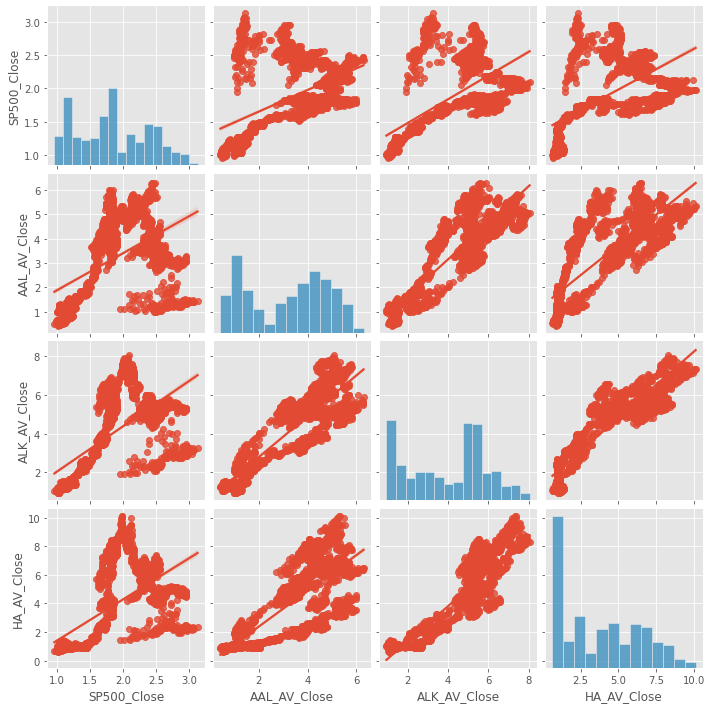

In [93]:
sns.pairplot(Aviation, kind = 'reg')
plt.ioff()

In [94]:
px.imshow(Aviation.corr(), text_auto=True)

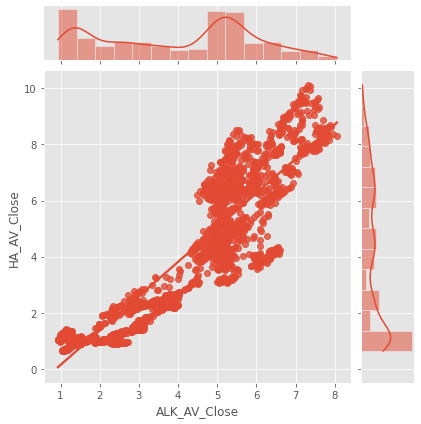

In [95]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='ALK_AV_Close', y='HA_AV_Close', data=final_data_scaled, kind='reg')

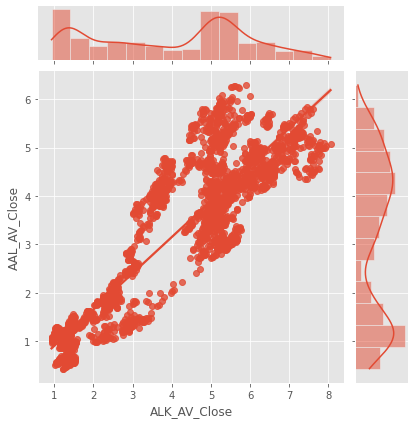

In [96]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='ALK_AV_Close', y='AAL_AV_Close', data=final_data_scaled, kind='reg')

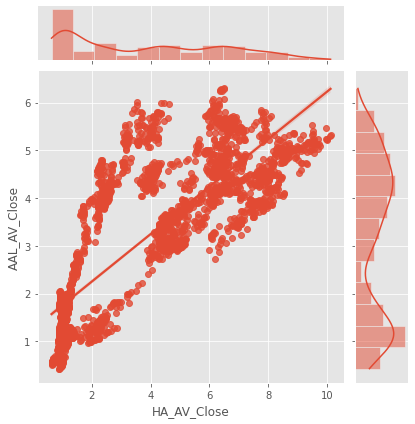

In [97]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='HA_AV_Close', y='AAL_AV_Close', data=final_data_scaled, kind='reg')

- Strong Positive Correlation (0.6 to 1) - ALK
- Weak Positive Correlation (0 to 0.6) - AAL & HA

### 4 (V) b. Finance correlation

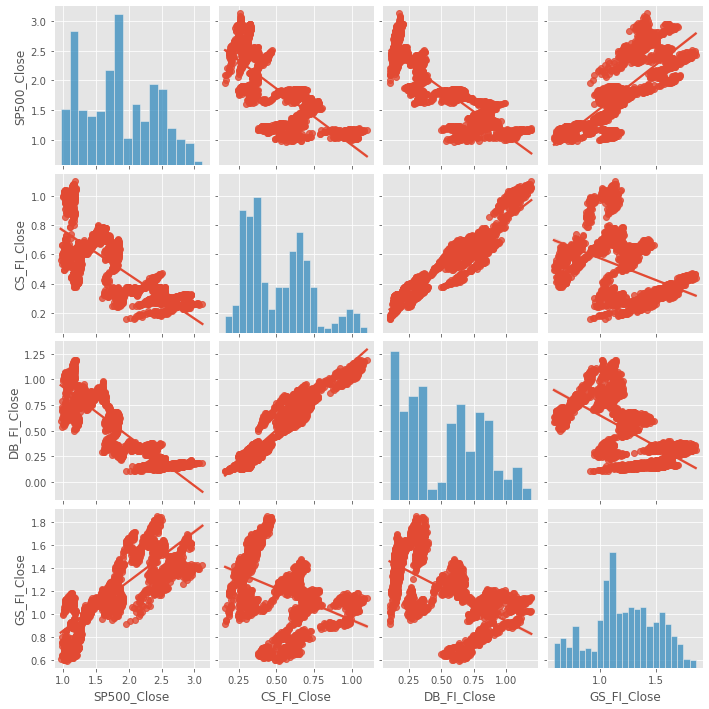

In [98]:
sns.pairplot(Finance, kind = 'reg')
plt.ioff()
plt.show()

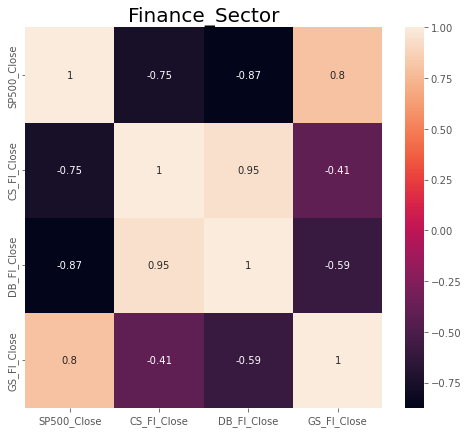

In [99]:
Finance_Corr = sns.heatmap(Finance.corr(), annot=True)
plt.title('Finance_Sector', fontsize = 20)
Finance_Corr
plt.show()

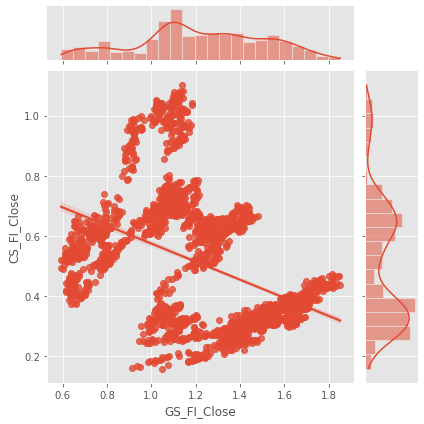

In [100]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='GS_FI_Close', y='CS_FI_Close', data=final_data_scaled, kind='reg')
plt.show()

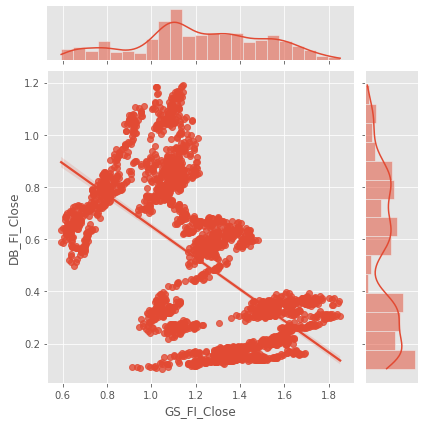

In [101]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='GS_FI_Close', y='DB_FI_Close', data=final_data_scaled, kind='reg')
plt.show()

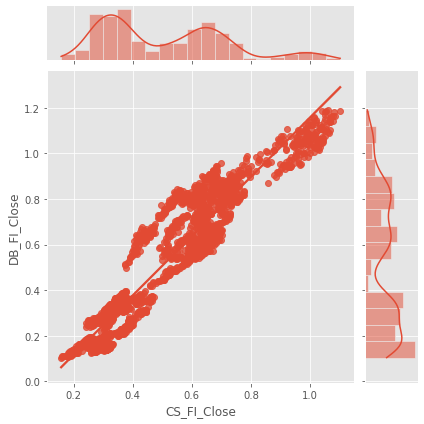

In [102]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='CS_FI_Close', y='DB_FI_Close', data=final_data_scaled, kind='reg')
plt.show()

- Strong Positive Correlation (0.6 to 1): GS

- Negative Correlation (0 to -1): DB & CS

### 4 (V) c. HealthPharma Correlation

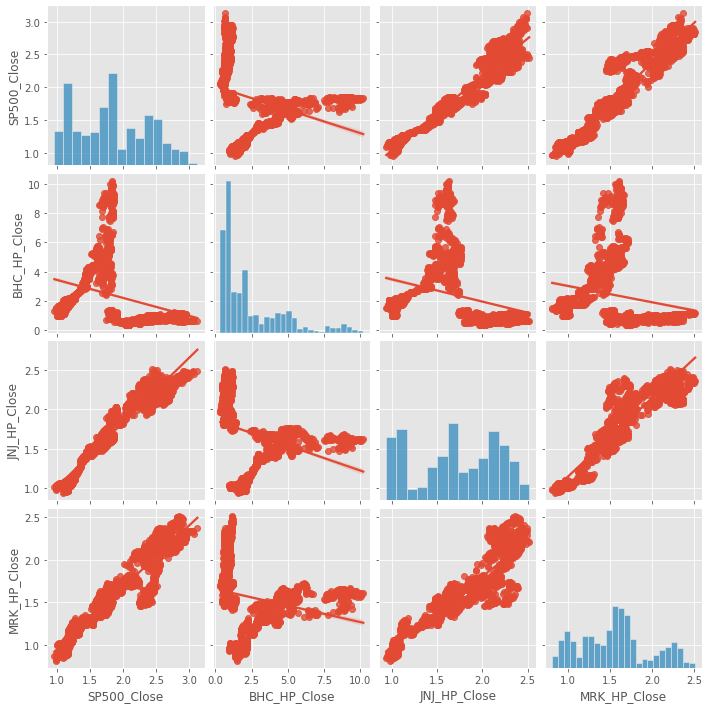

In [103]:
sns.pairplot(HealthPharma, kind = 'reg')
plt.ioff()
plt.show()

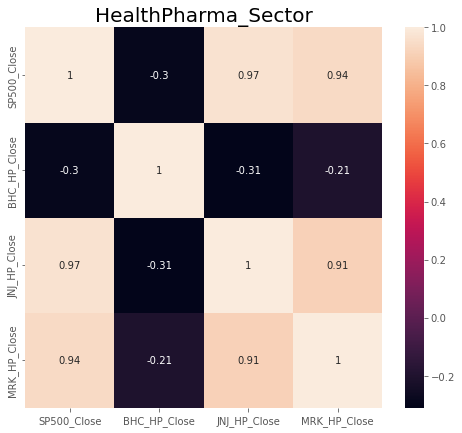

In [104]:
HealthPharma_Corr = sns.heatmap(HealthPharma.corr(), annot=True)
plt.title('HealthPharma_Sector', fontsize = 20)
HealthPharma_Corr
plt.show()

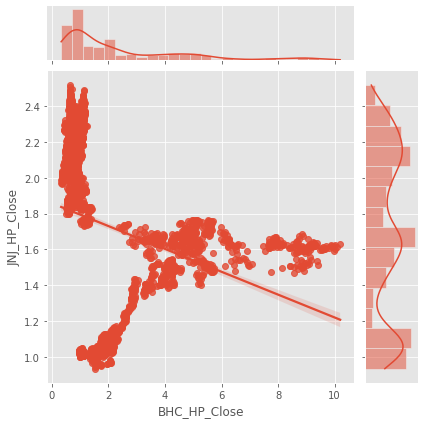

In [105]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='BHC_HP_Close', y='JNJ_HP_Close', data=final_data_scaled, kind='reg')
plt.show()

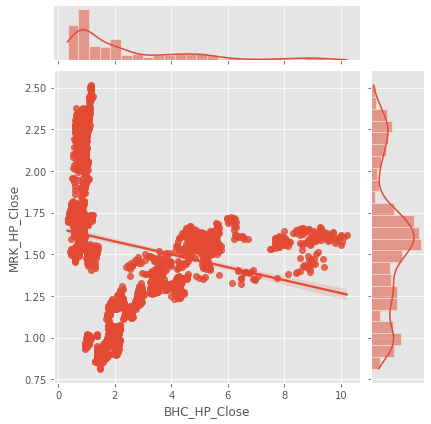

In [106]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='BHC_HP_Close', y='MRK_HP_Close', data=final_data_scaled, kind='reg')
plt.show()

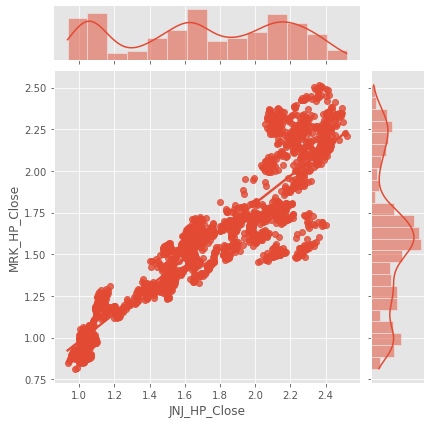

In [107]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='JNJ_HP_Close', y='MRK_HP_Close', data=final_data_scaled, kind='reg')
plt.show()

- Strong Positive Correlation (0.6 to 1): JNJ & MRK
- Negative Correlation (0 to -1): BHC

### 4 (V) d. Technology Correlation

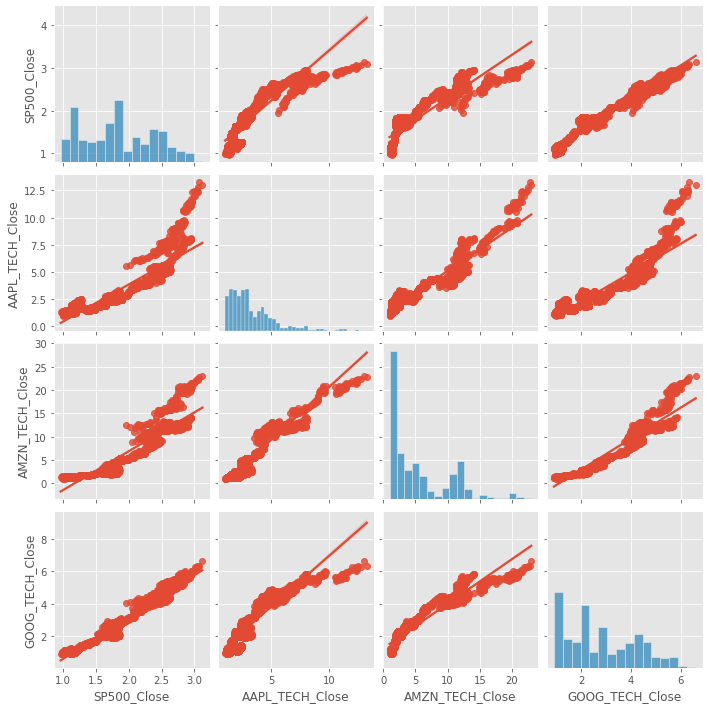

In [108]:
sns.pairplot(Technology, kind = 'reg')
plt.ioff()
plt.show()

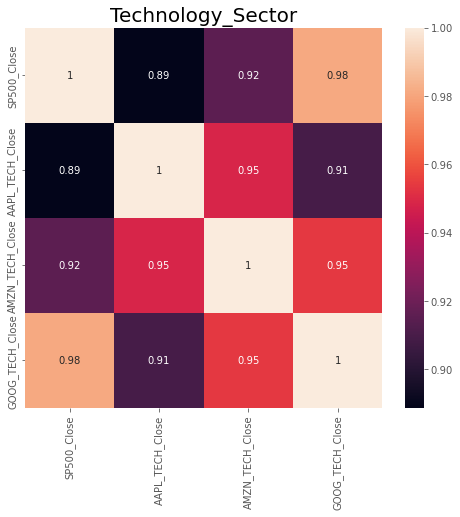

In [109]:
Technology_Corr = sns.heatmap(Technology.corr(), annot=True)
plt.title('Technology_Sector', fontsize = 20)
Technology_Corr
plt.show()

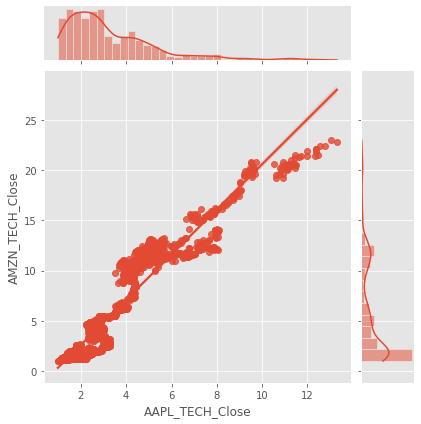

In [110]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='AAPL_TECH_Close', y='AMZN_TECH_Close', data=final_data_scaled, kind='reg')
plt.show()

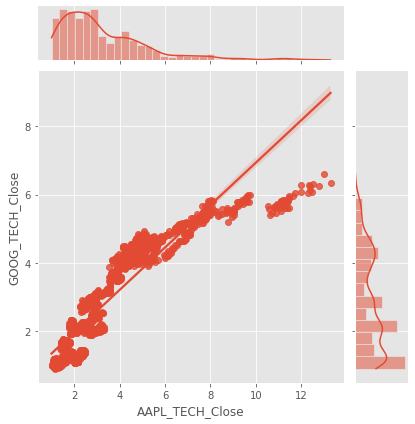

In [111]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='AAPL_TECH_Close', y='GOOG_TECH_Close', data=final_data_scaled, kind='reg')
plt.show()

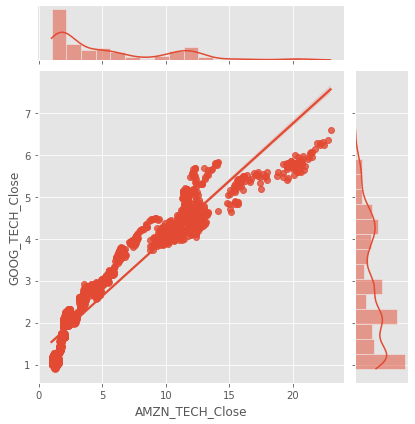

In [112]:
# We'll use joinplot to compare the daily returns of Google and Microsoft
sns.jointplot(x='AMZN_TECH_Close', y='GOOG_TECH_Close', data=final_data_scaled, kind='reg')
plt.show()

- Strong Positive Correlation (0.6 to 1): AAPL, AMZN & GOOG

<Figure size 1800x1080 with 0 Axes>

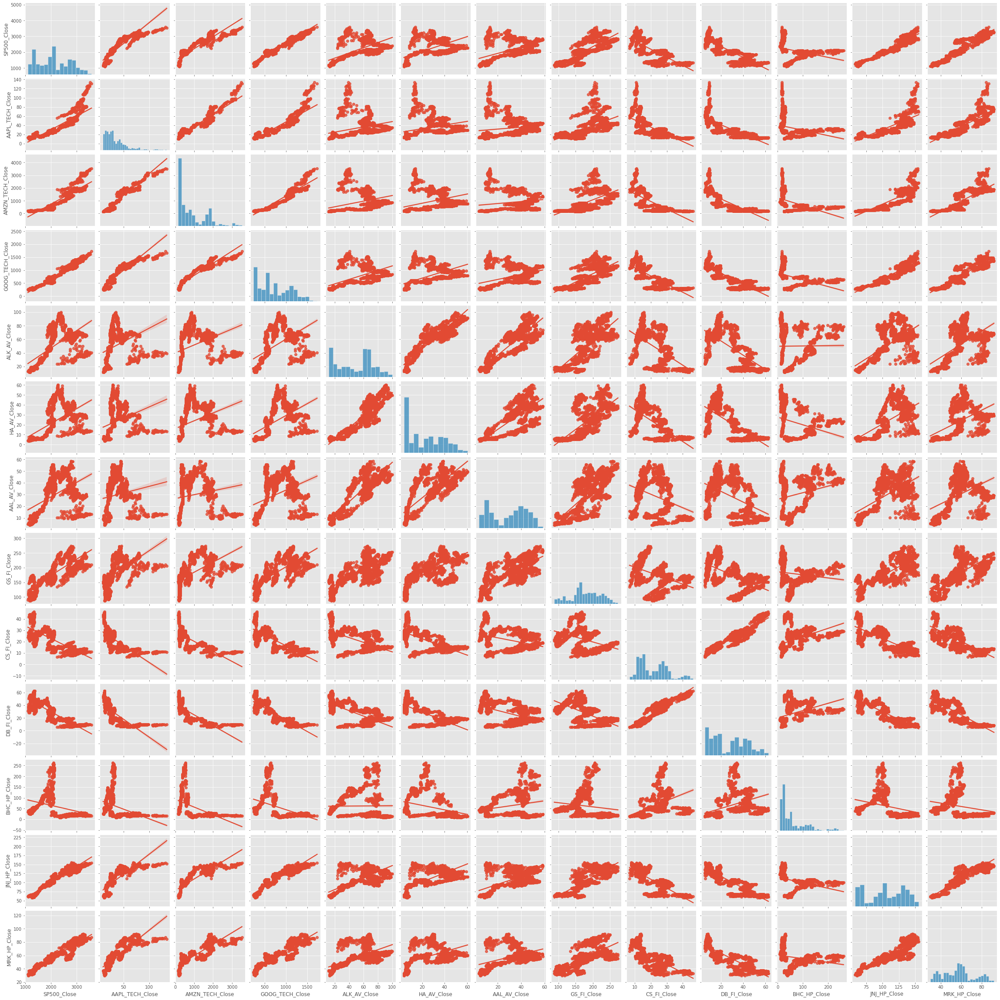

In [113]:
plt.figure(figsize=(25,15))
sns.pairplot(data_1, kind='reg', palette='hue')
plt.show()

In [114]:
data_1_col = list(data_1.iloc[0])
data_1_col

[1146.23999,
 10.09,
 153.710007,
 261.828613,
 12.4475,
 5.96,
 9.29,
 147.699997,
 42.226563,
 52.595421,
 25.75,
 61.75,
 36.599998]

<AxesSubplot:xlabel='Date'>

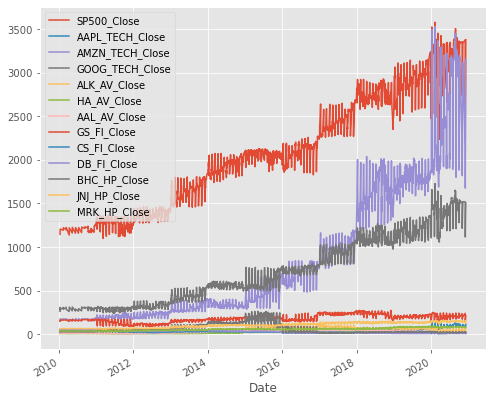

In [115]:
data_1.groupby('Date').sum().plot(grid=True)

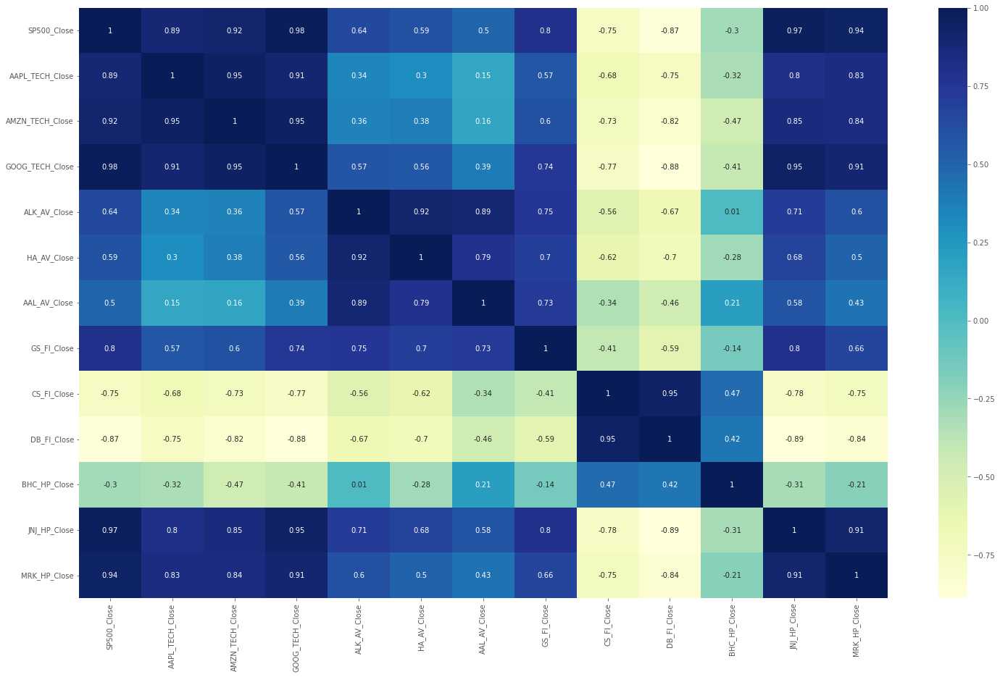

In [116]:
plt.figure(figsize=(25,15))
sns.heatmap(data_1.corr(),cmap='YlGnBu',annot=True)
plt.show()

#### Conclusion Summary: 
Index is in an uptrend and these stocks have the following correlation:

1> Strong Positive Correlation (0.6 to 1): AAPL, AMZN, GOOG, ALK, GS, JNJ & MRK

2> Weak Positive Correlation (0 to 0.6): HA & AAL

3> Negative Correlation (0 to -1): CS, DB & BHC

Observation: Stocks with positive correlation are recommended during the advancing phase of market cycle / index, whilst stocks with negative correlation should be avoid during this phase.

## 4. (VI) Outlier

In [117]:
final_data_scaled.describe()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
count,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000
mean,1.842016,3.315626,5.560055,2.789711,4.019375,3.837318,3.164439,1.215966,0.509191,0.519150,2.403133,1.704897,1.561777
std,0.534118,2.044610,4.848098,1.392841,1.943123,2.597825,1.637448,0.287105,0.212853,0.292991,2.220194,0.456263,0.414331
min,0.958988,0.986266,0.995576,0.903466,0.933521,0.634228,0.430571,0.593771,0.157957,0.104192,0.330485,0.933765,0.814481
25%,1.362865,1.879230,1.733719,1.541627,2.151436,1.179530,1.400431,1.049357,0.325388,0.256106,0.860971,1.326802,1.249454
50%,1.806969,2.734638,3.472448,2.489376,4.702952,3.676174,3.500538,1.199932,0.465110,0.539401,1.505243,1.684858,1.562295
75%,2.317403,4.257929,9.758636,4.032447,5.403495,6.191276,4.542519,1.432498,0.657169,0.780479,3.505631,2.121134,1.751093
max,3.123988,13.298314,22.974756,6.600807,8.053023,10.117449,6.293864,1.850914,1.101526,1.190675,10.194951,2.518380,2.514754


In [118]:
final_data_scaled.describe(percentiles=[.25, .5, .75, .90, .95, .99]).round(2)

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
count,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00,2517.00
mean,1.84,3.32,5.56,2.79,4.02,3.84,3.16,1.22,0.51,0.52,2.40,1.70,1.56
std,0.53,2.04,4.85,1.39,1.94,2.60,1.64,0.29,0.21,0.29,2.22,0.46,0.41
min,0.96,0.99,1.00,0.90,0.93,0.63,0.43,0.59,0.16,0.10,0.33,0.93,0.81
25%,1.36,1.88,1.73,1.54,2.15,1.18,1.40,1.05,0.33,0.26,0.86,1.33,1.25
50%,1.81,2.73,3.47,2.49,4.70,3.68,3.50,1.20,0.47,0.54,1.51,1.68,1.56
75%,2.32,4.26,9.76,4.03,5.40,6.19,4.54,1.43,0.66,0.78,3.51,2.12,1.75
90%,2.56,5.63,12.26,4.70,6.42,7.67,5.22,1.61,0.75,0.90,5.41,2.28,2.22
95%,2.73,7.67,13.91,5.32,7.01,8.25,5.51,1.66,0.96,1.04,7.87,2.37,2.30
99%,2.94,11.20,20.57,5.81,7.64,9.44,5.85,1.78,1.04,1.13,9.30,2.44,2.43


## 4 (VII) Stocks Returns Rate and Risk

In [119]:
dfcomp = data_1.pct_change()

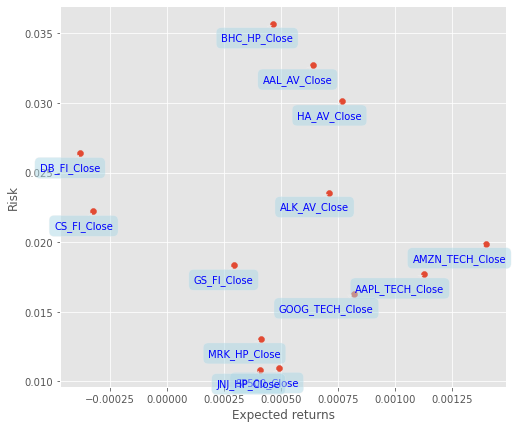

In [120]:
plt.scatter(dfcomp.mean(), dfcomp.std())
plt.xlabel('Expected returns')
plt.ylabel('Risk')
for label, x, y in zip(dfcomp.columns, dfcomp.mean(), dfcomp.std()):
    plt.annotate(
        label, 
        xy = (x, y), xytext = (20, -20),
        textcoords = 'offset points', ha = 'right', va = 'bottom',
        bbox = dict(boxstyle = 'round,pad=0.5', fc = 'lightblue', alpha = 0.5),
        arrowprops = dict(arrowstyle = '->', connectionstyle = 'arc3,rad=0'), c='b')
plt.show()

In [121]:
df.resample('Y').last()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close,m_returns
Date,,,,,,,,,,,,,,
2010-12-31,1257.640015,11.520000,180.000000,295.875977,14.172500,7.840000,10.010000,168.160004,39.462891,49.666031,28.290001,61.849998,36.040001,1257.640015
2011-12-31,1257.599976,14.464286,173.100006,321.744019,18.772499,5.800000,5.070000,90.430000,22.929688,36.125954,46.689999,65.580002,37.700001,1257.599976
2012-12-31,1426.189941,19.006071,250.869995,352.369232,21.545000,6.570000,13.500000,127.559998,23.984375,42.261452,59.770000,70.099998,40.939999,1426.189941
2013-12-31,1848.359985,20.036428,398.790009,558.262512,36.685001,9.630000,25.250000,177.259995,31.040001,46.030533,117.400002,91.589996,50.049999,1848.359985
2014-12-31,2058.899902,27.594999,310.350006,524.958740,59.759998,26.049999,53.630001,193.830002,25.080000,30.020000,143.110001,104.570000,56.790001,2058.899902
2015-12-31,2043.939941,26.315001,675.890015,758.880005,80.510002,35.330002,42.349998,180.229996,21.690001,24.150000,101.650002,102.720001,52.820000,2043.939941
2016-12-31,2238.830078,28.955000,749.869995,771.820007,88.730003,57.000000,46.689999,239.449997,14.310000,18.100000,14.520000,115.209999,58.869999,2238.830078
2017-12-31,2673.610107,42.307499,1169.469971,1046.400024,73.510002,39.849998,52.029999,254.759995,17.850000,19.030001,20.780001,139.720001,56.270000,2673.610107
2018-12-31,2506.850098,39.435001,1501.969971,1035.609985,60.849998,26.410000,32.110001,167.050003,10.860000,8.150000,18.469999,129.050003,76.410004,2506.850098


In [122]:
#Aviation=final_data_scaled[['SP500_Close','AAL_AV_Close','ALK_AV_Close','HA_AV_Close']]
#Finance=final_data_scaled[['SP500_Close','CS_FI_Close','DB_FI_Close','GS_FI_Close']]
#HealthPharma=final_data_scaled[['SP500_Close','BHC_HP_Close','JNJ_HP_Close','MRK_HP_Close']]
#Technology=

# Part IV: Stock Analysis and Portfolio Management - CAPM

### 5. Performance Measures of a Portfolio

In [123]:
# Initial weight for each stock in order
stocks_av = final_data_scaled[['AAL_AV_Close','ALK_AV_Close','HA_AV_Close']]
stocks_fi = final_data_scaled[['CS_FI_Close','DB_FI_Close','GS_FI_Close']]
stocks_hp = final_data_scaled[['BHC_HP_Close','JNJ_HP_Close','MRK_HP_Close']]
stocks_tech = final_data_scaled[['AAPL_TECH_Close','AMZN_TECH_Close','GOOG_TECH_Close']]

initial_weight_tech = np.array([0.30, 0.30, 0.40])
initial_weight_av = np.array([0.05, 0.50, 0.45])
initial_weight_fi = np.array([0.20, 0.10, 0.70])
initial_weight_hp = np.array([0.30, 0.30, 0.40])

### 5 a. Daily return from each stock

Daily return is the percentage change in the price of the stock from the previous day. This can be calculated using the percentage change in the price on a daily basis.

In [124]:
# Daily return from each stock 
return_stocks_tech = data_1[['AAPL_TECH_Close','AMZN_TECH_Close','GOOG_TECH_Close']].pct_change()
return_stocks_av = data_1[['AAL_AV_Close','ALK_AV_Close','HA_AV_Close']].pct_change()
return_stocks_fi = data_1[['CS_FI_Close','DB_FI_Close','GS_FI_Close']].pct_change()
return_stocks_hp = data_1[['BHC_HP_Close','JNJ_HP_Close','MRK_HP_Close']].pct_change()

return_stocks_av.head()
return_stocks_fi.head()
return_stocks_hp.head()
return_stocks_tech.head()

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close
Date,,,
2010-01-10,NaN,NaN,NaN
2010-04-10,-0.013734,0.010930,-0.006221
2010-05-10,0.036965,0.035266,0.030401
2010-06-10,0.000865,-0.034003,-0.007209
2010-07-10,0.000104,0.005599,-0.008122


### 5 b. Following dates shows the maximum and minimum drop for Securities

In [125]:
# Using the daily returns
print("******************######################******************")
print("                       Minimum price")
print("******************######################******************")
print(return_stocks_tech[return_stocks_tech.GOOG_TECH_Close == return_stocks_tech.GOOG_TECH_Close.min()])
print(return_stocks_tech[return_stocks_tech.AAPL_TECH_Close == return_stocks_tech.AAPL_TECH_Close.min()])
print(return_stocks_tech[return_stocks_tech.AMZN_TECH_Close == return_stocks_tech.AMZN_TECH_Close.min()])

# Using the daily returns
print("                       ")
print("******************######################******************")
print("                       Maximum Price")
print("******************######################******************")
print(return_stocks_tech[return_stocks_tech.GOOG_TECH_Close == return_stocks_tech.GOOG_TECH_Close.max()])
print(return_stocks_tech[return_stocks_tech.AAPL_TECH_Close == return_stocks_tech.AAPL_TECH_Close.max()])
print(return_stocks_tech[return_stocks_tech.AMZN_TECH_Close == return_stocks_tech.AMZN_TECH_Close.max()])

******************######################******************
                       Minimum price
******************######################******************
            AAPL_TECH_Close  AMZN_TECH_Close  GOOG_TECH_Close
Date                                                         
2020-03-16 -0.128647        -0.053697        -0.111008       
            AAPL_TECH_Close  AMZN_TECH_Close  GOOG_TECH_Close
Date                                                         
2020-03-16 -0.128647        -0.053697        -0.111008       
            AAPL_TECH_Close  AMZN_TECH_Close  GOOG_TECH_Close
Date                                                         
2011-10-26  0.007115        -0.126568         0.005402       
                       
******************######################******************
                       Maximum Price
******************######################******************
            AAPL_TECH_Close  AMZN_TECH_Close  GOOG_TECH_Close
Date                                          

In [126]:
print("******************######################******************")
print("                       Minimum price")
print("******************######################******************")
print(return_stocks_av[return_stocks_av.AAL_AV_Close == return_stocks_av.AAL_AV_Close.min()])
print(return_stocks_av[return_stocks_av.ALK_AV_Close == return_stocks_av.ALK_AV_Close.min()])
print(return_stocks_av[return_stocks_av.HA_AV_Close == return_stocks_av.HA_AV_Close.min()])



print("                       ")
print("******************######################******************")
print("                       Maximum Price")
print("******************######################******************")
print(return_stocks_av[return_stocks_av.AAL_AV_Close == return_stocks_av.AAL_AV_Close.max()])
print(return_stocks_av[return_stocks_av.ALK_AV_Close == return_stocks_av.ALK_AV_Close.max()])
print(return_stocks_av[return_stocks_av.HA_AV_Close == return_stocks_av.HA_AV_Close.max()])

******************######################******************
                       Minimum price
******************######################******************
            AAL_AV_Close  ALK_AV_Close  HA_AV_Close
Date                                               
2020-03-18 -0.252246     -0.227482     -0.264971   
            AAL_AV_Close  ALK_AV_Close  HA_AV_Close
Date                                               
2020-12-03 -0.172817     -0.232385     -0.221093   
            AAL_AV_Close  ALK_AV_Close  HA_AV_Close
Date                                               
2015-01-30 -0.06049      -0.045026     -0.269722   
                       
******************######################******************
                       Maximum Price
******************######################******************
            AAL_AV_Close  ALK_AV_Close  HA_AV_Close
Date                                               
2020-04-06  0.41097       0.076845      0.148082   
            AAL_AV_Close  ALK_AV_Close  HA

In [127]:
print("******************######################******************")
print("                       Minimum price")
print("******************######################******************")
print(return_stocks_fi[return_stocks_fi.CS_FI_Close == return_stocks_fi.CS_FI_Close.min()])
print(return_stocks_fi[return_stocks_fi.DB_FI_Close == return_stocks_fi.DB_FI_Close.min()])
print(return_stocks_fi[return_stocks_fi.GS_FI_Close == return_stocks_fi.GS_FI_Close.min()])

print("                       ")
print("******************######################******************")
print("                       Maximum Price")
print("******************######################******************")
print(return_stocks_fi[return_stocks_fi.CS_FI_Close == return_stocks_fi.CS_FI_Close.max()])
print(return_stocks_fi[return_stocks_fi.DB_FI_Close == return_stocks_fi.DB_FI_Close.max()])
print(return_stocks_fi[return_stocks_fi.GS_FI_Close == return_stocks_fi.GS_FI_Close.max()])

******************######################******************
                       Minimum price
******************######################******************
            CS_FI_Close  DB_FI_Close  GS_FI_Close
Date                                             
2020-03-16 -0.182598    -0.082077    -0.127053   
            CS_FI_Close  DB_FI_Close  GS_FI_Close
Date                                             
2016-06-24 -0.161079    -0.174888    -0.070745   
            CS_FI_Close  DB_FI_Close  GS_FI_Close
Date                                             
2020-03-16 -0.182598    -0.082077    -0.127053   
                       
******************######################******************
                       Maximum Price
******************######################******************
            CS_FI_Close  DB_FI_Close  GS_FI_Close
Date                                             
2020-03-24  0.163447     0.126712     0.138031   
            CS_FI_Close  DB_FI_Close  GS_FI_Close
Date            

In [128]:
print("******************######################******************")
print("                       Minimum price")
print("******************######################******************")
print(return_stocks_hp[return_stocks_hp.BHC_HP_Close == return_stocks_hp.BHC_HP_Close.min()])
print(return_stocks_hp[return_stocks_hp.JNJ_HP_Close == return_stocks_hp.JNJ_HP_Close.min()])
print(return_stocks_hp[return_stocks_hp.MRK_HP_Close == return_stocks_hp.MRK_HP_Close.min()])

print("                       ")
print("******************######################******************")
print("                       Maximum Price")
print("******************######################******************")
print(return_stocks_hp[return_stocks_hp.BHC_HP_Close == return_stocks_hp.BHC_HP_Close.max()])
print(return_stocks_hp[return_stocks_hp.JNJ_HP_Close == return_stocks_hp.JNJ_HP_Close.max()])
print(return_stocks_hp[return_stocks_hp.MRK_HP_Close == return_stocks_hp.MRK_HP_Close.max()])

******************######################******************
                       Minimum price
******************######################******************
            BHC_HP_Close  JNJ_HP_Close  MRK_HP_Close
Date                                                
2016-03-15 -0.514629      0.000929     -0.012434    
            BHC_HP_Close  JNJ_HP_Close  MRK_HP_Close
Date                                                
2018-12-14 -0.032981     -0.100379     -0.032021    
            BHC_HP_Close  JNJ_HP_Close  MRK_HP_Close
Date                                                
2020-03-16 -0.204255     -0.053317     -0.08899     
                       
******************######################******************
                       Maximum Price
******************######################******************
            BHC_HP_Close  JNJ_HP_Close  MRK_HP_Close
Date                                                
2016-01-11  0.337444     -0.005604      0.009877    
            BHC_HP_Close  JNJ_

In [129]:
stock_risk_tech = return_stocks_tech.std()
stock_risk_av = return_stocks_av.std()
stock_risk_fi = return_stocks_fi.std()
stock_risk_hp = return_stocks_hp.std()
print(stock_risk_tech)
print(stock_risk_av)
print(stock_risk_fi)
print(stock_risk_hp)

AAPL_TECH_Close    0.017719
AMZN_TECH_Close    0.019889
GOOG_TECH_Close    0.016288
dtype: float64
AAL_AV_Close    0.032726
ALK_AV_Close    0.023562
HA_AV_Close     0.030147
dtype: float64
CS_FI_Close    0.022206
DB_FI_Close    0.026374
GS_FI_Close    0.018331
dtype: float64
BHC_HP_Close    0.035700
JNJ_HP_Close    0.010847
MRK_HP_Close    0.013049
dtype: float64


### 5 c. Average daily return from each stock

Average daily return for each stock can be calculated using the dataframe created above - "return_stocks"

In [130]:
# Average daily return from each stock
daily_returns_av_mean = return_stocks_av.mean()
daily_returns_fi_mean = return_stocks_fi.mean()
daily_returns_hp_mean = return_stocks_hp.mean()
daily_returns_tech_mean = return_stocks_tech.mean()

print(daily_returns_tech_mean)
print(daily_returns_av_mean)
print(daily_returns_fi_mean)
print(daily_returns_hp_mean)


AAPL_TECH_Close    0.001128
AMZN_TECH_Close    0.001398
GOOG_TECH_Close    0.000818
dtype: float64
AAL_AV_Close    0.000637
ALK_AV_Close    0.000709
HA_AV_Close     0.000765
dtype: float64
CS_FI_Close   -0.000325
DB_FI_Close   -0.000381
GS_FI_Close    0.000291
dtype: float64
BHC_HP_Close    0.000464
JNJ_HP_Close    0.000409
MRK_HP_Close    0.000410
dtype: float64


In [131]:
dfcomp.describe()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
count,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000,2516.000000
mean,0.000488,0.001128,0.001398,0.000818,0.000709,0.000765,0.000637,0.000291,-0.000325,-0.000381,0.000464,0.000409,0.000410
std,0.010934,0.017719,0.019889,0.016288,0.023562,0.030147,0.032726,0.018331,0.022206,0.026374,0.035700,0.010847,0.013049
min,-0.119841,-0.128647,-0.126568,-0.111008,-0.232385,-0.269722,-0.252246,-0.127053,-0.182598,-0.174888,-0.514629,-0.100379,-0.088990
25%,-0.003308,-0.006971,-0.008133,-0.006431,-0.010126,-0.013826,-0.014116,-0.008367,-0.010897,-0.013920,-0.013011,-0.004283,-0.006119
50%,0.000653,0.000891,0.001107,0.000659,0.000788,0.000451,0.000216,0.000490,0.000000,-0.000495,0.000431,0.000299,0.000283
75%,0.005229,0.010209,0.011457,0.008646,0.011655,0.015317,0.015593,0.009413,0.010796,0.013712,0.014973,0.005656,0.007303
max,0.093828,0.119808,0.157457,0.160524,0.203079,0.245837,0.410970,0.175803,0.163447,0.179506,0.337444,0.079977,0.104080


### 5 d. Total Portfolio Return

Use the initial weights to determine the total return from the portfolio in the given period.

In [132]:
# Answer here
# Total Portfolio Return - Store the reults in "portfolio_return"
# Total Portfolio Return = Weighted average of return from each stock
allocated_daily_returns_av = (initial_weight_av * daily_returns_av_mean)
allocated_daily_returns_fi = (initial_weight_fi * daily_returns_fi_mean)
allocated_daily_returns_hp = (initial_weight_hp * daily_returns_hp_mean)
allocated_daily_returns_tech = (initial_weight_tech * daily_returns_tech_mean)
portfolio_return_av = np.sum(allocated_daily_returns_av)
portfolio_return_fi = np.sum(allocated_daily_returns_fi)
portfolio_return_hp = np.sum(allocated_daily_returns_hp)
portfolio_return_tech = np.sum(allocated_daily_returns_tech)
print(portfolio_return_av)
print(portfolio_return_fi)
print(portfolio_return_hp)
print(portfolio_return_tech)

0.0007309175864872869
0.00010024088187537205
0.00042598694386995826
0.0010845986522381064


In [133]:
### Daily return from the portfolio

In [134]:
# Portfolio daily returns
return_stocks_av['Portfolio_Daily_Return'] = return_stocks_av.dot(initial_weight_av)
return_stocks_fi['Portfolio_Daily_Return'] = return_stocks_fi.dot(initial_weight_fi)
return_stocks_hp['Portfolio_Daily_Return'] = return_stocks_hp.dot(initial_weight_hp)
return_stocks_tech['Portfolio_Daily_Return'] = return_stocks_tech.dot(initial_weight_tech)
return_stocks_av.tail(5)

,AAL_AV_Close,ALK_AV_Close,HA_AV_Close,Portfolio_Daily_Return
Date,,,,
2020-09-24,-0.013412,-0.031470,-0.032006,-0.030809
2020-09-25,0.044180,0.028011,0.032258,0.030731
2020-09-28,0.038242,0.022888,0.045313,0.033747
2020-09-29,-0.039969,-0.023175,-0.038864,-0.031075
2020-09-30,0.003265,-0.001091,0.002333,0.000668


<AxesSubplot:title={'center':'Tech'}, xlabel='Date'>

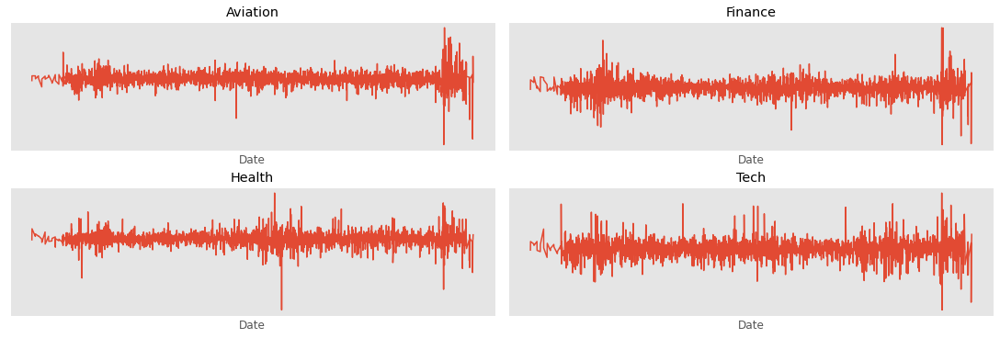

In [135]:
# Plot
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(15,5), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})
return_stocks_av['Portfolio_Daily_Return'].plot(ax=ax1, title="Aviation")
return_stocks_fi['Portfolio_Daily_Return'].plot(ax=ax2, title="Finance")
return_stocks_hp['Portfolio_Daily_Return'].plot(ax=ax3, title="Health")
return_stocks_tech['Portfolio_Daily_Return'].plot(ax=ax4, title="Tech")

- As seen in the plot, the portfolio shows larger variation in prices from 2018 to 2019. 
- Another important point to note is that minimum drop in the daily return is less than 0.5. You can compare this with the value obtained in the question above to check if the variation in portfolio has decreased or not.

### 5 e. Cumulative return from the Portfolio

Cumulative return of an investment is the cumulative gain or loss from an investment over the given period of time. You can read about the cumprod() function here: https://www.geeksforgeeks.org/python-pandas-dataframe-cumprod/

In [136]:
# Cumulative return from the portfolio
av_Cumulative_returns_daily = (1+return_stocks_av).cumprod()
fi_Cumulative_returns_daily = (1+return_stocks_fi).cumprod()
hp_Cumulative_returns_daily = (1+return_stocks_hp).cumprod()
tech_Cumulative_returns_daily = (1+return_stocks_tech).cumprod()
av_Cumulative_returns_daily.tail(5)

,AAL_AV_Close,ALK_AV_Close,HA_AV_Close,Portfolio_Daily_Return
Date,,,,
2020-09-24,1.266954,2.868046,2.080537,2.903078
2020-09-25,1.322928,2.948383,2.147651,2.992291
2020-09-28,1.373520,3.015867,2.244966,3.093272
2020-09-29,1.318622,2.945973,2.157718,2.997149
2020-09-30,1.322928,2.942760,2.162752,2.999150


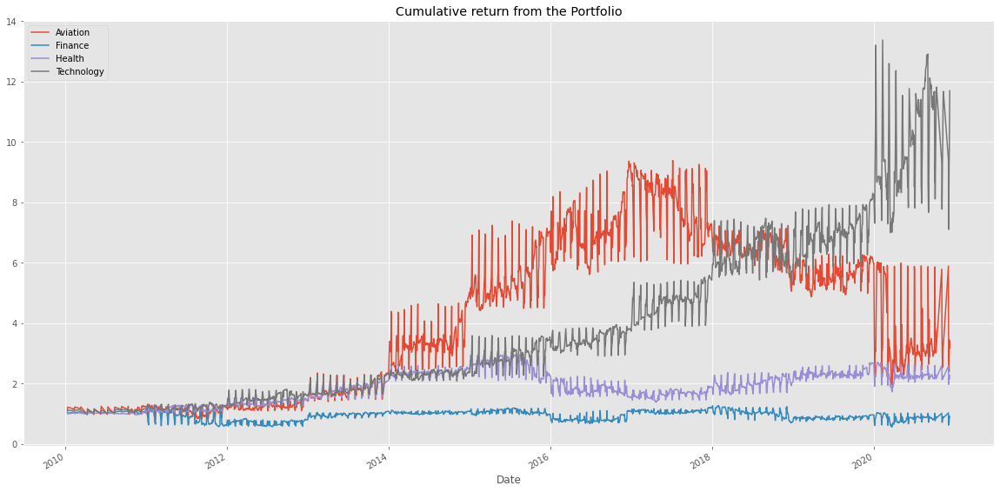

In [137]:
# Plot
#fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(15,5), constrained_layout = True, subplot_kw={'xticks': [], 'yticks': []})

av_Cumulative_returns_daily['Portfolio_Daily_Return'].plot(label="Aviation",figsize=(20,10))
fi_Cumulative_returns_daily['Portfolio_Daily_Return'].plot(label="Finance")
hp_Cumulative_returns_daily['Portfolio_Daily_Return'].plot(label="Health")
tech_Cumulative_returns_daily['Portfolio_Daily_Return'].plot(label="Technology")
plt.title("Cumulative return from the Portfolio")
plt.legend()

### 5 f. Portfolio Risk – Portfolio Standard Deviation
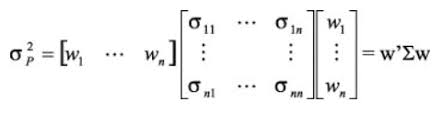

By looking into the portfolio standard deviation formula, we need three elements:
- Portfolio weight array
- Portfolio covariance matrix
- Transpose of portfolio weight array

The weight for each stock in the portfolio is already abailable. We need to calculate the daily covariance. Remember, the covariance must be annualised by multiplying with 252 (the trading days in a year).

In [138]:
# Covariance matrix for the portfolio

# Removing the last column (Portfolio_Daily_Return) from our calculation.
covariance_portfolio_av = return_stocks_av.iloc[:,:-1]
covariance_portfolio_fi = return_stocks_fi.iloc[:,:-1]
covariance_portfolio_hp = return_stocks_hp.iloc[:,:-1]
covariance_portfolio_tech = return_stocks_tech.iloc[:,:-1]
covariance_portfolio_av = (covariance_portfolio_av.cov())*252
covariance_portfolio_fi = (covariance_portfolio_fi.cov())*252
covariance_portfolio_hp = (covariance_portfolio_hp.cov())*252
covariance_portfolio_tech = (covariance_portfolio_tech.cov())*252

print(covariance_portfolio_av)
print(covariance_portfolio_fi)
print(covariance_portfolio_hp)
print(covariance_portfolio_tech)

              AAL_AV_Close  ALK_AV_Close  HA_AV_Close
AAL_AV_Close  0.269885      0.132888      0.151927   
ALK_AV_Close  0.132888      0.139908      0.114194   
HA_AV_Close   0.151927      0.114194      0.229032   
             CS_FI_Close  DB_FI_Close  GS_FI_Close
CS_FI_Close  0.124262     0.115710     0.069665   
DB_FI_Close  0.115710     0.175290     0.080715   
GS_FI_Close  0.069665     0.080715     0.084679   
              BHC_HP_Close  JNJ_HP_Close  MRK_HP_Close
BHC_HP_Close  0.321165      0.023893      0.035033    
JNJ_HP_Close  0.023893      0.029648      0.020663    
MRK_HP_Close  0.035033      0.020663      0.042908    
                 AAPL_TECH_Close  AMZN_TECH_Close  GOOG_TECH_Close
AAPL_TECH_Close  0.079115         0.038568         0.038189       
AMZN_TECH_Close  0.038568         0.099689         0.046959       
GOOG_TECH_Close  0.038189         0.046959         0.066854       


In [139]:
# Applying the matrix operations mentioned in the image above
portfolio_variance_av = np.dot(initial_weight_av.T,np.dot(covariance_portfolio_av, initial_weight_av))
portfolio_variance_fi = np.dot(initial_weight_fi.T,np.dot(covariance_portfolio_fi, initial_weight_fi))
portfolio_variance_hp = np.dot(initial_weight_hp.T,np.dot(covariance_portfolio_hp, initial_weight_hp))
portfolio_variance_tech = np.dot(initial_weight_tech.T,np.dot(covariance_portfolio_tech, initial_weight_tech))

In [140]:
# Standard deviation (risk of portfolio)
portfolio_risk_av = np.sqrt(portfolio_variance_av)
portfolio_risk_fi = np.sqrt(portfolio_variance_fi)
portfolio_risk_hp = np.sqrt(portfolio_variance_hp)
portfolio_risk_tech = np.sqrt(portfolio_variance_tech)
print(portfolio_risk_av)
print(portfolio_risk_fi)
print(portfolio_risk_hp)
print(portfolio_risk_tech)

0.38327441315567357
0.2892240184193818
0.2368673111864351
0.23273742595506988


### 5 g. Sharpe Ratio - Industry wise

In [141]:
# Assuming that the risk free rate is zero
Sharpe_Ratio_av = return_stocks_av['Portfolio_Daily_Return'].mean() / return_stocks_av['Portfolio_Daily_Return'].std()
Sharpe_Ratio_fi = return_stocks_fi['Portfolio_Daily_Return'].mean() / return_stocks_fi['Portfolio_Daily_Return'].std()
Sharpe_Ratio_hp = return_stocks_hp['Portfolio_Daily_Return'].mean() / return_stocks_hp['Portfolio_Daily_Return'].std()
Sharpe_Ratio_tech = return_stocks_tech['Portfolio_Daily_Return'].mean() / return_stocks_tech['Portfolio_Daily_Return'].std()
print(Sharpe_Ratio_av)
print(Sharpe_Ratio_fi)
print(Sharpe_Ratio_hp)
print(Sharpe_Ratio_tech)

0.030273236558738655
0.005501875938798529
0.028549034721466866
0.07397808825191281


In [142]:
Annualised_Sharpe_Ratio_av = (252**0.5)*Sharpe_Ratio_av
Annualised_Sharpe_Ratio_av

0.48057273189270777

In [143]:
Annualised_Sharpe_Ratio_fi = (252**0.5)*Sharpe_Ratio_fi
Annualised_Sharpe_Ratio_fi

0.0873395728703456

In [144]:
Annualised_Sharpe_Ratio_hp = (252**0.5)*Sharpe_Ratio_hp
Annualised_Sharpe_Ratio_hp

0.4532018762636969

In [145]:
Annualised_Sharpe_Ratio_tech = (252**0.5)*Sharpe_Ratio_tech
Annualised_Sharpe_Ratio_tech

1.174365743895302

### 5 h. Monte Carlo Simulation and Efficient Frontier

- Introduction to Monte Carlo Simulation
- Applying Monte Carlo Simulation on portfolios using Sharpe Ratio 
- Creating Efficient Frontier based on Sharpe Ratio

In [146]:
def roll_dice():
    return np.sum(np.random.randint(1, 7, 2))

In [147]:
roll_dice()

11

In [148]:
def monte_carlo_simulation(runs=1000):
    results = np.zeros(2)
    for _ in range(runs):
        if roll_dice() == 7:
            results[0] += 1
        else:
            results[1] += 1
    return results

In [149]:
monte_carlo_simulation()

array([155., 845.])

## 5 h. (1) Portfolio 1:

- AAPL
- AMZN
- GOOG
- GS
- MRK

In [150]:
# data_2_portfolio_1 = pd.DataFrame()

In [151]:
# data_2_portfolio_1["AAPL_TECH_Open"] = data["AAPL_TECH_Open"] * data["AAPL_TECH_Volume"]
# data_2_portfolio_1["AMZN_TECH_Open"] = data["AMZN_TECH_Open"] * data["AMZN_TECH_Volume"]
# data_2_portfolio_1["GOOG_TECH_Open"] = data["GOOG_TECH_Open"] * data["GOOG_TECH_Volume"]
# data_2_portfolio_1["GS_FI_Open"] = data["GS_FI_Open"] * data["GS_FI_Volume"]
# data_2_portfolio_1["MRK_HP_Open"] = data["MRK_HP_Open"] * data["MRK_HP_Volume"]

In [152]:
# data_2_portfolio_1.head()

In [153]:
#choosing Portfolio
data_2_portfolio_1 = data_1[['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'GS_FI_Close', 'MRK_HP_Close']]

In [154]:
data_2_portfolio_1.head()

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,GS_FI_Close,MRK_HP_Close
Date,,,,,
2010-01-10,10.090000,153.710007,261.828613,147.699997,36.599998
2010-04-10,9.951428,155.389999,260.199707,146.570007,36.520000
2010-05-10,10.319285,160.869995,268.110046,149.570007,37.020000
2010-06-10,10.328215,155.399994,266.177307,150.839996,37.009998
2010-07-10,10.329286,156.270004,264.015411,151.110001,36.709999


In [155]:
log_returns_portfolio_1 = np.log(data_2_portfolio_1/data_2_portfolio_1.shift())

In [156]:
log_returns_portfolio_1

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,GS_FI_Close,MRK_HP_Close
Date,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN
2010-04-10,-0.013829,0.010870,-0.006241,-0.007680,-0.002188
2010-05-10,0.036298,0.034658,0.029948,0.020261,0.013598
2010-06-10,0.000865,-0.034594,-0.007235,0.008455,-0.000270
2010-07-10,0.000104,0.005583,-0.008155,0.001788,-0.008139
2010-08-10,0.016630,-0.004618,0.011891,0.010205,0.005433
2010-11-10,0.004377,-0.016333,0.004632,-0.003018,-0.001356
2010-12-10,0.010709,0.022294,0.004721,0.019584,-0.005986
2010-10-13,0.005345,-0.008407,0.003522,-0.003097,0.014092


In [157]:
#calculating the random weight for portfolio
np.random.seed(42)
#weight_1 = np.random.random(5)
weight_1 = np.random.random(5)
weight_1 /= weight_1.sum()
weight_1

array([0.13319703, 0.33810082, 0.26031769, 0.21289984, 0.05548463])

In [158]:
weight_1.shape

(5,)

In [159]:
#expected return
exp_rtn = np.sum(log_returns_portfolio_1.mean()*weight_1)*252
exp_rtn

0.1909070325531953

In [160]:
#Expected Volatility
exp_vol = np.sqrt(np.dot(weight_1.T, np.dot(log_returns_portfolio_1.cov()*252, weight_1)))
exp_vol

0.22061615625233094

In [161]:
#Sharpe Ratio
sharpe_ratio = exp_rtn / exp_vol

In [162]:
sharpe_ratio

0.8653356843677592

In [163]:
# Monte Carlo Simulation
np.random.seed(42)
n = 5000

weights = np.zeros((n, 5))
exp_rtns = np.zeros(n)
exp_vols = np.zeros(n)
sharpe_ratios = np.zeros(n)

for i in range(n):
    weight = np.random.random(5)
    weight /= weight.sum()
    weights[i] = weight
    
    exp_rtns[i] = np.sum(log_returns_portfolio_1.mean()*weight)*252
    exp_vols[i] = np.sqrt(np.dot(weight.T, np.dot(log_returns_portfolio_1.cov()*252, weight)))
    sharpe_ratios[i] = exp_rtns[i] / exp_vols[i]

In [164]:
#Maximum Sharpe Ratio
sharpe_ratios.max()

1.0783933793682141

In [165]:
#Record in which the Sharpe Ratio index is
sharpe_max = sharpe_ratios.argmax()
sharpe_max

2845

### Weights to be used for portfolio

In [166]:
#Maximum Sharpe ratio value of weight combination to get best result
final_weights_1 = np.round(weights[sharpe_max], 3)
final_weights_1.sum()

1.0

In [167]:
final_weights_1

array([0.463, 0.444, 0.008, 0.001, 0.084])

Text(0, 0.5, 'Expected Return')

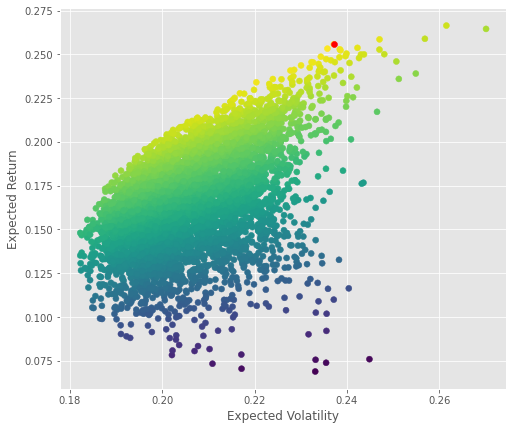

In [168]:
#Plot the value to visualize the output
fig, ax = plt.subplots()
ax.scatter(exp_vols, exp_rtns, c=sharpe_ratios)
ax.scatter(exp_vols[sharpe_ratios.argmax()], exp_rtns[sharpe_ratios.argmax()], c='r')
ax.set_xlabel('Expected Volatility')
ax.set_ylabel('Expected Return')

## 5 h. (2) Portfolio 2:

- AAPL
- AMZN
- GOOG
- MRK
- JNJ

In [169]:
# data_2_portfolio_2 = pd.DataFrame()

In [170]:
# data_2_portfolio_2["AAPL_TECH_Open"] = data["AAPL_TECH_Open"] * data["AAPL_TECH_Volume"]
# data_2_portfolio_2["AMZN_TECH_Open"] = data["AMZN_TECH_Open"] * data["AMZN_TECH_Volume"]
# data_2_portfolio_2["GOOG_TECH_Open"] = data["GOOG_TECH_Open"] * data["GOOG_TECH_Volume"]
# data_2_portfolio_2["JNJ_HP_Open"] = data["JNJ_HP_Open"] * data["JNJ_HP_Volume"]
# data_2_portfolio_2["MRK_HP_Open"] = data["MRK_HP_Open"] * data["MRK_HP_Volume"]

In [171]:
#choosing Portfolio
data_2_portfolio_2 = data_1[['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'JNJ_HP_Close', 'MRK_HP_Close']]

In [172]:
data_2_portfolio_2.head()

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,
2010-01-10,10.090000,153.710007,261.828613,61.750000,36.599998
2010-04-10,9.951428,155.389999,260.199707,61.669998,36.520000
2010-05-10,10.319285,160.869995,268.110046,62.799999,37.020000
2010-06-10,10.328215,155.399994,266.177307,63.209999,37.009998
2010-07-10,10.329286,156.270004,264.015411,63.220001,36.709999


In [173]:
log_returns_portfolio_2 = np.log(data_2_portfolio_2/data_2_portfolio_2.shift())

In [174]:
log_returns_portfolio_2

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN
2010-04-10,-0.013829,0.010870,-0.006241,-0.001296,-0.002188
2010-05-10,0.036298,0.034658,0.029948,0.018158,0.013598
2010-06-10,0.000865,-0.034594,-0.007235,0.006507,-0.000270
2010-07-10,0.000104,0.005583,-0.008155,0.000158,-0.008139
2010-08-10,0.016630,-0.004618,0.011891,0.000158,0.005433
2010-11-10,0.004377,-0.016333,0.004632,0.001106,-0.001356
2010-12-10,0.010709,0.022294,0.004721,-0.000158,-0.005986
2010-10-13,0.005345,-0.008407,0.003522,0.004572,0.014092


In [175]:
#calculating the random weight for portfolio
weight_2 = np.random.random(5)
weight_2 /= weight_2.sum()
weight_2

array([0.04149346, 0.02729089, 0.27140616, 0.43398447, 0.22582502])

In [176]:
#expected return
exp_rtn = np.sum(log_returns_portfolio_2.mean()*weight_2)*252
exp_rtn

0.12204930927085195

In [177]:
#Expected Volitality
exp_vol = np.sqrt(np.dot(weight_2.T, np.dot(log_returns_portfolio_2.cov()*252, weight_2)))
exp_vol

0.16418451942251716

In [178]:
#Sharpe Ratio
sharpe_ratio = exp_rtn / exp_vol

In [179]:
sharpe_ratio

0.7433667297022489

In [180]:
# Monte Carlo Simulation
n = 5000

weights_2 = np.zeros((n, 5))
exp_rtns = np.zeros(n)
exp_vols = np.zeros(n)
sharpe_ratios_2 = np.zeros(n)

for i in range(n):
    weight_2 = np.random.random(5)
    weight_2 /= weight_2.sum()
    weights[i] = weight_2
    
    exp_rtns[i] = np.sum(log_returns_portfolio_2.mean()*weight_2)*252
    exp_vols[i] = np.sqrt(np.dot(weight_2.T, np.dot(log_returns_portfolio_2.cov()*252, weight_2)))
    sharpe_ratios[i] = exp_rtns[i] / exp_vols[i]

In [181]:
#Maximum Sharpe Ration
sharpe_ratios.max()

1.0829243993215658

In [182]:
#Record in which the Sharpe Ratio index is
sharpe_max = sharpe_ratios.argmax()
sharpe_max

2430

### Weights to be used for portfolio

In [183]:
#Maximum Sharpe ratio value of weight combination to get best result
final_weights_2 = np.round(weights[sharpe_max], 3)
final_weights_2.sum()

1.0000000000000002

Text(0, 0.5, 'Expected Return')

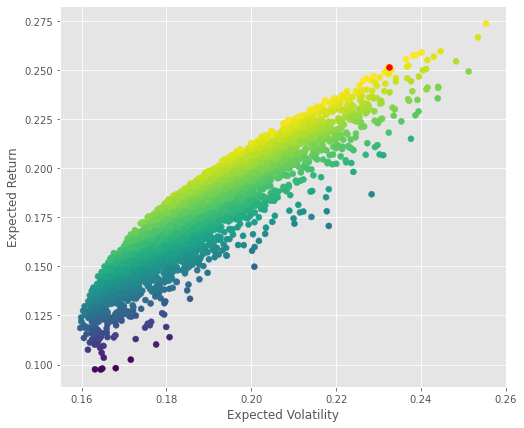

In [184]:
#Plot the value to visualize the output
fig, ax = plt.subplots()
ax.scatter(exp_vols, exp_rtns, c=sharpe_ratios)
ax.scatter(exp_vols[sharpe_ratios.argmax()], exp_rtns[sharpe_ratios.argmax()], c='r')
ax.set_xlabel('Expected Volatility')
ax.set_ylabel('Expected Return')

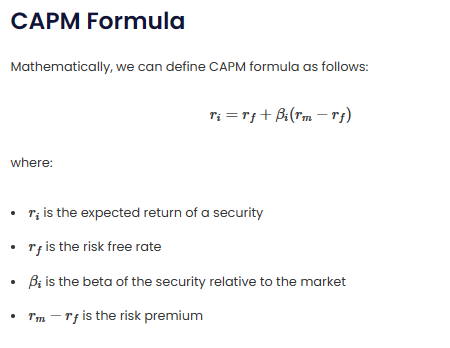

## 6 __Capital Asset Pricing Model (CAPM)__

Relationship between systematic risk and expected return
There are several assumptions behind the CAPM formula that have been shown not to hold in reality.
CAPM formula is still widely used
Formula__

__: Expected return from investment
: Risk free return
: The beta of the investment
: Market risk premium
Risk free return 10 Year Treasury Note__

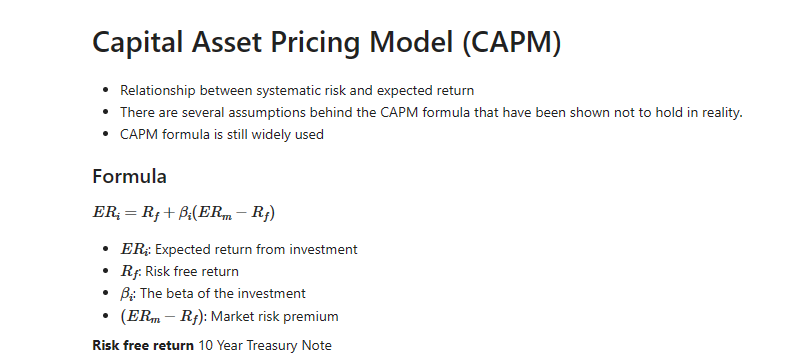

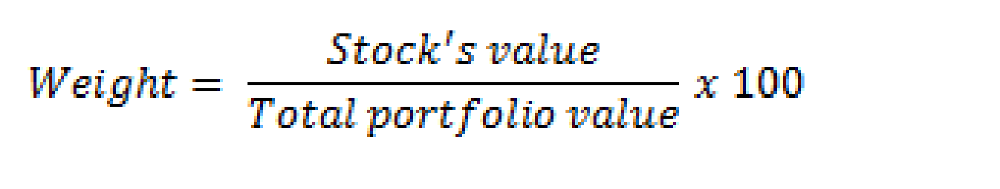

### Finding  using correlations

In [185]:
# df = data_1.copy()
# df[['m_returns']] = SP500[['SP500_Adj Close']]
#df[['m_returns']] = np.log(SP500[['SP500_Adj Close']]/SP500[['SP500_Adj Close']].shift(1))

In [186]:
# df

In [187]:
# (df/df.iloc[0]).plot(figsize=(20,7))

In [188]:
# df_ret = df/df.shift(1)-1

In [189]:
df_ret

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close,m_returns
Date,,,,,,,,,,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-04-10,-0.008035,-0.013734,0.010930,-0.006221,-0.024503,-0.035235,-0.018299,-0.007651,-0.007401,-0.015965,0.004660,-0.001296,-0.002186,-0.008035
2010-05-10,0.020861,0.036965,0.035266,0.030401,0.005971,0.017391,0.012061,0.020468,0.029590,0.042404,0.016621,0.018323,0.013691,0.020861
2010-06-10,-0.000672,0.000865,-0.034003,-0.007209,-0.002251,0.020513,0.000000,0.008491,0.006563,0.012204,0.014829,0.006529,-0.000270,-0.000672
2010-07-10,-0.001647,0.000104,0.005599,-0.008122,-0.046154,0.030151,0.001083,0.001790,0.005396,-0.010484,-0.003372,0.000158,-0.008106,-0.001647
2010-08-10,0.006122,0.016769,-0.004607,0.011962,0.036344,0.000000,-0.018398,0.010257,-0.015653,-0.003002,0.009023,0.000158,0.005448,0.006122
2010-11-10,0.000146,0.004387,-0.016201,0.004643,-0.024279,-0.006504,-0.007718,-0.003013,0.008405,-0.005313,0.011923,0.001107,-0.001355,0.000146
2010-12-10,0.003819,0.010766,0.022545,0.004732,0.006380,0.039280,0.061111,0.019777,0.003154,-0.004630,0.026510,-0.000158,-0.005969,0.003819
2010-10-13,0.007121,0.005359,-0.008372,0.003528,0.004649,0.006299,0.026178,-0.003093,0.010555,0.032379,-0.000717,0.004582,0.014192,0.007121


In [190]:
cov_with_market = df_ret.cov().iloc[0,1]*252
market_var = df_ret['SP500_Close'].var()*252
beta = cov_with_market/market_var
risk_free_return = 0.75
print("Beta: %.4f"%beta)

market_return = ((df_ret['SP500_Close'].mean())*252)*100
market_return

Beta: 1.0633


12.296594451619882

In [191]:
stock_code = ["AAPL_TECH_Close", "AMZN_TECH_Close", "GOOG_TECH_Close", "ALK_AV_Close", "HA_AV_Close", "AAL_AV_Close", "GS_FI_Close", "CS_FI_Close", "DB_FI_Close", "BHC_HP_Close", "JNJ_HP_Close", "MRK_HP_Close"]

In [192]:
stock_code

['AAPL_TECH_Close',
 'AMZN_TECH_Close',
 'GOOG_TECH_Close',
 'ALK_AV_Close',
 'HA_AV_Close',
 'AAL_AV_Close',
 'GS_FI_Close',
 'CS_FI_Close',
 'DB_FI_Close',
 'BHC_HP_Close',
 'JNJ_HP_Close',
 'MRK_HP_Close']

In [193]:
df_ret['AAPL_TECH_Close'].mean()*252

0.2841638554027002

In [194]:
df_ret['AAPL_TECH_Close'].std()*(252**0.5)

0.2812730197451304

In [195]:
df_ret['AAPL_TECH_Close'].mean()*252/(df_ret['AAPL_TECH_Close'].std()*(252**0.5))


1.0102776855746394

In [196]:
for i in stock_code:
    sharp = df_ret[i].mean()*252/(df_ret[i].std()*(252**0.5))
    print(i, "Sharp: %.4f"%sharp)

AAPL_TECH_Close Sharp: 1.0103
AMZN_TECH_Close Sharp: 1.1155
GOOG_TECH_Close Sharp: 0.7968
ALK_AV_Close Sharp: 0.4780
HA_AV_Close Sharp: 0.4029
AAL_AV_Close Sharp: 0.3089
GS_FI_Close Sharp: 0.2516
CS_FI_Close Sharp: -0.2323
DB_FI_Close Sharp: -0.2295
BHC_HP_Close Sharp: 0.2064
JNJ_HP_Close Sharp: 0.5982
MRK_HP_Close Sharp: 0.4991


It is expected that a good portfolio will have a high Sharpe ratio after diversification. Hence following securities can be considered with high sharp ratio.

- AAPL_TECH_Close Sharp: 1.0103
- AMZN_TECH_Close Sharp: 1.1155
- GOOG_TECH_Close Sharp: 0.7968
- JNJ_HP_Close Sharp: 0.5982

In [197]:
df_ret = df/df.shift(1)-1
df_ret = df_ret[1:]

In [198]:
from sklearn.linear_model import LinearRegression

In [199]:
model = LinearRegression()
x_train = df_ret['SP500_Close'].values.reshape(-1,1)
for i in stock_code:
    y_train = df_ret[i].values.reshape(-1,1)
    model.fit(x_train, y_train)
    print("                       ")
    print("******************######################******************")
    print("                       ",i)
    print("******************######################******************")
    print("Alpha: %.5f%%"%(model.intercept_*100))
    print("Beta: %.5f"%model.coef_)
    beta = model.coef_
    expected_return = risk_free_return + beta*(market_return-risk_free_return)
    print("risk_free_return : ",risk_free_return)
    print("Market_return : ",market_return)
    print("Expected Return: ", expected_return)
    #print("%: ",((df["m_returns"].mean()*12))/expected_return)
    

                       
******************######################******************
                        AAPL_TECH_Close
******************######################******************
Alpha: 0.06088%
Beta: 1.06335
risk_free_return :  0.75
Market_return :  12.296594451619882
Expected Return:  [[13.02806057]]
                       
******************######################******************
                        AMZN_TECH_Close
******************######################******************
Alpha: 0.09102%
Beta: 0.99880
risk_free_return :  0.75
Market_return :  12.296594451619882
Expected Return:  [[12.28276536]]
                       
******************######################******************
                        GOOG_TECH_Close
******************######################******************
Alpha: 0.03231%
Beta: 1.01334
risk_free_return :  0.75
Market_return :  12.296594451619882
Expected Return:  [[12.45060328]]
                       
******************######################***************

Finding  and  using regression
The modified CAPM model is:

 
A Beta positive  means the stock is doing better than the market, and vice versa

******************######################******************
                        AAPL_TECH_Close
******************######################******************

- Alpha: 0.06088%
- Beta: 1.06335
- risk_free_return :  0.75
- Market_return :  12.296594451619882
- Expected Return:  [[13.02806057]]
                       
******************######################******************
                        AMZN_TECH_Close
******************######################******************

- Alpha: 0.09102%
- Beta: 0.99880
- risk_free_return :  0.75
- Market_return :  12.296594451619882
- Expected Return:  [[12.28276536]]
                       
******************######################******************
                        GOOG_TECH_Close
******************######################******************

- Alpha: 0.03231%
- Beta: 1.01334
- risk_free_return :  0.75
- Market_return :  12.296594451619882
- Expected Return:  [[12.45060328]]
                                              
******************######################******************
                        GS_FI_Close
******************######################******************

- Alpha: -0.03445%
- Beta: 1.30129
- risk_free_return :  0.75
- Market_return :  12.296594451619882
- Expected Return:  [[15.77541776]]
                                           
******************######################******************
                        JNJ_HP_Close
******************######################******************

- Alpha: 0.00856%
- Beta: 0.66223
- risk_free_return :  0.75
- Market_return :  12.296594451619882
- Expected Return:  [[8.3965357]]
                       
******************######################******************
                        MRK_HP_Close
******************######################******************

- Alpha: 0.00524%
- Beta: 0.73348
- risk_free_return :  0.75
- Market_return :  12.296594451619882
- Expected Return:  [[9.21914399]]

With this following securities form portfolio.
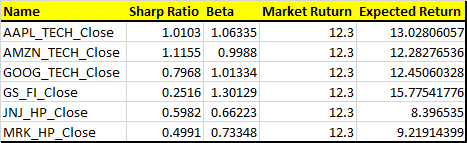

# Part V: Machine Learning

### Part V: a. Linear Regression - Portfolio 1

- Attempts to establish how X causes Y

#### Correlation vs Linear Regression

#### Similarities

- Quantify the direction and strength of the relationship

#### Differences

- Correlation is a single statistic
- Linear regression produces an equation

In [200]:
data_1.head()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,,,,,,,,,
2010-01-10,1146.239990,10.090000,153.710007,261.828613,12.4475,5.96,9.29,147.699997,42.226563,52.595421,25.750000,61.750000,36.599998
2010-04-10,1137.030029,9.951428,155.389999,260.199707,12.1425,5.75,9.12,146.570007,41.914063,51.755726,25.870001,61.669998,36.520000
2010-05-10,1160.750000,10.319285,160.869995,268.110046,12.2150,5.85,9.23,149.570007,43.154297,53.950382,26.299999,62.799999,37.020000
2010-06-10,1159.969971,10.328215,155.399994,266.177307,12.1875,5.97,9.23,150.839996,43.437500,54.608780,26.690001,63.209999,37.009998
2010-07-10,1158.060059,10.329286,156.270004,264.015411,11.6250,6.15,9.24,151.110001,43.671875,54.036259,26.600000,63.220001,36.709999


In [201]:
data_portfolio_1 = data_1[['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'GS_FI_Close', 'MRK_HP_Close', 'SP500_Close']]

In [202]:
log_returns_lr_1 = np.log(data_portfolio_1/data_portfolio_1.shift())

In [203]:
log_returns_lr_1.head()

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,GS_FI_Close,MRK_HP_Close,SP500_Close
Date,,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN,NaN
2010-04-10,-0.013829,0.010870,-0.006241,-0.007680,-0.002188,-0.008067
2010-05-10,0.036298,0.034658,0.029948,0.020261,0.013598,0.020647
2010-06-10,0.000865,-0.034594,-0.007235,0.008455,-0.000270,-0.000672
2010-07-10,0.000104,0.005583,-0.008155,0.001788,-0.008139,-0.001648


In [204]:
def linear_regression_1(ticker_a, ticker_b, label):
    X = log_returns_lr_1[ticker_a].iloc[1:].to_numpy().reshape(-1, 1)
    Y = log_returns_lr_1[ticker_b].iloc[1:].to_numpy().reshape(-1, 1)

    lin_regr = LinearRegression()
    lin_regr.fit(X, Y)

    Y_pred = lin_regr.predict(X)

    alpha = lin_regr.intercept_[0]
    beta = lin_regr.coef_[0, 0]

    fig, ax = plt.subplots()
    ax.set_title(label + ": Alpha: " + str(round(alpha, 5)) + ", Beta: " + str(round(beta, 3)))
    ax.scatter(X, Y)
    ax.plot(X, Y_pred, c='b')
    plt.show()

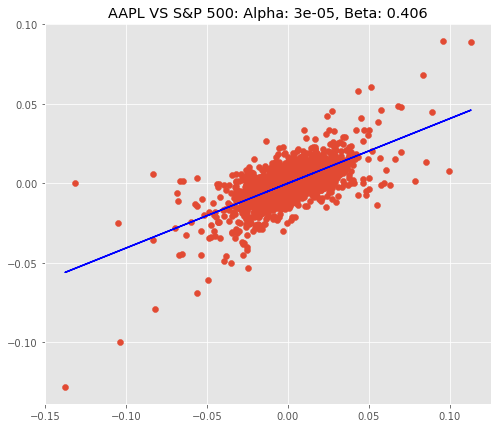

In [205]:
linear_regression_1("AAPL_TECH_Close", "SP500_Close", "AAPL VS S&P 500")

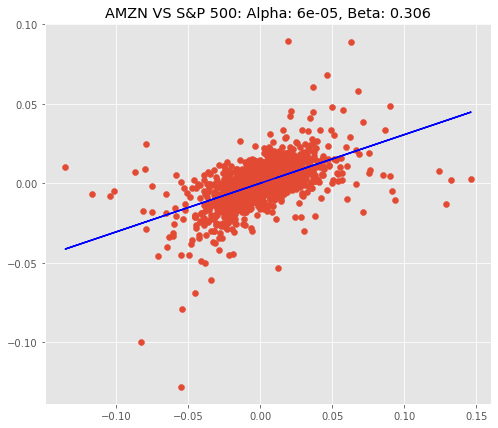

In [206]:
linear_regression_1("AMZN_TECH_Close", "SP500_Close", "AMZN VS S&P 500")

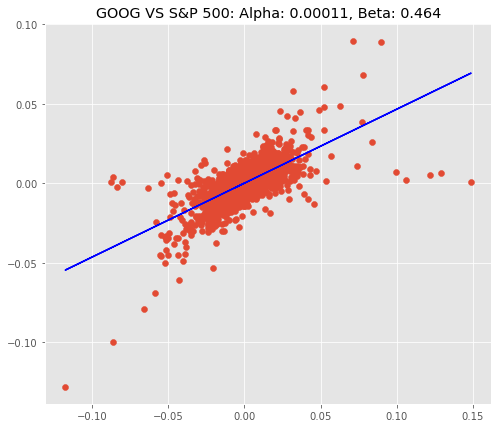

In [207]:
linear_regression_1("GOOG_TECH_Close", "SP500_Close", "GOOG VS S&P 500")

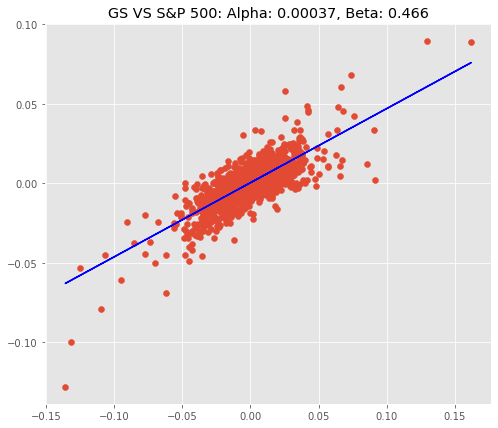

In [208]:
linear_regression_1("GS_FI_Close", "SP500_Close", "GS VS S&P 500")

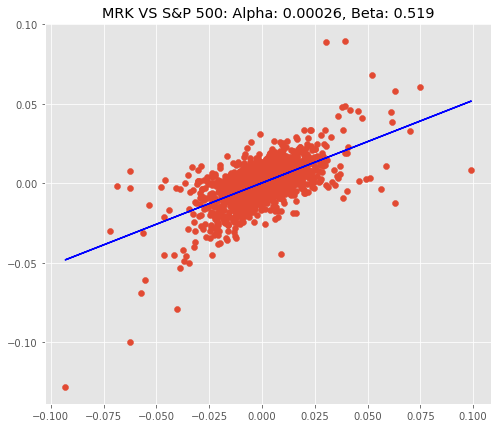

In [209]:
linear_regression_1("MRK_HP_Close", "SP500_Close", "MRK VS S&P 500")

### Part V: b. Linear Regression - Portfolio 2

- Attempts to establish how X causes Y

#### Correlation vs Linear Regression

#### Similarities

- Quantify the direction and strength of the relationship

#### Differences

- Correlation is a single statistic
- Linear regression produces an equation

In [210]:
data_1.head()

,SP500_Close,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,ALK_AV_Close,HA_AV_Close,AAL_AV_Close,GS_FI_Close,CS_FI_Close,DB_FI_Close,BHC_HP_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,,,,,,,,,
2010-01-10,1146.239990,10.090000,153.710007,261.828613,12.4475,5.96,9.29,147.699997,42.226563,52.595421,25.750000,61.750000,36.599998
2010-04-10,1137.030029,9.951428,155.389999,260.199707,12.1425,5.75,9.12,146.570007,41.914063,51.755726,25.870001,61.669998,36.520000
2010-05-10,1160.750000,10.319285,160.869995,268.110046,12.2150,5.85,9.23,149.570007,43.154297,53.950382,26.299999,62.799999,37.020000
2010-06-10,1159.969971,10.328215,155.399994,266.177307,12.1875,5.97,9.23,150.839996,43.437500,54.608780,26.690001,63.209999,37.009998
2010-07-10,1158.060059,10.329286,156.270004,264.015411,11.6250,6.15,9.24,151.110001,43.671875,54.036259,26.600000,63.220001,36.709999


In [211]:
data_portfolio_2 = data_1[['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'JNJ_HP_Close', 'MRK_HP_Close', 'SP500_Close']]

In [212]:
log_returns_lr_2 = np.log(data_portfolio_2/data_portfolio_2.shift())

In [213]:
log_returns_lr_2.head()

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,JNJ_HP_Close,MRK_HP_Close,SP500_Close
Date,,,,,,
2010-01-10,NaN,NaN,NaN,NaN,NaN,NaN
2010-04-10,-0.013829,0.010870,-0.006241,-0.001296,-0.002188,-0.008067
2010-05-10,0.036298,0.034658,0.029948,0.018158,0.013598,0.020647
2010-06-10,0.000865,-0.034594,-0.007235,0.006507,-0.000270,-0.000672
2010-07-10,0.000104,0.005583,-0.008155,0.000158,-0.008139,-0.001648


In [214]:
def linear_regression_2(ticker_a, ticker_b, label):
    X = log_returns_lr_2[ticker_a].iloc[1:].to_numpy().reshape(-1, 1)
    Y = log_returns_lr_2[ticker_b].iloc[1:].to_numpy().reshape(-1, 1)

    lin_regr = LinearRegression()
    lin_regr.fit(X, Y)

    Y_pred = lin_regr.predict(X)

    alpha = lin_regr.intercept_[0]
    beta = lin_regr.coef_[0, 0]

    fig, ax = plt.subplots()
    ax.set_title(label + ": Alpha: " + str(round(alpha, 5)) + ", Beta: " + str(round(beta, 3)))
    ax.scatter(X, Y)
    ax.plot(X, Y_pred, c='b')
    plt.show()

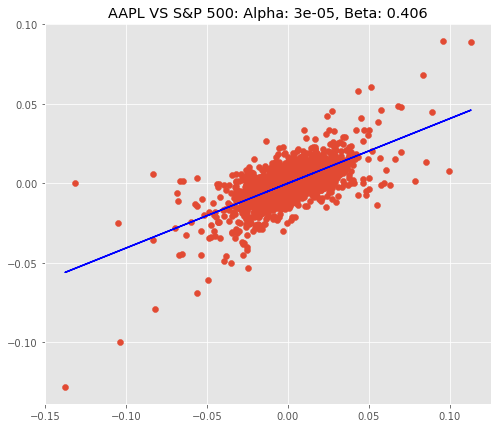

In [215]:
linear_regression_2("AAPL_TECH_Close", "SP500_Close", "AAPL VS S&P 500")

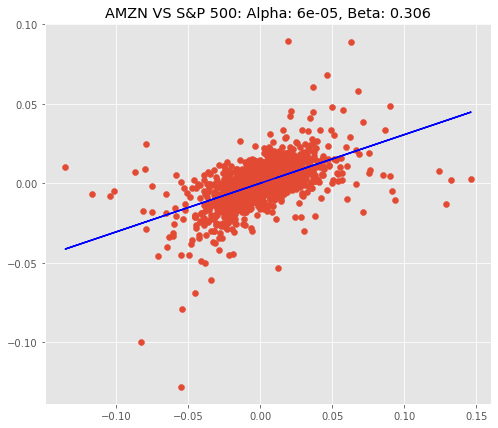

In [216]:
linear_regression_2("AMZN_TECH_Close", "SP500_Close", "AMZN VS S&P 500")

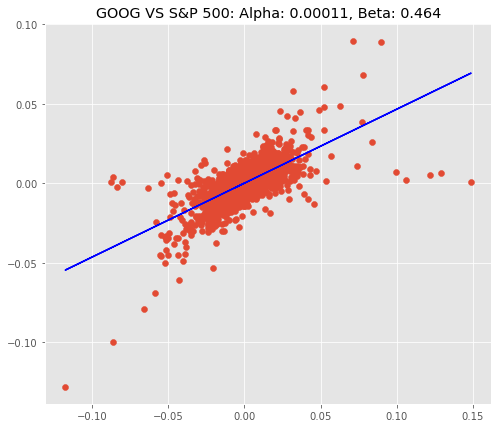

In [217]:
linear_regression_2("GOOG_TECH_Close", "SP500_Close", "GOOG VS S&P 500")

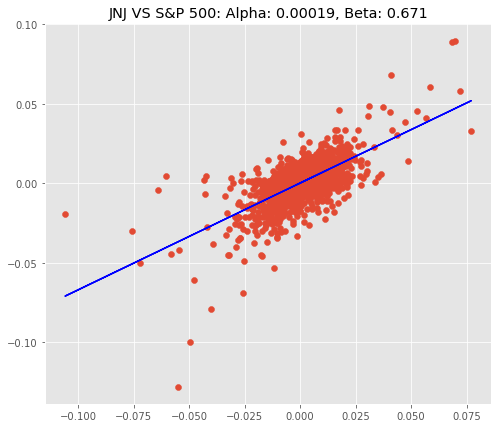

In [218]:
linear_regression_2("JNJ_HP_Close", "SP500_Close", "JNJ VS S&P 500")

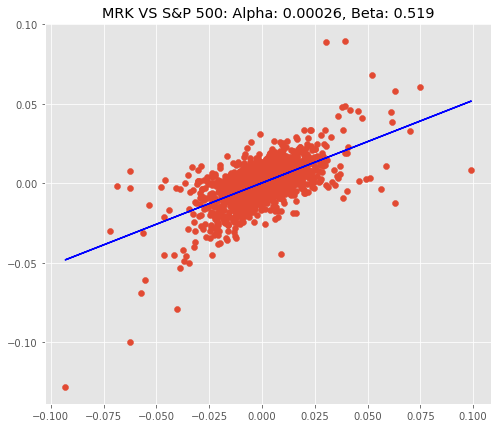

In [219]:
linear_regression_2("MRK_HP_Close", "SP500_Close", "MRK VS S&P 500")

### Part V: c. Stock Price Prediction - Validation

Based on the above analysis, we form the following securities to form portfolio. 
list of Securities as follows:
1. AAPL
2. AMZN
3. GOOG
4. GS
5. MRK
With the above we take S&P 500 for check the market.

### Part V: c. (1) Time-Series - S&P500

##### i. Input Data selection

In [220]:
##Data after feature selection
AAPL_ml_df = data_1.drop(axis=1,labels=['SP500_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close', 'MRK_HP_Close'])
SP500_ml_df = data_1.drop(axis=1,labels=['AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close', 'MRK_HP_Close'])
AMZN_ml_df = data_1.drop(axis=1,labels=['SP500_Close', 'AAPL_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close', 'MRK_HP_Close'])
GOOG_ml_df = data_1.drop(axis=1,labels=['SP500_Close', 'AAPL_TECH_Close', 'AMZN_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close', 'MRK_HP_Close'])
GS_ml_df = data_1.drop(axis=1,labels=['SP500_Close', 'AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close', 'MRK_HP_Close'])
JNJ_ml_df = data_1.drop(axis=1,labels=['SP500_Close', 'AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'GS_FI_Close', 'MRK_HP_Close'])
MRK_ml_df = data_1.drop(axis=1,labels=['SP500_Close', 'AAPL_TECH_Close', 'AMZN_TECH_Close', 'GOOG_TECH_Close', 'ALK_AV_Close', 'HA_AV_Close', 'AAL_AV_Close', 'GS_FI_Close', 'CS_FI_Close', 'DB_FI_Close', 'BHC_HP_Close', 'JNJ_HP_Close'])

In [221]:
print(AAPL_ml_df.head())
print(SP500_ml_df.head())
print(AMZN_ml_df.head())
print(GOOG_ml_df.head())
print(GS_ml_df.head())
print(MRK_ml_df.head())
print(JNJ_ml_df.head())

            AAPL_TECH_Close
Date                       
2010-01-10  10.090000      
2010-04-10  9.951428       
2010-05-10  10.319285      
2010-06-10  10.328215      
2010-07-10  10.329286      
            SP500_Close
Date                   
2010-01-10  1146.239990
2010-04-10  1137.030029
2010-05-10  1160.750000
2010-06-10  1159.969971
2010-07-10  1158.060059
            AMZN_TECH_Close
Date                       
2010-01-10  153.710007     
2010-04-10  155.389999     
2010-05-10  160.869995     
2010-06-10  155.399994     
2010-07-10  156.270004     
            GOOG_TECH_Close
Date                       
2010-01-10  261.828613     
2010-04-10  260.199707     
2010-05-10  268.110046     
2010-06-10  266.177307     
2010-07-10  264.015411     
            GS_FI_Close
Date                   
2010-01-10  147.699997 
2010-04-10  146.570007 
2010-05-10  149.570007 
2010-06-10  150.839996 
2010-07-10  151.110001 
            MRK_HP_Close
Date                    
2010-01-10  36.599998   
2

In [222]:
SP500_ml_df.shape
AAPL_ml_df.shape
AMZN_ml_df.shape
GOOG_ml_df.shape
GS_ml_df.shape
MRK_ml_df.shape
JNJ_ml_df.shape

(2517, 1)

##### ii. Resample from daily to monthly

In [223]:
SP500_ml_df_ts = SP500_ml_df['SP500_Close'].resample('M').mean()
AAPL_ml_df_ts = AAPL_ml_df['AAPL_TECH_Close'].resample('M').mean()
AMZN_ml_df_ts = AMZN_ml_df['AMZN_TECH_Close'].resample('M').mean()
GOOG_ml_df_ts = GOOG_ml_df['GOOG_TECH_Close'].resample('M').mean()
GS_ml_df_ts = GS_ml_df['GS_FI_Close'].resample('M').mean()
MRK_ml_df_ts = MRK_ml_df['MRK_HP_Close'].resample('M').mean()
JNJ_ml_df_ts = JNJ_ml_df['JNJ_HP_Close'].resample('M').mean()

In [224]:
px.line(SP500_ml_df_ts)

In [225]:
px.line(AMZN_ml_df_ts)

In [226]:
px.line(GOOG_ml_df_ts)

In [227]:
px.line(GS_ml_df_ts)

In [228]:
px.line(MRK_ml_df_ts)

In [229]:
px.line(AAPL_ml_df_ts)

In [230]:
px.line(JNJ_ml_df_ts)

##### iii. Stationarity Check - SP500

In [231]:
#Determing rolling Statistics
rolmean = SP500_ml_df_ts.rolling(window=12).mean()
rolstd = SP500_ml_df_ts.rolling(window=12).std()
print(rolmean, rolstd)

Date
2010-01-31   NaN         
2010-02-28   NaN         
2010-03-31   NaN         
2010-04-30   NaN         
2010-05-31   NaN         
2010-06-30   NaN         
2010-07-31   NaN         
2010-08-31   NaN         
2010-09-30   NaN         
2010-10-31   NaN         
2010-11-30   NaN         
2010-12-31    1200.016458
2011-01-31    1208.969397
2011-02-28    1216.918749
2011-03-31    1223.445305
2011-04-30    1234.174925
2011-05-31    1243.735628
2011-06-30    1251.052750
2011-07-31    1260.163309
2011-08-31    1260.876490
2011-09-30    1259.299406
2011-10-31    1264.126105
2011-11-30    1268.329159
2011-12-31    1268.610330
2012-01-31    1272.674820
2012-02-29    1278.372428
2012-03-31    1287.203338
2012-04-30    1293.127770
2012-05-31    1295.971614
2012-06-30    1301.732372
2012-07-31    1307.504688
2012-08-31    1322.928135
2012-09-30    1340.683946
2012-10-31    1354.126539
2012-11-30    1365.968483
2012-12-31    1379.199594
2013-01-31    1396.236492
2013-02-28    1411.991153
2013-03

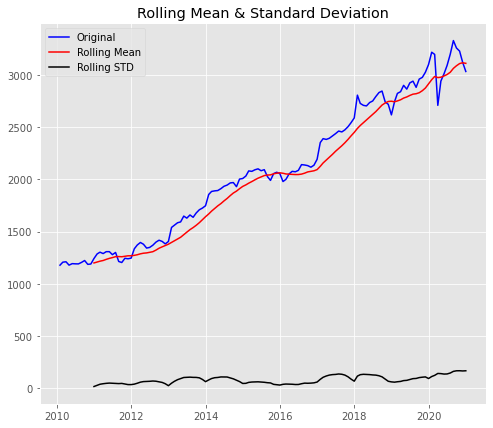

In [232]:
#Plot rolling statistics
orig = plt.plot(SP500_ml_df_ts, color='blue', label='Original')
mean = plt.plot(rolmean, color='red', label='Rolling Mean')
std = plt.plot(rolstd, color='black', label='Rolling STD')

plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)

In [233]:
SP500_ml_df_ts

Date
2010-01-31    1178.896647
2010-02-28    1207.549988
2010-03-31    1211.334961
2010-04-30    1179.045044
2010-05-31    1193.299988
2010-06-30    1191.544983
2010-07-31    1190.905029
2010-08-31    1205.560018
2010-09-30    1223.200012
2010-10-31    1186.671997
2010-11-30    1189.583834
2010-12-31    1242.604996
2011-01-31    1286.331909
2011-02-28    1302.942213
2011-03-31    1289.653631
2011-04-30    1307.800494
2011-05-31    1308.028417
2011-06-30    1279.350453
2011-07-31    1300.231737
2011-08-31    1214.118186
2011-09-30    1204.275008
2011-10-31    1244.592378
2011-11-30    1240.020484
2011-12-31    1245.979051
2012-01-31    1335.105790
2012-02-29    1371.313507
2012-03-31    1395.624551
2012-04-30    1378.893683
2012-05-31    1342.154541
2012-06-30    1348.479542
2012-07-31    1369.499535
2012-08-31    1399.199546
2012-09-30    1417.344750
2012-10-31    1405.903491
2012-11-30    1382.123814
2012-12-31    1404.752377
2013-01-31    1539.548567
2013-02-28    1560.369439
2013-03

In [234]:
#perform Dickey-Fuller test
dftest = adfuller(SP500_ml_df_ts, autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'P-Value', '#Lags Used', 'Number of Observations Used'])
for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value

print(dfoutput)

Test Statistic                 0.388786  
P-Value                        0.981071  
#Lags Used                     5.000000  
Number of Observations Used    126.000000
Critical Value (1%)           -3.483346  
Critical Value (5%)           -2.884766  
Critical Value (10%)          -2.579156  
dtype: float64


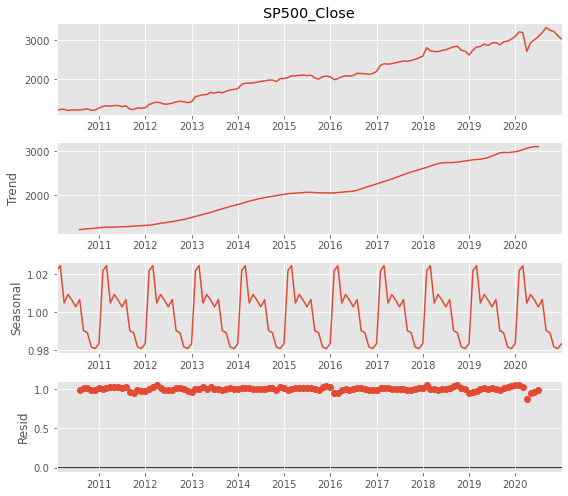

In [235]:
decomposition = sm.tsa.seasonal_decompose(SP500_ml_df_ts, model='multiplicative')
fig = decomposition.plot()
plt.show()

In [236]:
adftest = adfuller(SP500_ml_df_ts)
print('P Value of adfuller test is:', adftest[1])

P Value of adfuller test is: 0.9810706992045001


In [237]:
def Stationarity(tick):
    #Determing rolling Statistics
    rolmean = tick.rolling(window=12).mean()
    rolstd = tick.rolling(window=12).std()
    print(rolmean.head(), rolstd.head())
    
    #Plot rolling statistics
    orig = plt.plot(tick, color='blue', label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label='Rolling STD')
    
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)

    #perform Dickey-Fuller test
    dftest = adfuller(tick, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'P-Value', '#Lags Used', 'Number of Observations Used'])
    for key, value in dftest[4].items():
        dfoutput['Critical Value (%s){tick}'%key] = value
    print(dfoutput)

    decomposition = sm.tsa.seasonal_decompose(tick, model='multiplicative',freq=12, extrapolate_trend = 12)
    fig = decomposition.plot()
    plt.show()
    
    fig,(ax1,ax2) = plt.subplots(2,figsize=(12,12))
    acf = plot_acf(tick,lags=90,ax=ax1)
    ax1.set_title('AutoCorrelation Long Term')
    acf = plot_acf(tick,lags=36,ax=ax2)
    ax2.set_title('AutoCorrelation Short Term')
    ax1.set_ylabel('Correlation')
    ax1.set_xlabel('Lags')
    ax2.set_ylabel('Correlation')
    ax2.set_xlabel('Lags')
    
    fig,(ax1,ax2) = plt.subplots(2,figsize=(10,10))
    pacf = plot_pacf(tick,lags=65,ax=ax1)
    ax1.set_title('Partial AutoCorrelation Long Term')
    pacf = plot_pacf(tick,lags=30,ax=ax2)
    ax2.set_title('Partial AutoCorrelation Short Term')
    ax1.set_ylabel('Correlation')
    ax1.set_xlabel('Lags')
    ax2.set_ylabel('Correlation')
    ax2.set_xlabel('Lags')
    plt.tight_layout(pad=1)

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: SP500_Close, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: SP500_Close, dtype: float64


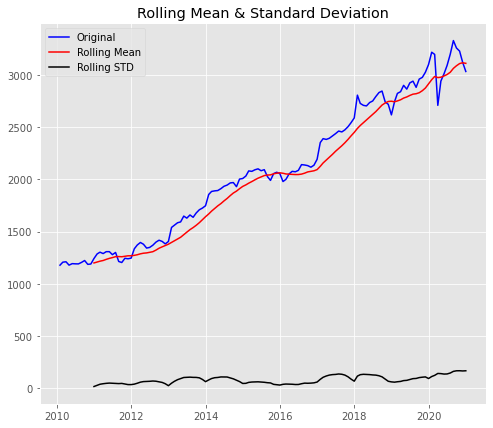

Test Statistic                 0.388786  
P-Value                        0.981071  
#Lags Used                     5.000000  
Number of Observations Used    126.000000
Critical Value (1%){tick}     -3.483346  
Critical Value (5%){tick}     -2.884766  
Critical Value (10%){tick}    -2.579156  
dtype: float64


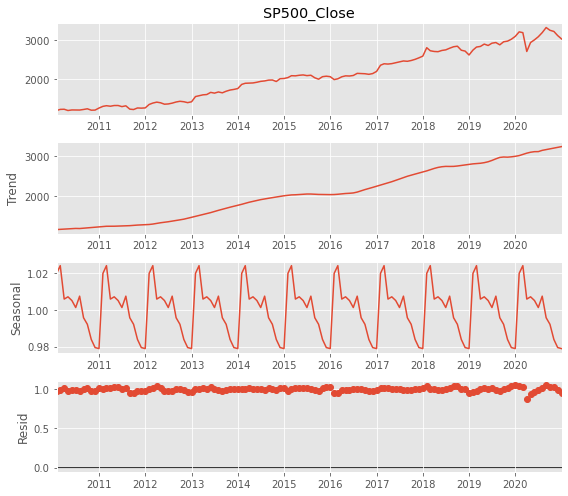

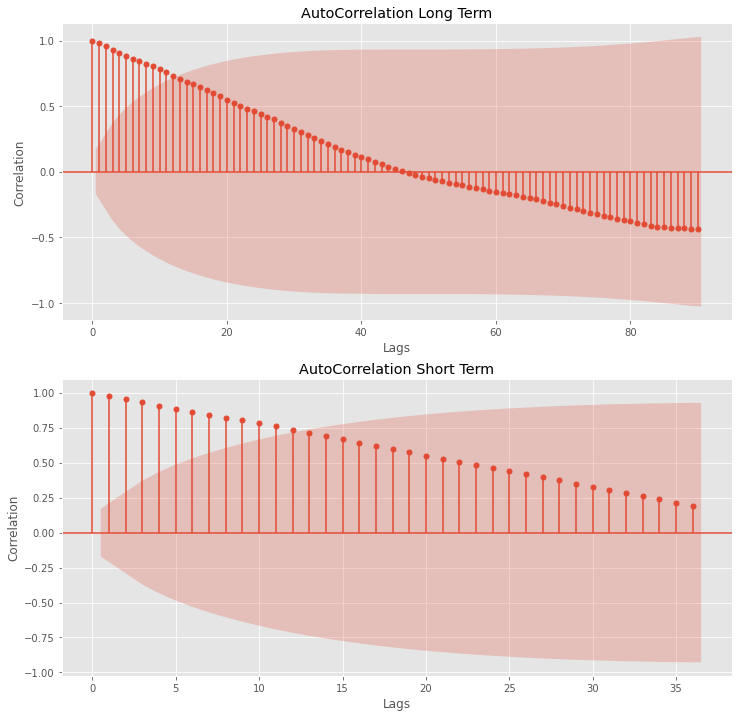

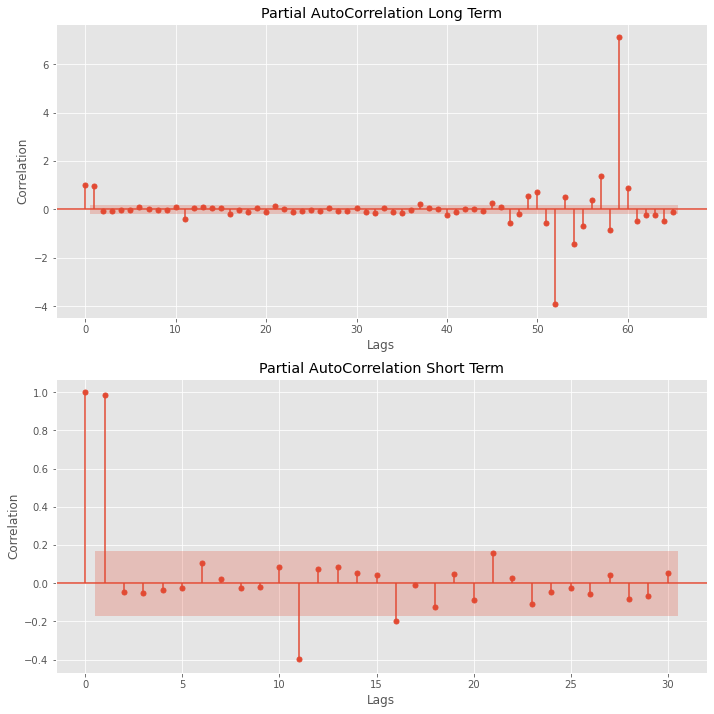

In [238]:
Stationarity(SP500_ml_df_ts)

##### iv. Train Test Split - SP500

In [239]:
len(SP500_ml_df_ts)

132

In [240]:
m = int(len(SP500_ml_df_ts) * 0.8)
train = SP500_ml_df_ts[:m]
test = SP500_ml_df_ts[m:]

In [241]:
test.shape

(27,)

In [242]:
def traintest(tick):
    m = int(len(tick) * 0.8)
    train = tick[:m]
    test = tick[m:]
    print(train.head(), test.head())

In [243]:
traintest(SP500_ml_df_ts)

Date
2010-01-31    1178.896647
2010-02-28    1207.549988
2010-03-31    1211.334961
2010-04-30    1179.045044
2010-05-31    1193.299988
Freq: M, Name: SP500_Close, dtype: float64 Date
2018-10-31    2738.802374
2018-11-30    2716.630941
2018-12-31    2615.524547
2019-01-31    2742.360014
2019-02-28    2820.810004
Freq: M, Name: SP500_Close, dtype: float64


In [244]:
train.shape, test.shape

((105,), (27,))

# Build ARIMA & SARIMA Model

### ARIMA Model Building:
__ARIMA model has 3 components:__

- 1. AR - p
- 2. MA - q
- 3. Integrated - d

SARIMA contians with Seational in additional parameter

##### v. Hyperparameters of ARIMA Model = p d q - SP500

In [245]:
p=range(0,8)
q=range(0,8)
d=range(0,2)

In [246]:
pdq_comb = list(itertools.product(p,d,q))

In [247]:
len(pdq_comb)

128

In [248]:
rmse=[]
order1=[]

In [249]:
for pdq in pdq_comb:
    try:
        model=ARIMA(train, order=pdq).fit()
        pred=model.predict(start=len(train), end=len(SP500_ml_df_ts)-1)
        error=np.sqrt(mean_squared_error(test,pred))
        order1.append(pdq)
        rmse.append(error)
    except:
        continue

In [250]:
result=pd.DataFrame(index=order1, data=rmse, columns=['RMSE'])
result.sort_values(['RMSE']).head()

,RMSE
"(3, 0, 4)",129.472542
"(5, 1, 4)",132.740079
"(6, 0, 5)",133.424449
"(5, 1, 5)",133.623081
"(6, 1, 4)",135.930084


In [251]:
def hyperpar_arima(tick):
    p=range(0,5)
    q=range(0,5)
    d=range(0,2)

    pdq_comb = list(itertools.product(p,d,q))

    len(pdq_comb)

    rmse=[]
    order1=[]

    for pdq in pdq_comb:
        try:
            model=ARIMA(train, order=pdq).fit()
            pred=model.predict(start=len(train), end=len(SP500_ml_df_ts)-1)
            error=np.sqrt(mean_squared_error(test,pred))
            order1.append(pdq)
            rmse.append(error)
        except:
            continue

    result=pd.DataFrame(index=order1, data=rmse, columns=['RMSE'])
    print(result.sort_values(['RMSE']).head())
    

In [252]:
hyperpar_arima(SP500_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


In [253]:
def hyperpar_sarima(tick):
    p = d = q = range(0, 3)
    pdq_comb = list(itertools.product(p, d, q))
    seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
    list_param = []
    list_param_seasonal=[]
    list_results_aic=[]
    z = pd.DataFrame()

    for param in pdq_comb:
        for param_seasonal in seasonal_pdq:
            try:
                model = sm.tsa.statespace.SARIMAX(train,
                                                order=param,
                                                seasonal_order=param_seasonal,
                                                enforce_stationarity=False,
                                                enforce_invertibility=False)

                results = model.fit()

                print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
                
                list_param.append(param)
                list_param_seasonal.append(param_seasonal)
                list_results_aic.append(results.aic)
                #z = pd.DataFrame([list_param, list_param_seasonal, list_results_aic], axis=1)
            except:
                continue

In [254]:
hyperpar_sarima(SP500_ml_df_ts)

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1868.6144257394271
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1562.1061367768339
ARIMA(0, 0, 0)x(0, 0, 2, 12)12 - AIC:1303.2162073352356
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1267.9377608437358
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1074.4740714815389
ARIMA(0, 0, 0)x(0, 1, 2, 12)12 - AIC:2784.9089122399787
ARIMA(0, 0, 0)x(0, 2, 0, 12)12 - AIC:1059.7786023581716
ARIMA(0, 0, 0)x(0, 2, 1, 12)12 - AIC:890.3943375212127
ARIMA(0, 0, 0)x(0, 2, 2, 12)12 - AIC:2022.0142724044158
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1163.1007267513435
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1126.5463525151317
ARIMA(0, 0, 0)x(1, 0, 2, 12)12 - AIC:978.4175387390158
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1071.4084954695531
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1036.9472036597654
ARIMA(0, 0, 0)x(1, 1, 2, 12)12 - AIC:3437.2993955573775
ARIMA(0, 0, 0)x(1, 2, 0, 12)12 - AIC:920.7823685285176
ARIMA(0, 0, 0)x(1, 2, 1, 12)12 - AIC:892.1122958423932
ARIMA(0, 0, 0)x(1, 2, 2, 12)12 - AIC:729.14382484712

ARIMA(0, 1, 2)x(1, 1, 2, 12)12 - AIC:2744.508081827145
ARIMA(0, 1, 2)x(1, 2, 0, 12)12 - AIC:759.9070731601412
ARIMA(0, 1, 2)x(1, 2, 1, 12)12 - AIC:719.9312519931284
ARIMA(0, 1, 2)x(1, 2, 2, 12)12 - AIC:1964.5780854140007
ARIMA(0, 1, 2)x(2, 0, 0, 12)12 - AIC:842.6096224141447
ARIMA(0, 1, 2)x(2, 0, 1, 12)12 - AIC:843.1190163912074
ARIMA(0, 1, 2)x(2, 0, 2, 12)12 - AIC:806.2387060805119
ARIMA(0, 1, 2)x(2, 1, 0, 12)12 - AIC:726.9478226687287
ARIMA(0, 1, 2)x(2, 1, 1, 12)12 - AIC:715.2312668097325
ARIMA(0, 1, 2)x(2, 1, 2, 12)12 - AIC:2740.356172611486
ARIMA(0, 1, 2)x(2, 2, 0, 12)12 - AIC:633.4404212289846
ARIMA(0, 1, 2)x(2, 2, 1, 12)12 - AIC:624.2709208831823
ARIMA(0, 1, 2)x(2, 2, 2, 12)12 - AIC:1964.6155778374691
ARIMA(0, 2, 0)x(0, 0, 0, 12)12 - AIC:1118.5426677772427
ARIMA(0, 2, 0)x(0, 0, 1, 12)12 - AIC:993.5893876616781
ARIMA(0, 2, 0)x(0, 0, 2, 12)12 - AIC:864.8424138784623
ARIMA(0, 2, 0)x(0, 1, 0, 12)12 - AIC:1024.9944421113214
ARIMA(0, 2, 0)x(0, 1, 1, 12)12 - AIC:860.5445857796142
ARIMA(

ARIMA(1, 0, 2)x(0, 0, 1, 12)12 - AIC:956.0822745294189
ARIMA(1, 0, 2)x(0, 0, 2, 12)12 - AIC:823.7964441089135
ARIMA(1, 0, 2)x(0, 1, 0, 12)12 - AIC:967.5846777567259
ARIMA(1, 0, 2)x(0, 1, 1, 12)12 - AIC:811.6880641230873
ARIMA(1, 0, 2)x(0, 1, 2, 12)12 - AIC:2599.4858554933367
ARIMA(1, 0, 2)x(0, 2, 0, 12)12 - AIC:917.61008212842
ARIMA(1, 0, 2)x(0, 2, 1, 12)12 - AIC:734.015449217674
ARIMA(1, 0, 2)x(0, 2, 2, 12)12 - AIC:1926.3688783443865
ARIMA(1, 0, 2)x(1, 0, 0, 12)12 - AIC:957.2810466844339
ARIMA(1, 0, 2)x(1, 0, 1, 12)12 - AIC:935.1303001414161
ARIMA(1, 0, 2)x(1, 0, 2, 12)12 - AIC:816.3616945932162
ARIMA(1, 0, 2)x(1, 1, 0, 12)12 - AIC:850.7618027040196
ARIMA(1, 0, 2)x(1, 1, 1, 12)12 - AIC:813.6184391688918
ARIMA(1, 0, 2)x(1, 1, 2, 12)12 - AIC:2696.701554161309
ARIMA(1, 0, 2)x(1, 2, 0, 12)12 - AIC:760.5607191543007
ARIMA(1, 0, 2)x(1, 2, 1, 12)12 - AIC:732.3950981918026
ARIMA(1, 0, 2)x(1, 2, 2, 12)12 - AIC:600.6010156568584
ARIMA(1, 0, 2)x(2, 0, 0, 12)12 - AIC:836.3633493288605
ARIMA(1, 0,

ARIMA(1, 2, 1)x(1, 2, 0, 12)12 - AIC:743.6574842016101
ARIMA(1, 2, 1)x(1, 2, 1, 12)12 - AIC:725.983798840314
ARIMA(1, 2, 1)x(1, 2, 2, 12)12 - AIC:1988.5146339174426
ARIMA(1, 2, 1)x(2, 0, 0, 12)12 - AIC:821.5248869336463
ARIMA(1, 2, 1)x(2, 0, 1, 12)12 - AIC:822.1460583381505
ARIMA(1, 2, 1)x(2, 0, 2, 12)12 - AIC:805.0717438076797
ARIMA(1, 2, 1)x(2, 1, 0, 12)12 - AIC:712.2377254009592
ARIMA(1, 2, 1)x(2, 1, 1, 12)12 - AIC:702.3576199829322
ARIMA(1, 2, 1)x(2, 1, 2, 12)12 - AIC:1871.3839747180716
ARIMA(1, 2, 1)x(2, 2, 0, 12)12 - AIC:615.4612651882687
ARIMA(1, 2, 1)x(2, 2, 1, 12)12 - AIC:607.9807966961843
ARIMA(1, 2, 1)x(2, 2, 2, 12)12 - AIC:2000.7766720399209
ARIMA(1, 2, 2)x(0, 0, 0, 12)12 - AIC:1041.3243913697022
ARIMA(1, 2, 2)x(0, 0, 1, 12)12 - AIC:924.3433792163974
ARIMA(1, 2, 2)x(0, 0, 2, 12)12 - AIC:801.7959129936607
ARIMA(1, 2, 2)x(0, 1, 0, 12)12 - AIC:952.3139474803652
ARIMA(1, 2, 2)x(0, 1, 1, 12)12 - AIC:796.8507160692906
ARIMA(1, 2, 2)x(0, 1, 2, 12)12 - AIC:2542.311581254543
ARIMA(1

ARIMA(2, 1, 1)x(0, 1, 1, 12)12 - AIC:813.2483190531032
ARIMA(2, 1, 1)x(0, 1, 2, 12)12 - AIC:2808.5038484408033
ARIMA(2, 1, 1)x(0, 2, 0, 12)12 - AIC:919.3989587071273
ARIMA(2, 1, 1)x(0, 2, 1, 12)12 - AIC:733.2960518292448
ARIMA(2, 1, 1)x(0, 2, 2, 12)12 - AIC:2201.7465811508155
ARIMA(2, 1, 1)x(1, 0, 0, 12)12 - AIC:944.020478973067
ARIMA(2, 1, 1)x(1, 0, 1, 12)12 - AIC:946.0485730532796
ARIMA(2, 1, 1)x(1, 0, 2, 12)12 - AIC:823.2029346588291
ARIMA(2, 1, 1)x(1, 1, 0, 12)12 - AIC:830.6510626836156
ARIMA(2, 1, 1)x(1, 1, 1, 12)12 - AIC:815.2371729818358
ARIMA(2, 1, 1)x(1, 1, 2, 12)12 - AIC:2821.081599958071
ARIMA(2, 1, 1)x(1, 2, 0, 12)12 - AIC:742.2358401175115
ARIMA(2, 1, 1)x(1, 2, 1, 12)12 - AIC:732.8865323007929
ARIMA(2, 1, 1)x(1, 2, 2, 12)12 - AIC:2266.55204388771
ARIMA(2, 1, 1)x(2, 0, 0, 12)12 - AIC:822.5722993963565
ARIMA(2, 1, 1)x(2, 0, 1, 12)12 - AIC:823.3796700956487
ARIMA(2, 1, 1)x(2, 0, 2, 12)12 - AIC:816.6982398972618
ARIMA(2, 1, 1)x(2, 1, 0, 12)12 - AIC:709.0811086540033
ARIMA(2, 1

##### vi. Build ARIMA Model - SP500

In [255]:
model_arima = ARIMA(train, order=(4,0,2)).fit()

In [256]:
def sarima(t):
    model_sarima = SARIMAX(train, order=(4,0,2), seasonal_order=(0, 1, 2, 12)) 
    model_sarima_fit = model_sarima.fit()
    print(model_sarima_fit.params)
    print(model_sarima_fit.summary())
    return model_sarima_fit

In [257]:
model_sarima_fit = sarima(train)
model_sarima_fit

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:00:49   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

##### vii. Predict Test Data - SP500

In [258]:
pred_arima = model_arima.predict(start=len(train), end=(len(SP500_ml_df_ts)-1))

In [259]:
train.tail()

Date
2018-05-31    2733.175914
2018-06-30    2748.194092
2018-07-31    2790.875721
2018-08-31    2828.831288
2018-09-30    2843.189535
Freq: M, Name: SP500_Close, dtype: float64

In [260]:
pred_sarima = model_sarima_fit.predict(start=len(train), end=(len(SP500_ml_df_ts)-1))
pred_sarima.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

In [261]:
pred_arima.head()

2018-10-31    2839.889275
2018-11-30    2825.998489
2018-12-31    2843.589979
2019-01-31    2820.526724
2019-02-28    2835.180175
Freq: M, Name: predicted_mean, dtype: float64

In [262]:
pred_arima.shape

(27,)

##### viii. Model Evaluation - SP500

In [263]:
error = np.sqrt(mean_squared_error(test, pred_arima))
error

257.2309980153229

In [264]:
test.mean(), np.sqrt(test.var())

(2974.7163266285693, 188.78125972257143)

In [265]:
px.line(train)

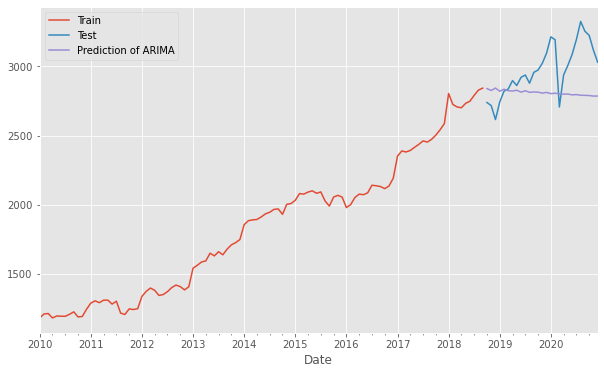

In [266]:
train.plot(legend=True, label='Train', figsize=(10,6))
test.plot(legend=True, label='Test')
pred_arima.plot(legend=True, label='Prediction of ARIMA')
plt.show()

In [267]:
def evalu_arima(train, test,pred):
    error = np.sqrt(mean_squared_error(test, pred))
    error

    test.mean(), np.sqrt(test.var())

    train.plot(legend=True, label='Train', figsize=(10,6), color='b')
    test.plot(legend=True, label='Test', color='m')
    pred.plot(legend=True, label='Prediction of ARIMA', color='g')
    
#     train.plot(legend=True, label='Train', figsize=(10,6), color='b')
#     test.plot(legend=True, label='Test', color='m')
#     pred.plot(legend=True, label='Prediction of ARIMA', color='g')
    plt.show()

In [268]:
def evalu_sarima(train, test,pred_sarima):
    prediction = pd.Series(pred_sarima, index=test.index)
    residual = test - prediction
#     plt.figure(figsize=(10,4))
#     plt.plot(residual)
#     plt.axhline(0, linestyle='--', color='k')
#     plt.ylabel('Error', fontsize=16)
#     plt.figure(figsize=(10,4))
    train.plot(legend=True, label='Train', figsize=(10,6), color='b')
    test.plot(legend=True, label='Test', color='m')
    pred_sarima.plot(legend=True, label='Prediction of SARIMA', color='g')

#     plt.legend(('Data', 'Predictions'), fontsize=16)
#     plt.title('Prediction', fontsize=20)
#     plt.ylabel('Production', fontsize=16)
    plt.show()

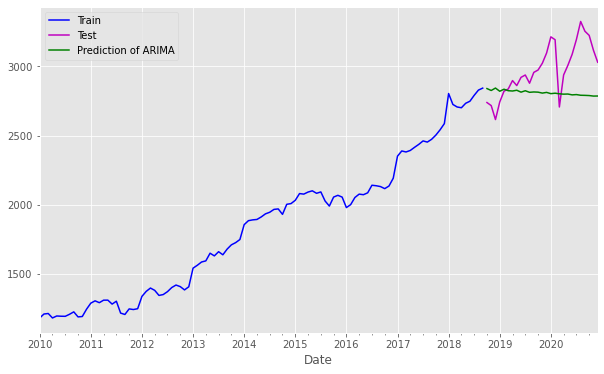

In [269]:
evalu_arima(train, test, pred_arima)

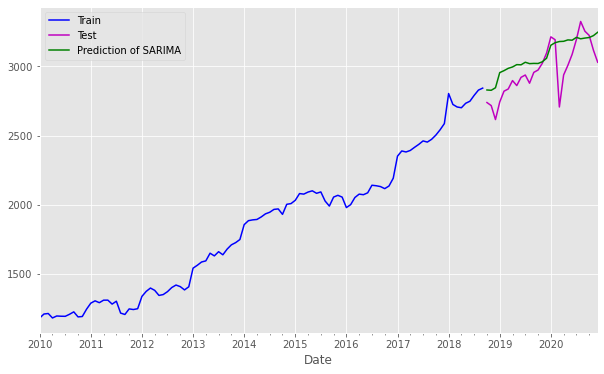

In [270]:
evalu_sarima(train, test,pred_sarima)

##### ix. Predict Future Data - SP500

In [271]:
final_model = ARIMA(SP500_ml_df_ts, order=(4,0,2)).fit()

In [272]:
prediction = final_model.predict(len(SP500_ml_df_ts), len(SP500_ml_df_ts)+12)

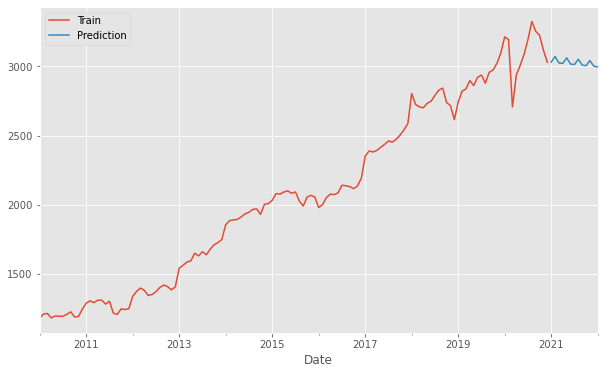

In [273]:
SP500_ml_df_ts.plot(legend=True, label='Train', figsize=(10,6))
prediction.plot(legend=True, label='Prediction')
plt.show()

In [274]:
def futuredata_arima(tick, train, test, p, q, d):
    final_model = ARIMA(tick, order=(p,q,d)).fit()
    prediction = final_model.predict(len(tick), len(tick)+12)
    train.plot(legend=True, label='Train', figsize=(10,6), color='b')
    test.plot(legend=True, label='Test', figsize=(10,6), color='m')
    prediction.plot(legend=True, label='Future Prediction', color='g')
    plt.show()

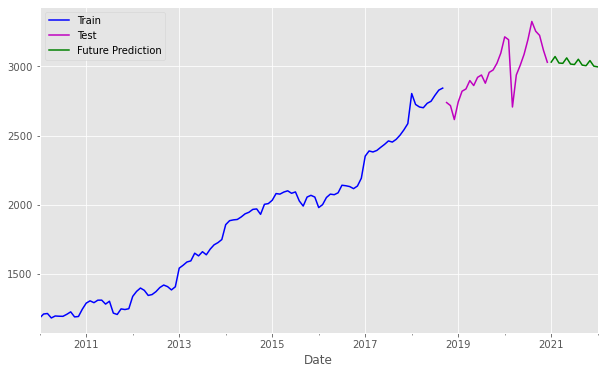

In [275]:
futuredata_arima(SP500_ml_df_ts, train, test, 4,0,2)

In [276]:
def futuredata_sarima(tick, train, test, p, q, d):
    final_model = SARIMAX(train, order=(p, q, d), seasonal_order=(p, q, d, 12)).fit()
    prediction = final_model.predict(len(tick), (len(tick)+12))
    train.plot(legend=True, label='Train', figsize=(10,6), color='b')
    test.plot(legend=True, label='Test', figsize=(10,6), color='m')
    prediction.plot(legend=True, label='Future Prediction', color='g')
    plt.show()

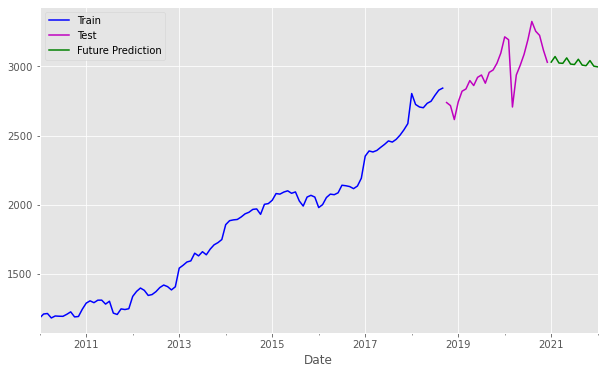

In [277]:
futuredata_arima(SP500_ml_df_ts, train, test, 4,0,2)

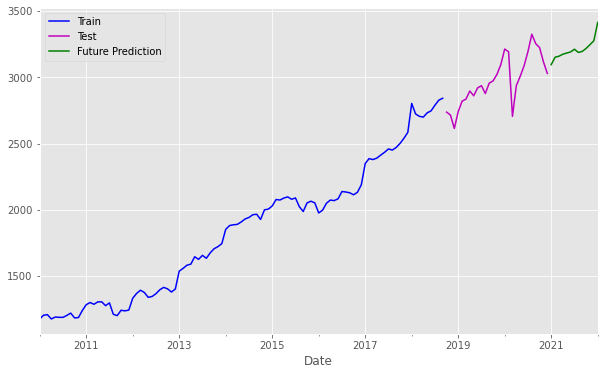

In [278]:
futuredata_sarima(SP500_ml_df_ts, train, test, 4,0,2)

# Model with securities

SP500_ml_df - Already did as above. now we follow with the Securities as below: 

- AAPL_ml_df
- AMZN_ml_df
- GOOG_ml_df
- GS_ml_df
- MRK_ml_df

In [279]:
len(SP500_ml_df_ts)

132

### Part V: c. (2) Time-Series - AAPL Model 

Resample daily to month 
- Data name:
AAPL_ml_df

#### iii. Stationarity Check - AAPL

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: AAPL_TECH_Close, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: AAPL_TECH_Close, dtype: float64


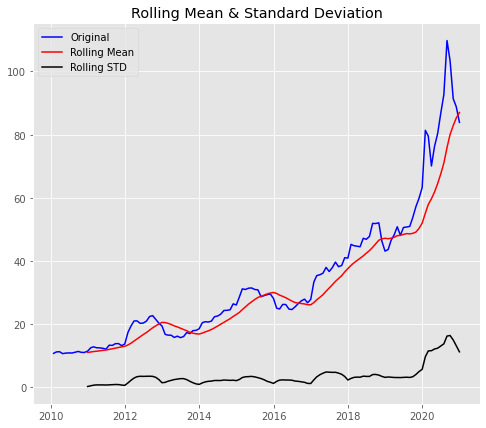

Test Statistic                 2.216299  
P-Value                        0.998896  
#Lags Used                     13.000000 
Number of Observations Used    118.000000
Critical Value (1%){tick}     -3.487022  
Critical Value (5%){tick}     -2.886363  
Critical Value (10%){tick}    -2.580009  
dtype: float64


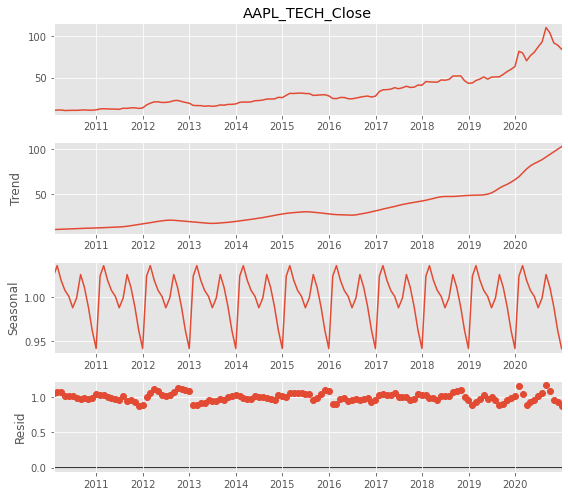

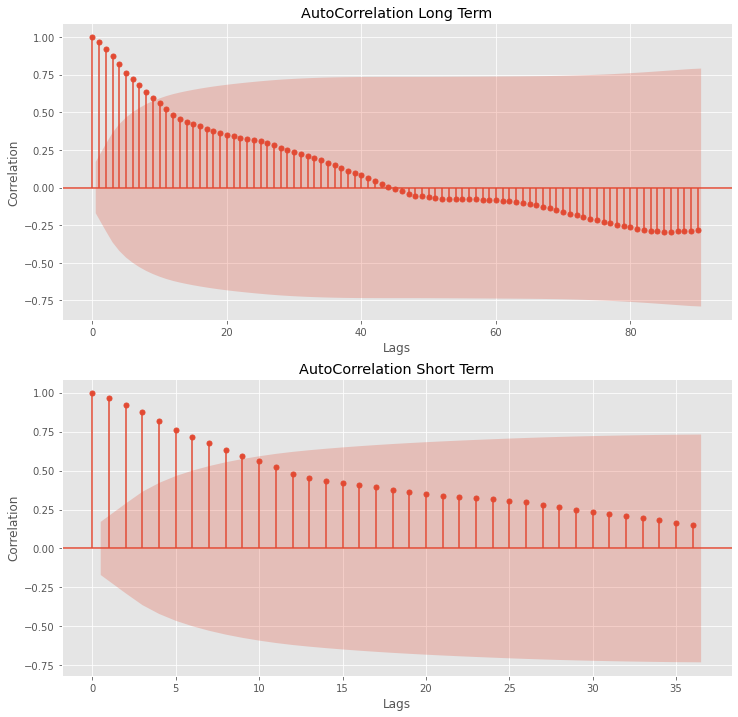

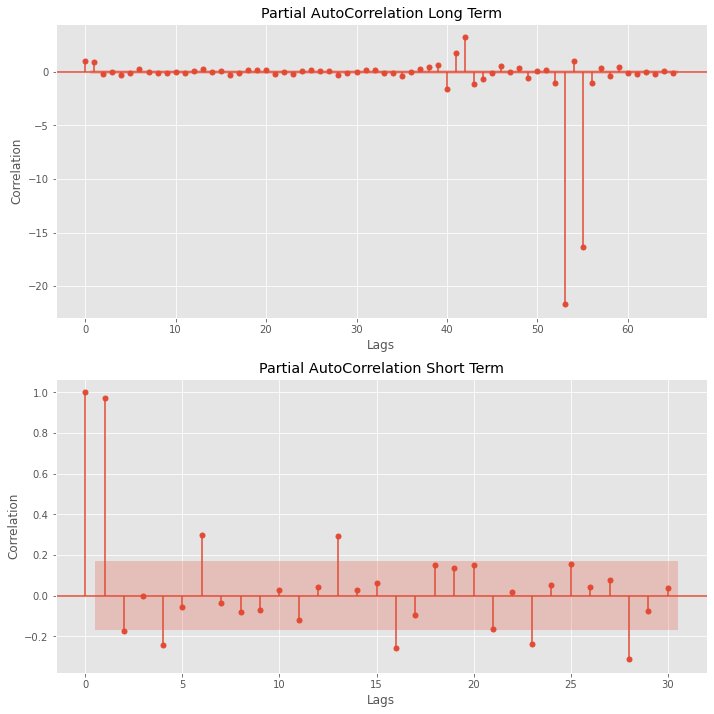

In [280]:
Stationarity(AAPL_ml_df_ts)

#### iv. Train Test Split - AAPL

In [281]:
traintest(AAPL_ml_df_ts)

Date
2010-01-31    10.751190
2010-02-28    11.205536
2010-03-31    11.254286
2010-04-30    10.659107
2010-05-31    10.822679
Freq: M, Name: AAPL_TECH_Close, dtype: float64 Date
2018-10-31    52.080357
2018-11-30    46.263810
2018-12-31    43.118523
2019-01-31    43.627143
2019-02-28    46.471250
Freq: M, Name: AAPL_TECH_Close, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - AAPL

- SARIMA 

Use the same ticker and 0 1 2 12

In [282]:
hyperpar_arima(AAPL_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - AAPL

In [283]:
model_arima_AAPL = ARIMA(train, order=(4,0,2)).fit()

In [284]:
model_sarima_AAPL = sarima(train)
model_sarima_AAPL

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:01:07   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - AAPL

In [285]:
pred_arima_AAPL = model.predict(start=len(train), end=len(AAPL_ml_df_ts)-1)
pred_arima_AAPL.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [286]:
pred_sarima_AAPL = model_sarima_AAPL.predict(start=len(train), end=len(AAPL_ml_df_ts)-1)
pred_sarima_AAPL.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation  - AAPL

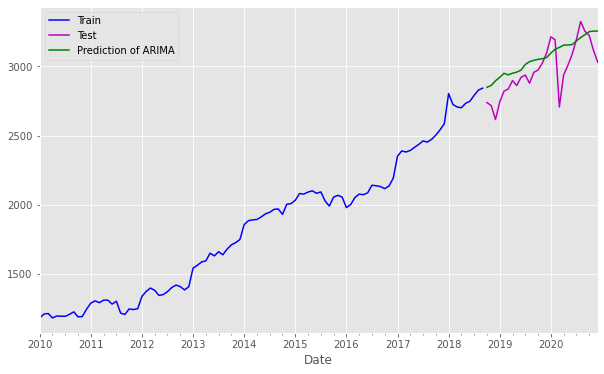

In [287]:
evalu_arima(train, test, pred_arima_AAPL)

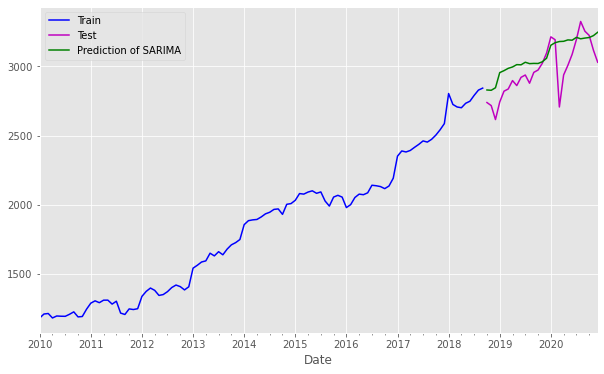

In [288]:
evalu_sarima(train, test,pred_sarima_AAPL)

#### ix Predict Future Data  - AAPL

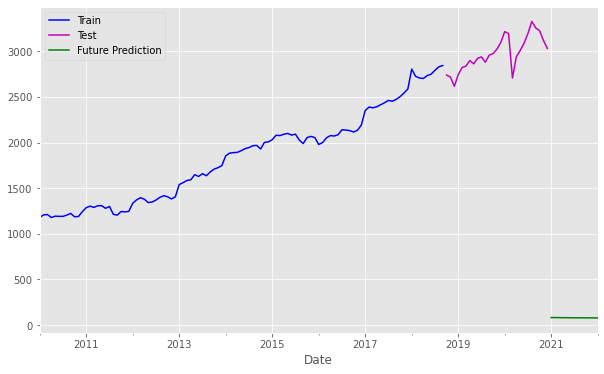

In [289]:
futuredata_arima(AAPL_ml_df_ts,train, test,4,0,2)

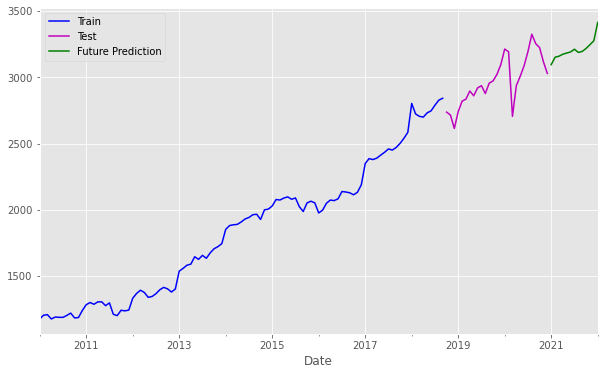

In [290]:
futuredata_sarima(AAPL_ml_df_ts,train, test,4,0,2)

### Part V: c. (3) Time-Series -  AMZN Model

Resample daily to month 

- Data name: AMZN_ml_df

#### iii. Stationarity Check - AMZN

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: AMZN_TECH_Close, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: AMZN_TECH_Close, dtype: float64


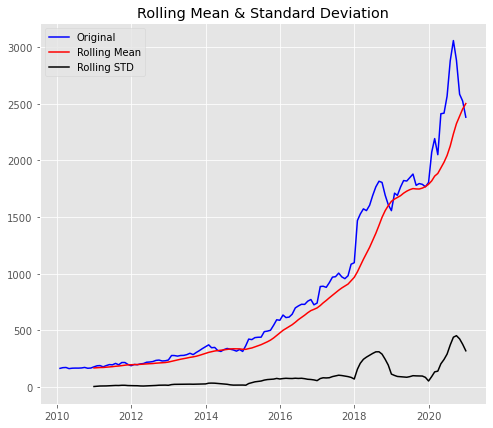

Test Statistic                 1.931790  
P-Value                        0.998577  
#Lags Used                     12.000000 
Number of Observations Used    119.000000
Critical Value (1%){tick}     -3.486535  
Critical Value (5%){tick}     -2.886151  
Critical Value (10%){tick}    -2.579896  
dtype: float64


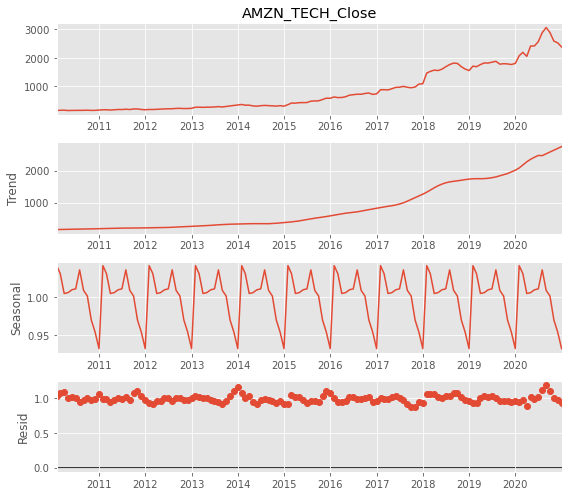

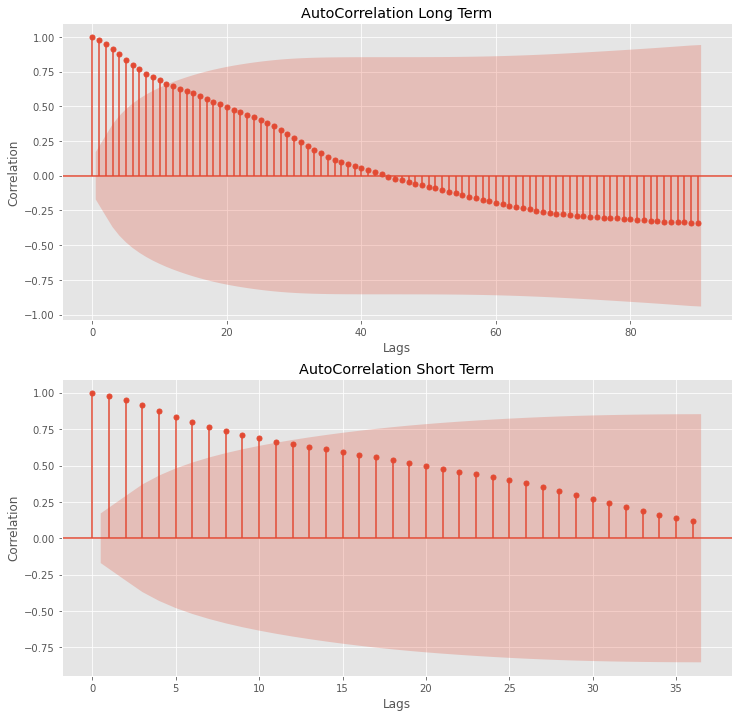

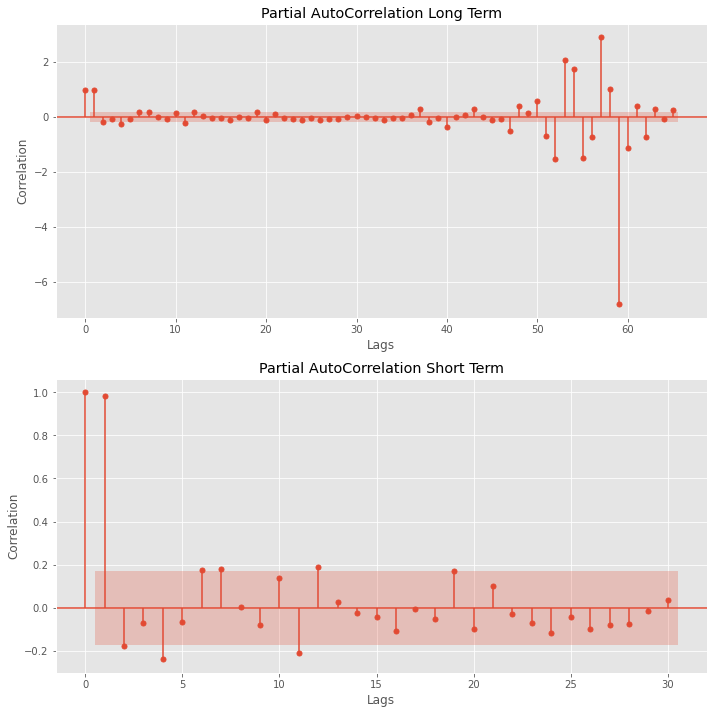

In [291]:
Stationarity(AMZN_ml_df_ts)

#### iv. Train Test Split - AMZN

In [292]:
traintest(AMZN_ml_df_ts)

Date
2010-01-31    164.280004
2010-02-28    170.570000
2010-03-31    172.074997
2010-04-30    162.159996
2010-05-31    165.819999
Freq: M, Name: AMZN_TECH_Close, dtype: float64 Date
2018-10-31    1691.722377
2018-11-30    1608.300961
2018-12-31    1555.691811
2019-01-31    1710.088565
2019-02-28    1690.439433
Freq: M, Name: AMZN_TECH_Close, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - AMZN

- SARIMA 

Use the same ticker and 0 1 2 12

In [293]:
hyperpar_arima(AMZN_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - AMZN

In [294]:
model_arima_AMZN = ARIMA(train, order=(4,0,2)).fit()

In [295]:
model_sarima_AMZN = sarima(train)
model_sarima_AMZN

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:01:25   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - AMZN

In [296]:
pred_arima_AMZN = model_arima_AMZN.predict(start=len(train), end=(len(AMZN_ml_df_ts)-1))

In [297]:
pred_sarima_AMZN = model_sarima_AMZN.predict(start=len(train), end=(len(AMZN_ml_df_ts)-1))
pred_sarima_AMZN.head()


2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - AMZN

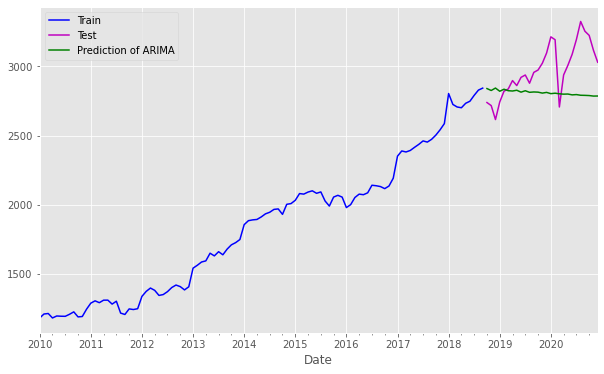

In [298]:
evalu_arima(train, test, pred_arima_AMZN)


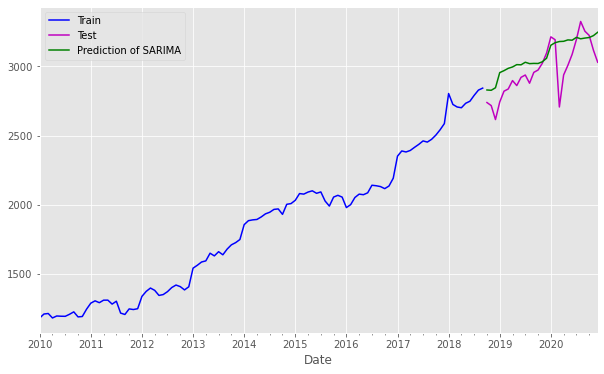

In [299]:
evalu_sarima(train, test,pred_sarima_AMZN)

#### ix. Predict Future Data - AMZN

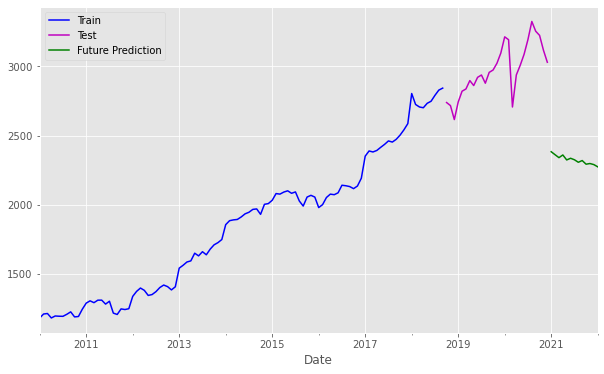

In [300]:
futuredata_arima(AMZN_ml_df_ts,train, test,4,0,2)

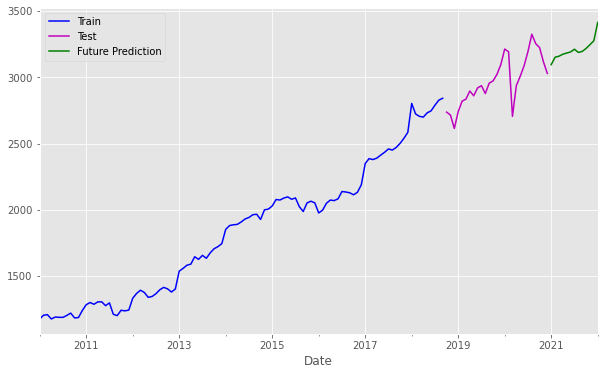

In [301]:
futuredata_sarima(AMZN_ml_df_ts,train, test,4,0,2)

### Part V: c. (4) Time-Series - GOOG Model

Resample daily to month 

- Data name: GOOG_ml_df

#### iii. Stationarity Check - GOOG

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: GOOG_TECH_Close, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: GOOG_TECH_Close, dtype: float64


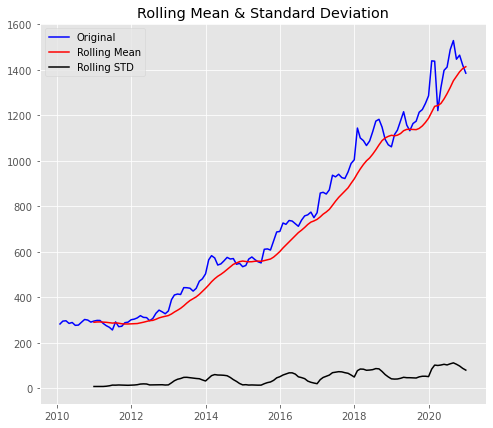

Test Statistic                 1.485424  
P-Value                        0.997470  
#Lags Used                     13.000000 
Number of Observations Used    118.000000
Critical Value (1%){tick}     -3.487022  
Critical Value (5%){tick}     -2.886363  
Critical Value (10%){tick}    -2.580009  
dtype: float64


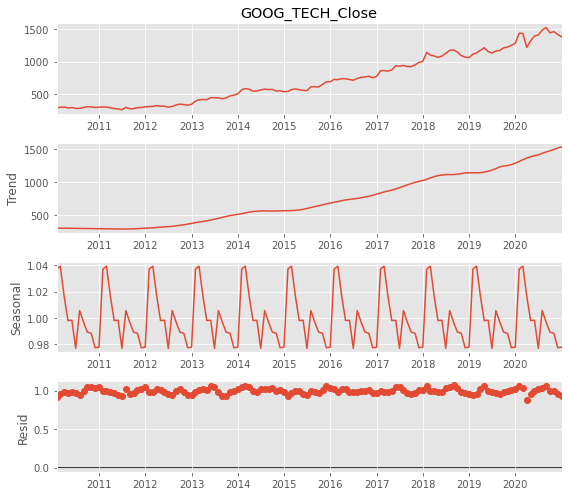

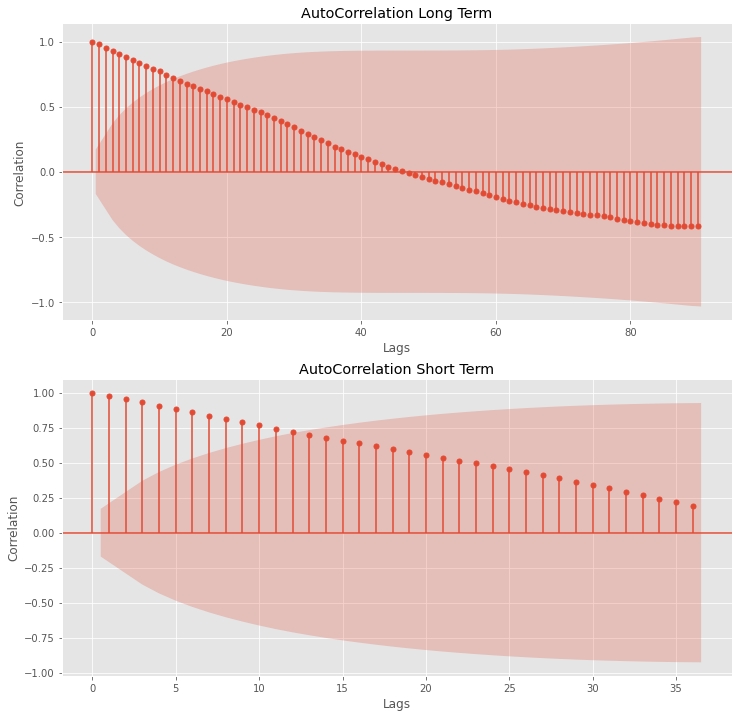

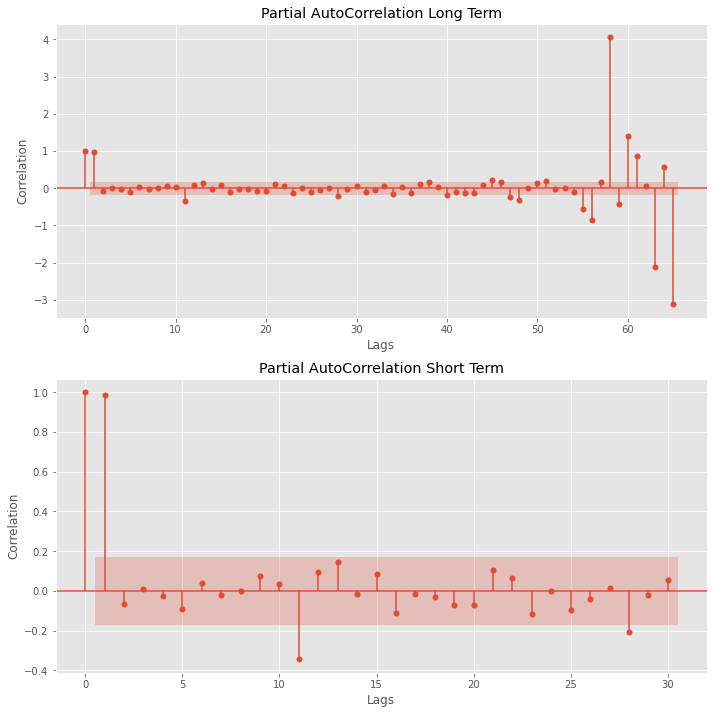

In [302]:
Stationarity(GOOG_ml_df_ts)

#### iv. Train Test Split - GOOG

In [303]:
traintest(GOOG_ml_df_ts)

Date
2010-01-31    283.100535
2010-02-28    295.746475
2010-03-31    297.181091
2010-04-30    285.584564
2010-05-31    289.741470
Freq: M, Name: GOOG_TECH_Close, dtype: float64 Date
2018-10-31    1094.142366
2018-11-30    1071.010481
2018-12-31    1061.939531
2019-01-31    1116.101423
2019-02-28    1135.356683
Freq: M, Name: GOOG_TECH_Close, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - GOOG

- SARIMA 

Use the same ticker and 0 1 2 12


In [304]:
hyperpar_arima(GOOG_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - GOOG

In [305]:
model_arima_GOOG = ARIMA(train, order=(4,0,2)).fit()

In [306]:
model_sarima_GOOG = sarima(train)
model_sarima_GOOG

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:01:41   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - GOOG

In [307]:
pred_arima_GOOG = model.predict(start=len(train), end=len(GOOG_ml_df_ts)-1)
pred_arima_GOOG.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [308]:
pred_sarima_GOOG = model_sarima_GOOG.predict(start=len(train), end=len(GOOG_ml_df_ts)-1)
pred_sarima_GOOG.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - GOOG

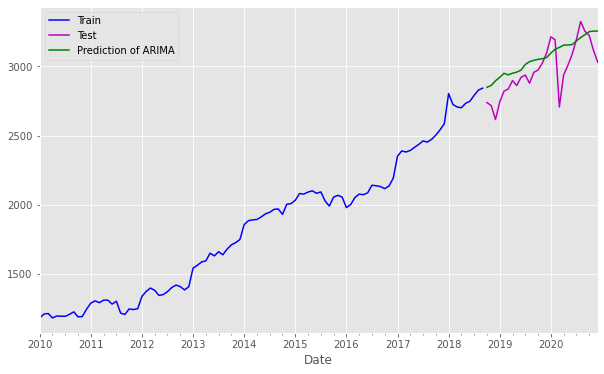

In [309]:
evalu_arima(train, test, pred_arima_GOOG)

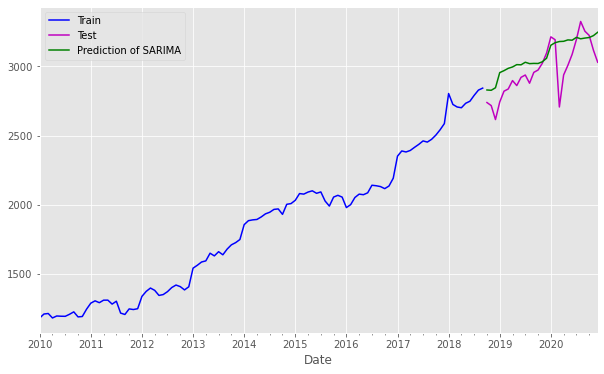

In [310]:
evalu_sarima(train, test,pred_sarima_GOOG)

#### ix Predict Future Data

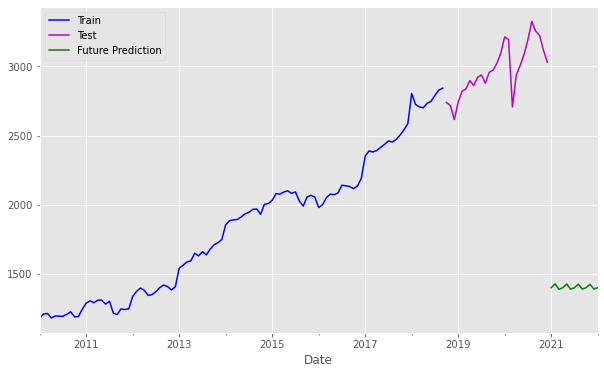

In [311]:
futuredata_arima(GOOG_ml_df_ts,train, test,4,0,2)

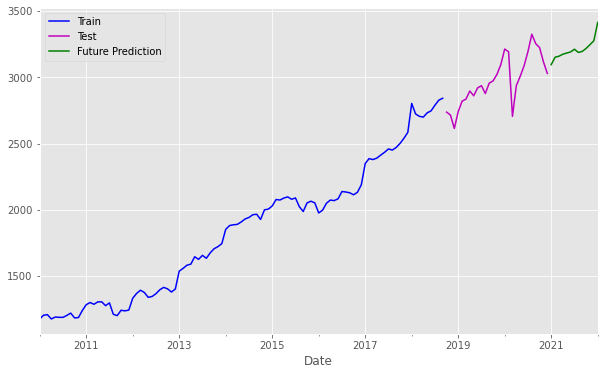

In [312]:
futuredata_sarima(GOOG_ml_df_ts,train, test,4,0,2)

### Part V: b. (5) Time-Series - GS Model

Resample daily to month 

- Data name: GS_ml_df

#### iii. Stationarity Check - GS

In [313]:
#Stationarity(GS)

#### iv. Train Test Split - GS

In [314]:
traintest(GS_ml_df_ts)

Date
2010-01-31    155.906667
2010-02-28    162.660004
2010-03-31    162.470002
2010-04-30    156.480003
2010-05-31    160.320007
Freq: M, Name: GS_FI_Close, dtype: float64 Date
2018-10-31    223.256667
2018-11-30    208.917145
2018-12-31    196.748182
2019-01-31    199.329523
2019-02-28    198.525555
Freq: M, Name: GS_FI_Close, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - GS

- SARIMA 

Use the same ticker and 0 1 2 12


In [315]:
hyperpar_arima(GS_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - GS

In [316]:
model_arima_GS = ARIMA(train, order=(4,0,2)).fit()

In [317]:
model_sarima_GS = sarima(train)
model_sarima_GS

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:01:56   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - GS

In [318]:
pred_arima_GS = model.predict(start=len(train), end=len(GS_ml_df_ts)-1)
pred_arima_GS.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [319]:
pred_sarima_GS = model_sarima_GS.predict(start=len(train), end=len(GS_ml_df_ts)-1)
pred_sarima_GS.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - GS

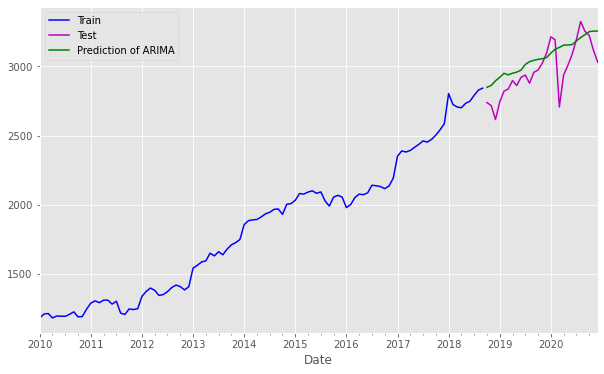

In [320]:
evalu_arima(train, test, pred_arima_GS)

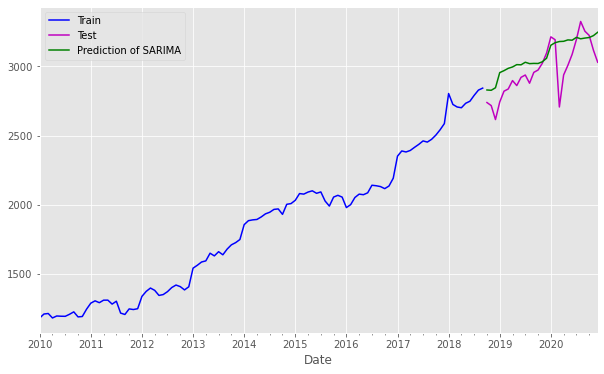

In [321]:
evalu_sarima(train, test,pred_sarima_GS)

#### ix. Predict Future Data - GS

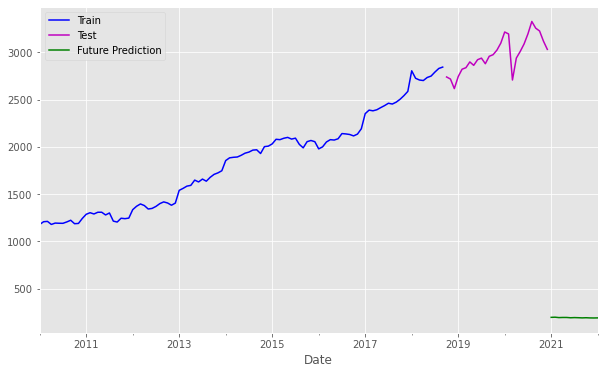

In [322]:
futuredata_arima(GS_ml_df_ts,train, test,4,0,2)

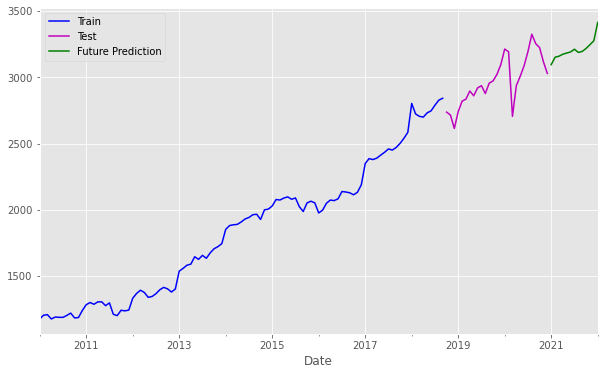

In [323]:
futuredata_sarima(GS_ml_df_ts,train, test,4,0,2)

### Part V: b. (6) Time-Series - MRK Model

Resample daily to month 

- Data name: MRK_ml_df

#### iii. Stationarity Check - MRK

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: MRK_HP_Close, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, Name: MRK_HP_Close, dtype: float64


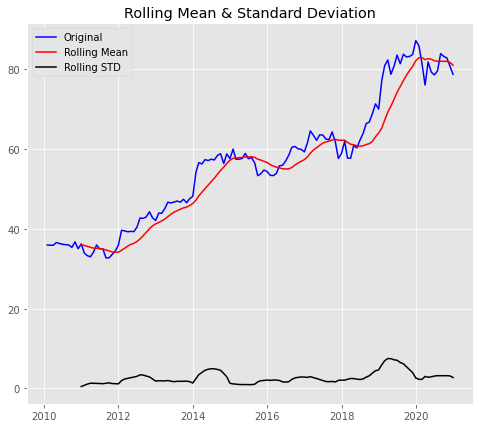

Test Statistic                -0.574669  
P-Value                        0.876604  
#Lags Used                     0.000000  
Number of Observations Used    131.000000
Critical Value (1%){tick}     -3.481282  
Critical Value (5%){tick}     -2.883868  
Critical Value (10%){tick}    -2.578677  
dtype: float64


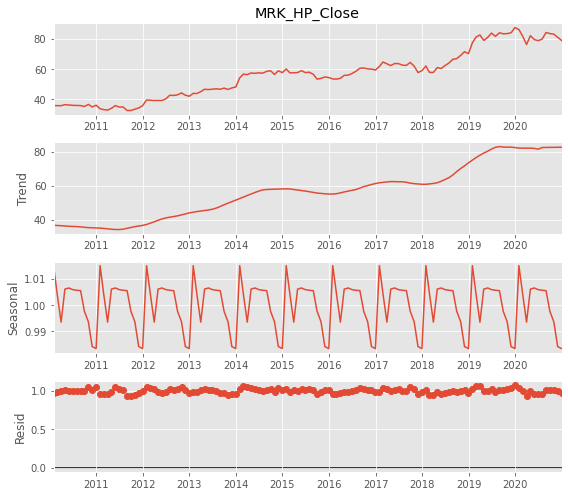

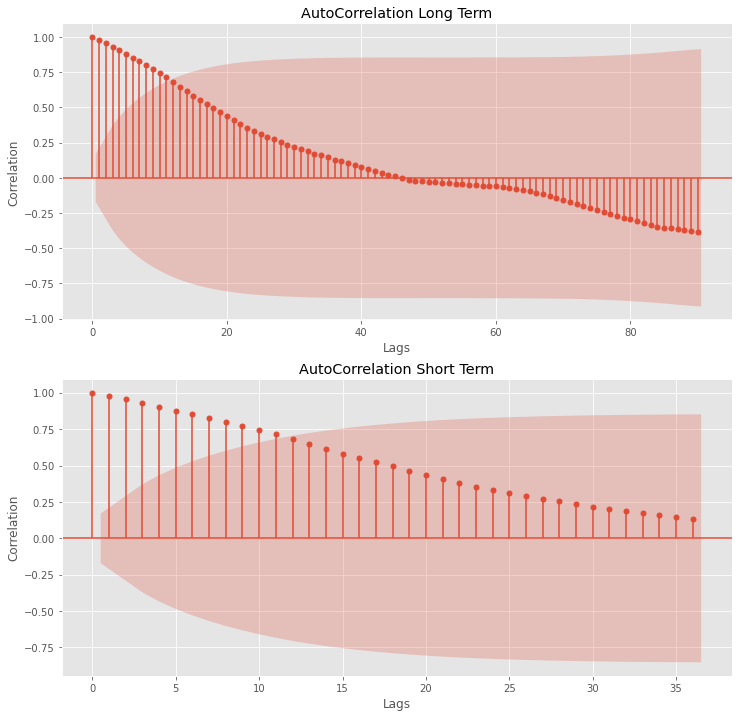

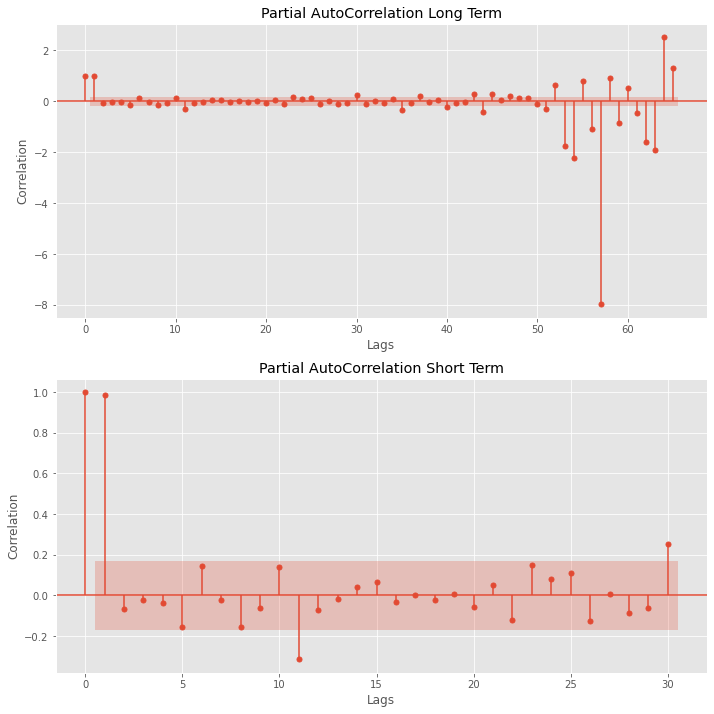

In [324]:
Stationarity(MRK_ml_df_ts)

#### iv. Train Test Split - MRK

In [325]:
traintest(MRK_ml_df_ts)

Date
2010-01-31    35.970000
2010-02-28    35.915001
2010-03-31    35.904999
2010-04-30    36.585001
2010-05-31    36.360000
Freq: M, Name: MRK_HP_Close, dtype: float64 Date
2018-10-31    68.962381
2018-11-30    71.368095
2018-12-31    70.053637
2019-01-31    77.257144
2019-02-28    80.946111
Freq: M, Name: MRK_HP_Close, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - MRK

- SARIMA 

Use the same ticker and 0 1 2 12

In [326]:
hyperpar_arima(MRK_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - MRK

In [327]:
model_arima_MRK = ARIMA(train, order=(4,0,2)).fit()

In [328]:
model_sarima_MRK = sarima(train)
model_sarima_MRK

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:02:11   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - MRK

In [329]:
pred_arima_MRK = model.predict(start=len(train), end=len(MRK_ml_df_ts)-1)
pred_arima_MRK.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [330]:
pred_sarima_MRK = model_sarima_MRK.predict(start=len(train), end=len(MRK_ml_df_ts)-1)
pred_sarima_MRK.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - MRK

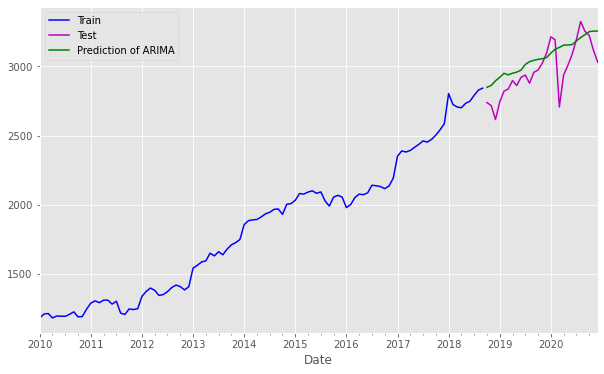

In [331]:
evalu_arima(train, test, pred_arima_MRK)

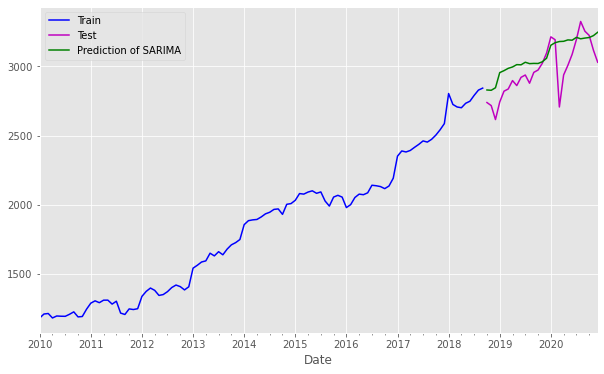

In [332]:
evalu_sarima(train, test,pred_sarima_MRK)

#### ix. Predict Future Data - MRK

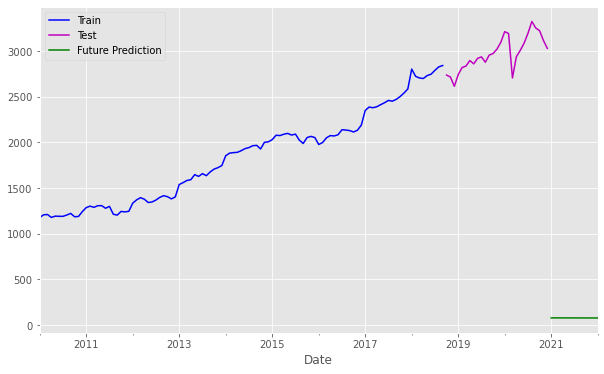

In [333]:
futuredata_arima(MRK_ml_df_ts,train, test,4,0,2)

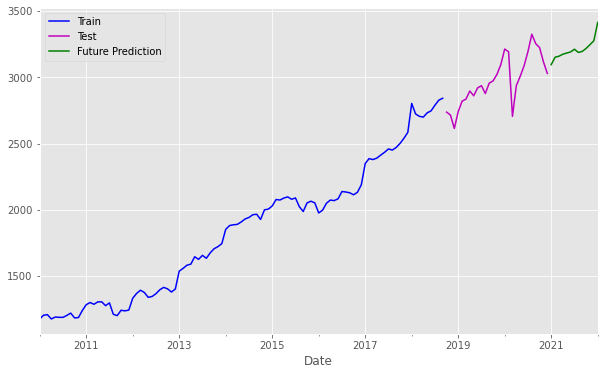

In [334]:
futuredata_sarima(MRK_ml_df_ts,train, test,4,0,2)

### Part V: c. (5) Time-Series - JNJ Model

Resample daily to month 

- Data name: JNJ_ml_df

#### iii. Stationarity Check - JNJ

In [335]:
#Stationarity(JNJ)

#### iv. Train Test Split - JNJ

In [336]:
traintest(JNJ_ml_df_ts)

Date
2010-01-31    62.619999
2010-02-28    63.239999
2010-03-31    63.375002
2010-04-30    63.215000
2010-05-31    63.725001
Freq: M, Name: JNJ_HP_Close, dtype: float64 Date
2018-10-31    136.915714
2018-11-30    140.524285
2018-12-31    132.408636
2019-01-31    131.746666
2019-02-28    135.623334
Freq: M, Name: JNJ_HP_Close, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - JNJ

- SARIMA 

Use the same ticker and 0 1 2 12


In [337]:
hyperpar_arima(JNJ_ml_df_ts)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - JNJ

In [338]:
model_arima_JNJ = ARIMA(train, order=(4,0,2)).fit()

In [339]:
model_sarima_JNJ = sarima(train)
model_sarima_JNJ

ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:02:27   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - JNJ

In [340]:
pred_arima_JNJ = model.predict(start=len(train), end=len(JNJ_ml_df_ts)-1)
pred_arima_JNJ.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [341]:
pred_sarima_JNJ = model_sarima_JNJ.predict(start=len(train), end=len(JNJ_ml_df_ts)-1)
pred_sarima_JNJ.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - JNJ

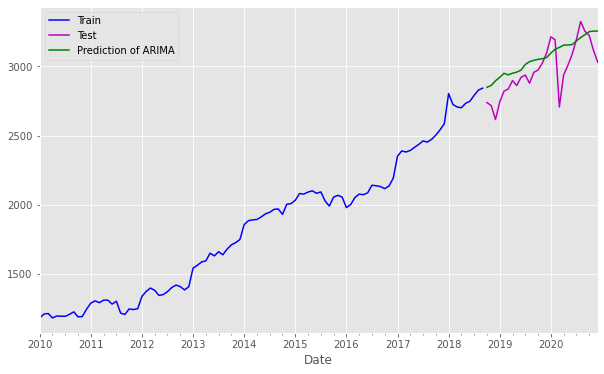

In [342]:
evalu_arima(train, test, pred_arima_JNJ)

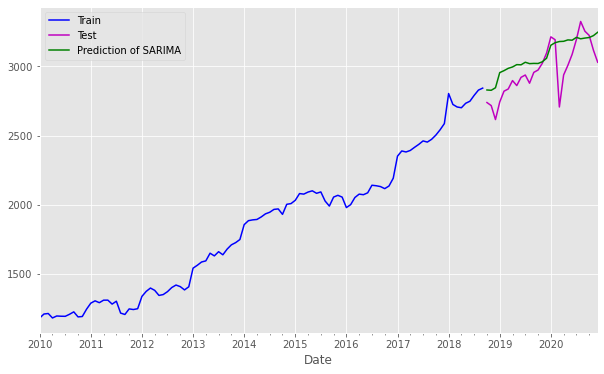

In [343]:
evalu_sarima(train, test,pred_sarima_JNJ)

#### ix. Predict Future Data - JNJ

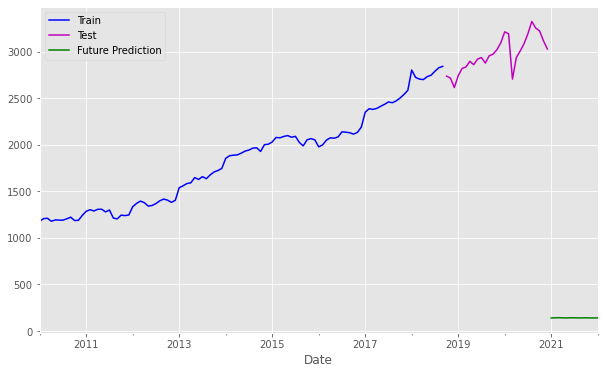

In [344]:
futuredata_arima(JNJ_ml_df_ts,train, test,4,0,2)

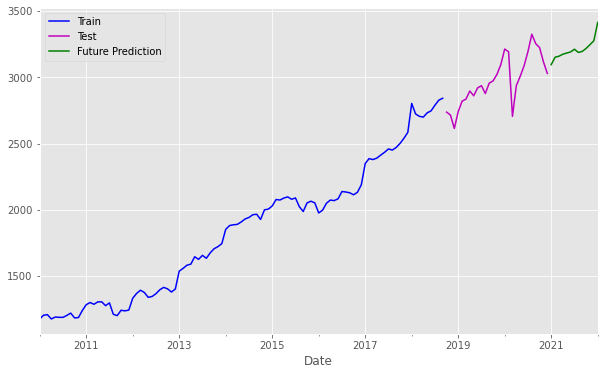

In [345]:
futuredata_sarima(JNJ_ml_df_ts,train, test,4,0,2)

# Part VI

## Part VI: (a) Portfolio 1 and Return calculation

In [381]:
data.head()

,SP500_Open,SP500_High,SP500_Low,SP500_Close,SP500_Adj Close,SP500_Volume,AAPL_TECH_Open,AAPL_TECH_High,AAPL_TECH_Low,AAPL_TECH_Close,AAPL_TECH_Adj Close,AAPL_TECH_Volume,AMZN_TECH_Open,AMZN_TECH_High,AMZN_TECH_Low,AMZN_TECH_Close,AMZN_TECH_Adj Close,AMZN_TECH_Volume,GOOG_TECH_Open,GOOG_TECH_High,GOOG_TECH_Low,GOOG_TECH_Close,GOOG_TECH_Adj Close,GOOG_TECH_Volume,ALK_AV_Open,ALK_AV_High,ALK_AV_Low,ALK_AV_Close,ALK_AV_Adj Close,ALK_AV_Volume,HA_AV_Open,HA_AV_High,HA_AV_Low,HA_AV_Close,HA_AV_Adj Close,HA_AV_Volume,AAL_AV_Open,AAL_AV_High,AAL_AV_Low,AAL_AV_Close,AAL_AV_Adj Close,AAL_AV_Volume,GS_FI_Open,GS_FI_High,GS_FI_Low,GS_FI_Close,GS_FI_Adj Close,GS_FI_Volume,CS_FI_Open,CS_FI_High,CS_FI_Low,CS_FI_Close,CS_FI_Adj Close,CS_FI_Volume,DB_FI_Open,DB_FI_High,DB_FI_Low,DB_FI_Close,DB_FI_Adj Close,DB_FI_Volume,BHC_HP_Open,BHC_HP_High,BHC_HP_Low,BHC_HP_Close,BHC_HP_Adj Close,BHC_HP_Volume,JNJ_HP_Open,JNJ_HP_High,JNJ_HP_Low,JNJ_HP_Close,JNJ_HP_Adj Close,JNJ_HP_Volume,MRK_HP_Open,MRK_HP_High,MRK_HP_Low,MRK_HP_Close,MRK_HP_Adj Close,MRK_HP_Volume
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-10,1143.489990,1150.300049,1139.420044,1146.239990,1146.239990,4298910000,10.219643,10.235000,10.048214,10.090000,8.719163,448142800,157.080002,157.440002,152.199997,153.710007,153.710007,8683400.0,264.010437,264.319275,260.523499,261.828613,261.828613,4466600.0,12.9325,12.9625,12.3675,12.4475,10.972344,1663600.0,6.02,6.05,5.88,5.96,5.742526,645400.0,9.29,9.39,9.21,9.29,8.758067,3603800,145.199997,148.500000,144.820007,147.699997,127.147858,7439800.0,41.835938,42.285156,41.562500,42.226563,30.167257,1814900.0,52.585876,52.862595,52.003819,52.595421,44.981487,2010600.0,25.120001,25.879999,25.100000,25.750000,24.757708,5778700.0,62.090000,62.250000,61.570000,61.750000,45.970119,9773200.0,36.759998,36.840000,36.349998,36.599998,26.052284,11741900.0
2010-04-10,1144.959961,1148.160034,1131.869995,1137.030029,1137.030029,3604110000,10.057143,10.103572,9.920357,9.951428,8.599421,435302000,153.949997,155.960007,152.789993,155.389999,155.389999,5346500.0,261.494843,263.138702,258.456238,260.199707,260.199707,3895400.0,12.4300,12.5900,11.9975,12.1425,10.703489,1512400.0,5.96,6.00,5.73,5.75,5.540189,618900.0,9.24,9.48,9.05,9.12,8.597802,3856800,147.699997,148.470001,144.699997,146.570007,126.175117,5866700.0,42.265625,42.431641,41.582031,41.914063,29.943998,1085600.0,52.204197,52.604961,51.412212,51.755726,44.263348,1245600.0,25.750000,25.990000,25.590000,25.870001,24.873083,4187200.0,61.540001,61.980000,61.299999,61.669998,45.910553,8703600.0,36.490002,36.750000,36.290001,36.520000,25.995331,9234900.0
2010-05-10,1140.680054,1162.760010,1140.680054,1160.750000,1160.750000,4068840000,10.071428,10.337500,10.065000,10.319285,8.917298,501967200,157.080002,161.210007,157.009995,160.869995,160.869995,5620000.0,263.203461,268.991760,262.291870,268.110046,268.110046,7040400.0,12.2600,12.2850,11.9450,12.2150,10.767396,2567200.0,5.82,5.93,5.77,5.85,5.636539,534800.0,9.27,9.35,9.15,9.23,8.701504,3896600,147.559998,150.279999,146.070007,149.570007,128.757706,8724700.0,42.607422,43.427734,42.509766,43.154297,30.830046,1025300.0,52.891220,54.427483,52.795803,53.950382,46.140301,2270900.0,26.040001,26.330000,25.830000,26.299999,25.286512,4610300.0,62.080002,62.939999,62.009998,62.799999,46.751797,12439400.0,36.860001,37.150002,36.700001,37.020000,26.351234,10669200.0
2010-06-10,1159.810059,1162.329956,1154.849976,1159.969971,1159.969971,4073160000,10.342500,10.428214,10.187857,10.328215,8.925013,670868800,160.600006,160.679993,154.600006,155.399994,155.399994,6060800.0,268.623138,268.966858,263.980530,266.177307,266.177307,5545200.0,12.2200,12.3950,12.0875,12.1875,10.743157,1043600.0,5.85,6.05,5.85,5.97,5.752162,2563900.0,9.27,9.40,9.15,9.23,8.701504,3230200,149.750000,152.330002,149.130005,150.839996,129.850906,6330600.0,43.496094,43.701172,43.330078,43.437500,31.032362,871300.0,54.723282,54.971375,54.398853,54.608780,46.703384,18

In [382]:
portfolio_return_1 = pd.DataFrame()
portfolio_return_1["AAPL_TECH_Close"] = data["AAPL_TECH_Close"] * data["AAPL_TECH_Volume"]
portfolio_return_1["AMZN_TECH_Close"] = data["AMZN_TECH_Open"] * data["AMZN_TECH_Volume"]
portfolio_return_1["GOOG_TECH_Close"] = data["GOOG_TECH_Close"] * data["GOOG_TECH_Volume"]
portfolio_return_1["GS_FI_Close"] = data["GS_FI_Close"] * data["GS_FI_Volume"]
portfolio_return_1["MRK_HP_Close"] = data["MRK_HP_Close"] * data["MRK_HP_Volume"]

portfolio_return_1.head()

SP500_ml_df_ts = SP500_ml_df['SP500_Close'].resample('M').mean()
AAPL_ts = portfolio_return_1["AAPL_TECH_Close"].resample('M').mean()
AMZN_ts = portfolio_return_1["AMZN_TECH_Close"].resample('M').mean()
GOOG_ts = portfolio_return_1["GOOG_TECH_Close"].resample('M').mean()
GS_ts = portfolio_return_1["GS_FI_Close"].resample('M').mean()
MRK_ts = portfolio_return_1["MRK_HP_Close"].resample('M').mean()

### This value for weights already found in Sharpe Ratio session and this value is stored in final_wights

In [383]:
final_weights_1

array([0.463, 0.444, 0.008, 0.001, 0.084])

In [384]:
np.sum(final_weights_1)

1.0

### Final Portfolio if we invest 1 million and the split would be shows as below for investment

In [385]:
(portfolio_return_1/portfolio_return_1.iloc[0])*final_weights_1*100000

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,GS_FI_Close,MRK_HP_Close
Date,,,,,
2010-01-10,46300.000000,4.440000e+04,800.000000,100.000000,8400.000000
2010-04-10,44355.703239,2.679301e+04,693.353454,78.252324,6592.085217
2010-05-10,53039.368979,2.873621e+04,1291.237831,118.755373,7720.192292
2010-06-10,70947.364314,3.168457e+04,1009.680716,86.899972,5455.381498
2010-07-10,43194.555777,2.354747e+04,868.592345,61.490029,9972.183863
2010-08-10,70804.037703,3.494730e+04,1049.025502,72.590223,6262.729336
2010-11-10,46201.953658,2.262005e+04,968.038691,61.696725,4017.478227
2010-12-10,60978.297574,2.621623e+04,1390.118359,90.087075,7906.788257
2010-10-13,69158.171332,2.873015e+04,1135.597689,79.222389,7090.676991


## Investing 100000 with the weight we recommended by ML as below:

- AAPL
- AMZN
- GOOG
- GS 
- MRK 

In [386]:
final_weights_1

array([0.463, 0.444, 0.008, 0.001, 0.084])

In [387]:
np.round(final_weights_1.sum(), 2)

1.0

In [388]:
portfolio_1 = ((AAPL_ts * final_weights_1[0])  + (AMZN_ts *  final_weights_1[1]) + (GOOG_ts *  final_weights_1[2]) + (GS_ts *  final_weights_1[3]) + (MRK_ts *  final_weights_1[4]) * 1000000)
portfolio_1.head()

Date
2010-01-31    5.436235e+13
2010-02-28    7.111350e+13
2010-03-31    3.064648e+13
2010-04-30    3.242582e+13
2010-05-31    5.033245e+13
Freq: M, dtype: float64

#### iii. Stationarity Check - Portfolio

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, dtype: float64


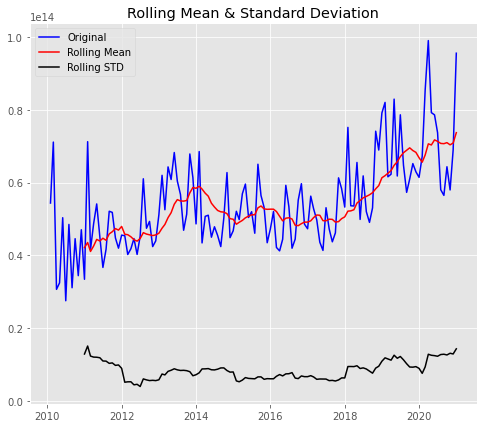

Test Statistic                -0.825954  
P-Value                        0.811379  
#Lags Used                     8.000000  
Number of Observations Used    123.000000
Critical Value (1%){tick}     -3.484667  
Critical Value (5%){tick}     -2.885340  
Critical Value (10%){tick}    -2.579463  
dtype: float64


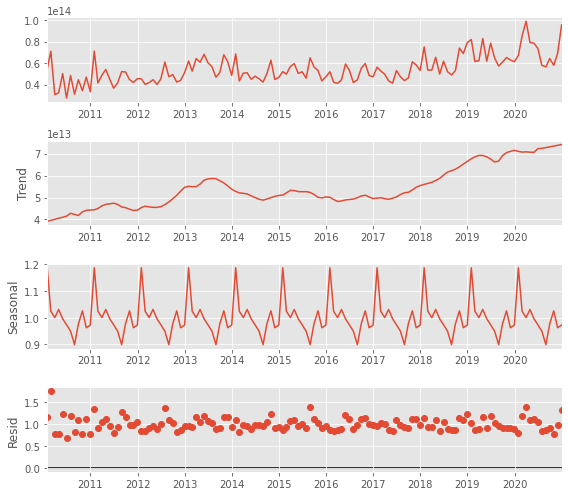

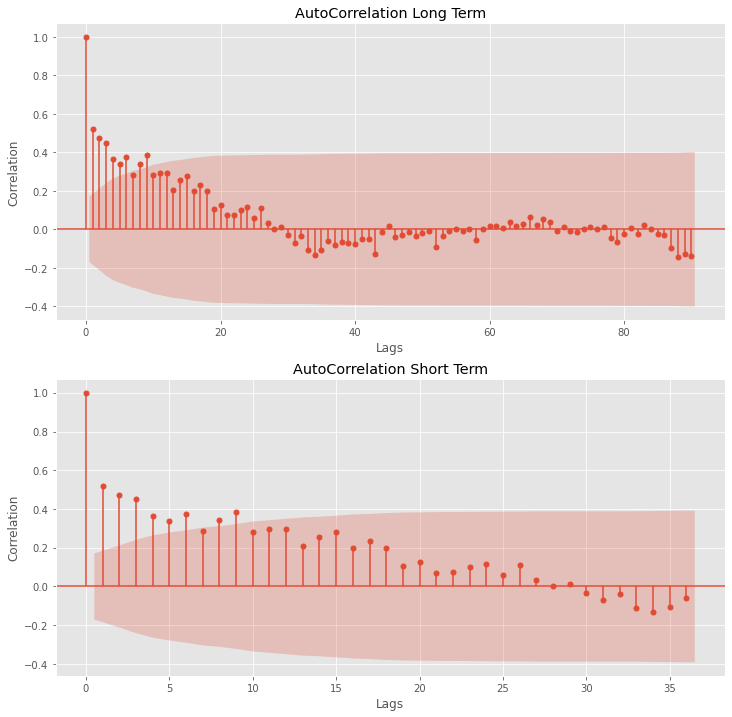

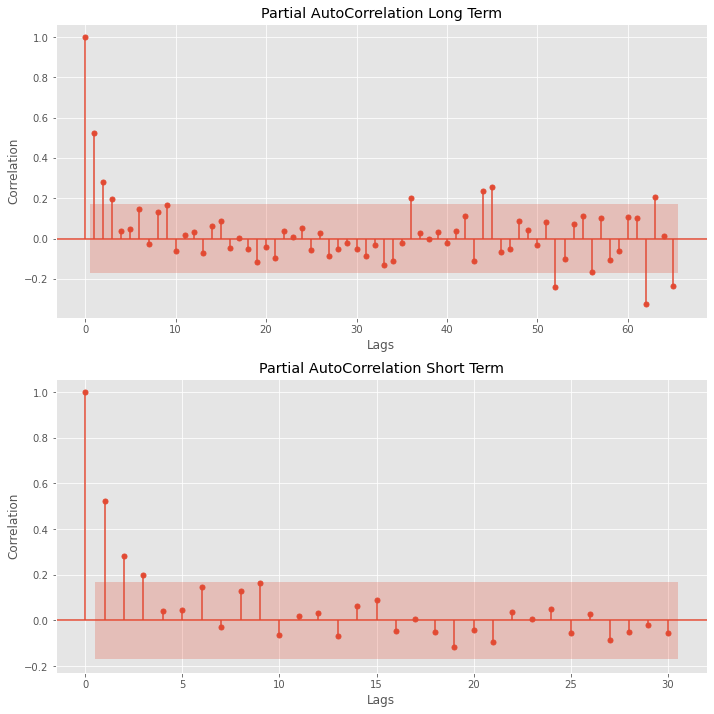

In [389]:
Stationarity(portfolio_1)

In [390]:
#### iv. Train Test Split - Portfolio¶

In [391]:
traintest(portfolio_1)

Date
2010-01-31    5.436235e+13
2010-02-28    7.111350e+13
2010-03-31    3.064648e+13
2010-04-30    3.242582e+13
2010-05-31    5.033245e+13
Freq: M, dtype: float64 Date
2018-10-31    7.409989e+13
2018-11-30    6.892751e+13
2018-12-31    7.913497e+13
2019-01-31    8.201370e+13
2019-02-28    6.157911e+13
Freq: M, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - Portfolio
SARIMA
Use the same ticker and 0 1 2 12

In [392]:
hyperpar_arima(portfolio_1)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - Portfolio

In [393]:
model_arima_Portfolio_1 = ARIMA(train, order=(4,0,2)).fit()
model_sarima_Portfolio_1 = sarima(train)
model_sarima_Portfolio_1


ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:23:21   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - Portfolio

In [394]:
pred_arima_Portfolio_1 = model.predict(start=len(train), end=len(portfolio_1)-1)
pred_arima_Portfolio_1.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [395]:
pred_sarima_Portfolio_1 = model_sarima_Portfolio_1.predict(start=len(train), end=len(portfolio_1)-1)
pred_sarima_Portfolio_1.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - Portfolio

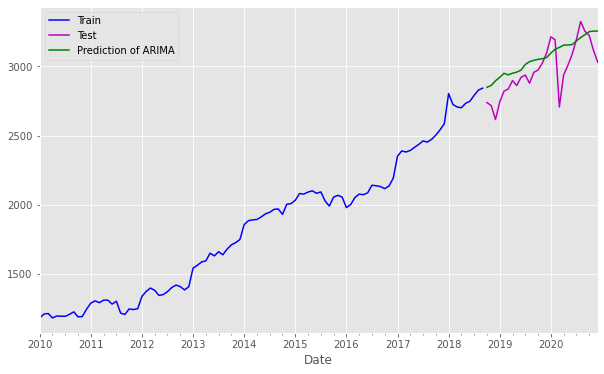

In [396]:
evalu_arima(train, test, pred_arima_Portfolio_1)

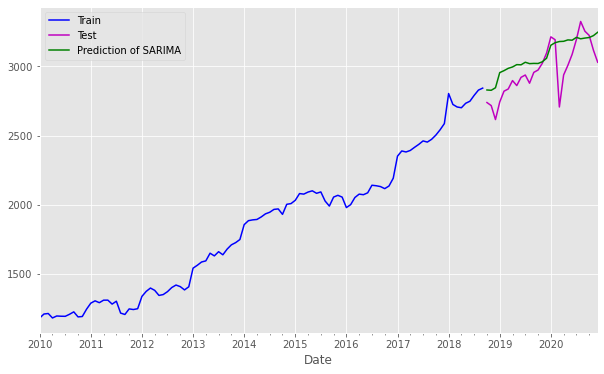

In [397]:
evalu_sarima(train, test,pred_sarima_Portfolio_1)

#### ix. Predict Future Data - Portfolio

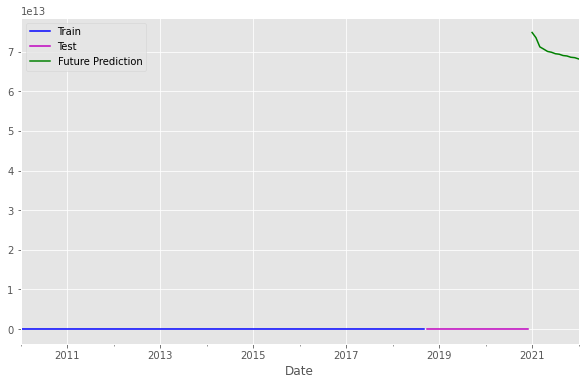

In [398]:
futuredata_arima(portfolio_1,train, test,4,0,2)

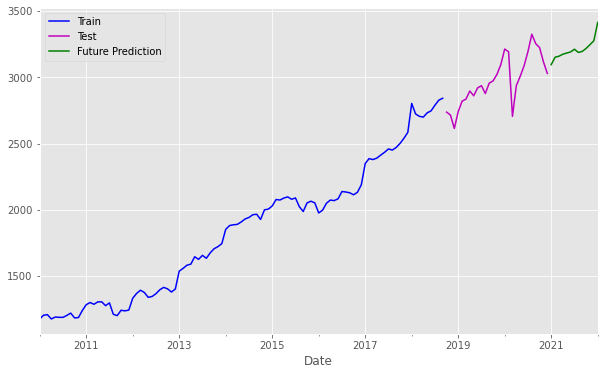

In [399]:
futuredata_sarima(portfolio_1,train, test,4,0,2)

## Part VI: (b) Portfolio 2 and Return calculation

In [403]:
portfolio_return_2 = pd.DataFrame()
portfolio_return_2["AAPL_TECH_Close"] = data["AAPL_TECH_Close"] * data["AAPL_TECH_Volume"]
portfolio_return_2["AMZN_TECH_Close"] = data["AMZN_TECH_Close"] * data["AMZN_TECH_Volume"]
portfolio_return_2["GOOG_TECH_Close"] = data["GOOG_TECH_Close"] * data["GOOG_TECH_Volume"]
portfolio_return_2["JNJ_HP_Close"] = data["JNJ_HP_Close"] * data["JNJ_HP_Volume"]
portfolio_return_2["MRK_HP_Close"] = data["MRK_HP_Close"] * data["MRK_HP_Volume"]

portfolio_return_1.head()

AAPL_ts = portfolio_return_2["AAPL_TECH_Close"].resample('M').mean()
AMZN_ts = portfolio_return_2["AMZN_TECH_Close"].resample('M').mean()
GOOG_ts = portfolio_return_2["GOOG_TECH_Close"].resample('M').mean()
JNJ_ts = portfolio_return_2["JNJ_HP_Close"].resample('M').mean()
MRK_ts = portfolio_return_2["MRK_HP_Close"].resample('M').mean()

### This value for weights already found in Sharpe Ratio session and this value is stored in final_wights

In [413]:
final_weights_2

array([0.403, 0.465, 0.015, 0.057, 0.06 ])

In [414]:
np.sum(final_weights_2)

1.0000000000000002

### Final Portfolio if we invest 1 million and the split would be shows as below for investment

In [415]:
(data_2_portfolio_2/data_2_portfolio_2.iloc[0])*final_weights_2*100000

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,
2010-01-10,40300.000000,4.650000e+04,1500.000000,5700.000000,6000.000000
2010-04-10,39746.536016,4.700823e+04,1490.668098,5692.615200,5986.885573
2010-05-10,41215.776561,4.866602e+04,1535.985943,5796.922985,6068.852791
2010-06-10,41251.443459,4.701125e+04,1524.913400,5834.769138,6067.213118
2010-07-10,41255.721090,4.727444e+04,1512.528031,5835.692400,6018.032952
2010-08-10,41947.547076,4.705663e+04,1530.620832,5836.615385,6050.820003
2010-11-10,42131.561110,4.629429e+04,1537.726761,5843.076831,6042.623445
2010-12-10,42585.169762,4.733797e+04,1545.003848,5842.153938,6006.557541
2010-10-13,42813.401962,4.694167e+04,1550.454629,5868.923262,6091.803612


## Investing 100000 with the weight we recommended by ML as below:

- AAPL
- AMZN
- GOOG
- JNJ
- MRK 

In [416]:
final_weights_2

array([0.403, 0.465, 0.015, 0.057, 0.06 ])

In [417]:
np.round(final_weights_2.sum(), 2)

1.0

In [418]:
portfolio_2 = ((AAPL_ml_df_ts * final_weights_2[0])  + (AMZN_ml_df_ts *  final_weights_2[1]) + (GOOG_ml_df_ts *  final_weights_2[2]) + (GS_ml_df_ts *  final_weights_2[3]) + (MRK_ml_df_ts *  final_weights_2[4]) * 1000000)
portfolio_2.head()

Date
2010-01-31    2.158294e+06
2010-02-28    2.154998e+06
2010-03-31    2.154398e+06
2010-04-30    2.195193e+06
2010-05-31    2.181695e+06
Freq: M, dtype: float64

#### iii. Stationarity Check - Portfolio

Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, dtype: float64 Date
2010-01-31   NaN
2010-02-28   NaN
2010-03-31   NaN
2010-04-30   NaN
2010-05-31   NaN
Freq: M, dtype: float64


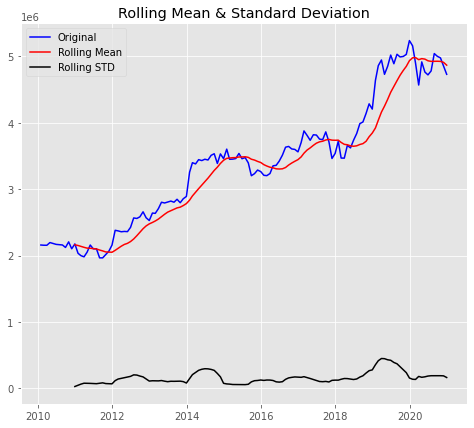

Test Statistic                -0.574051  
P-Value                        0.876738  
#Lags Used                     0.000000  
Number of Observations Used    131.000000
Critical Value (1%){tick}     -3.481282  
Critical Value (5%){tick}     -2.883868  
Critical Value (10%){tick}    -2.578677  
dtype: float64


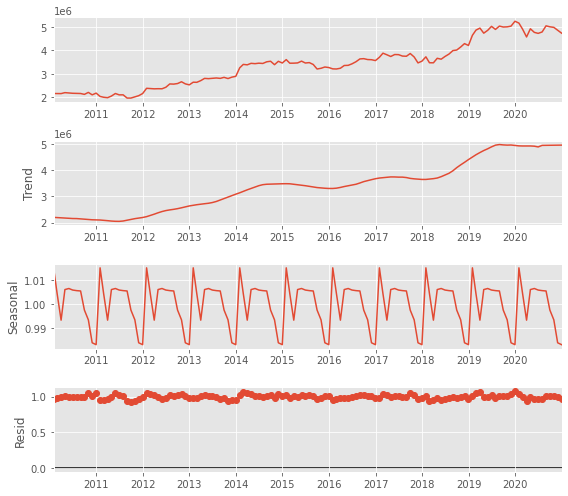

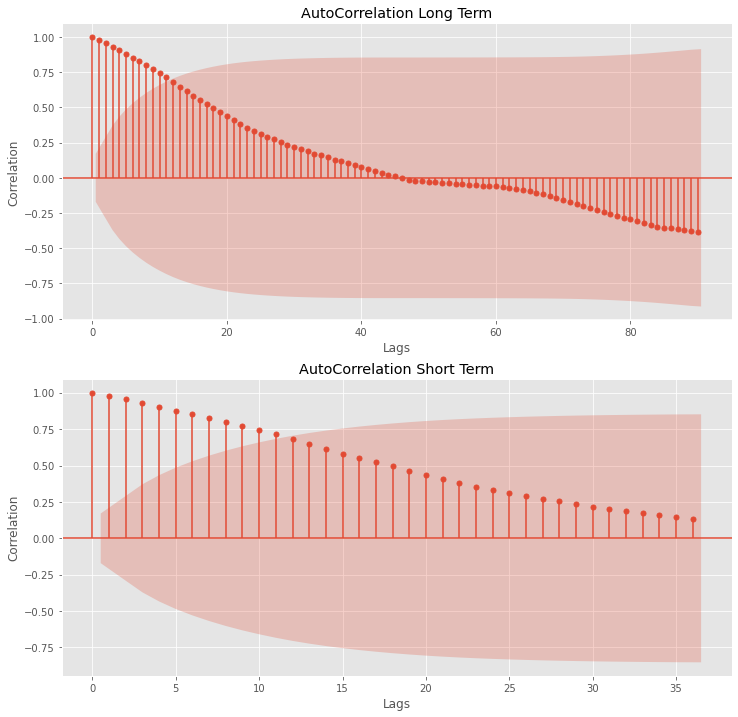

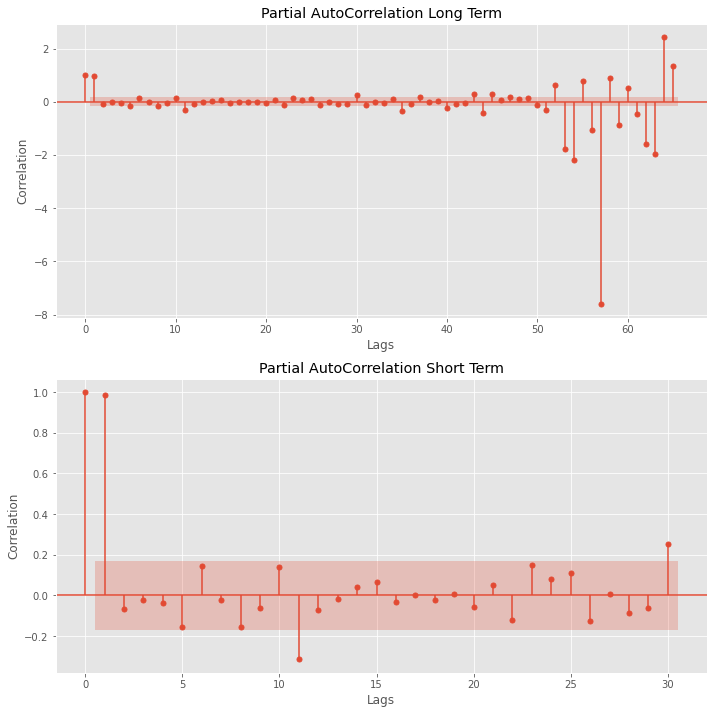

In [419]:
Stationarity(portfolio_2)

#### iv. Train Test Split - Portfolio¶

In [420]:
traintest(portfolio_2)

Date
2010-01-31    2.158294e+06
2010-02-28    2.154998e+06
2010-03-31    2.154398e+06
2010-04-30    2.195193e+06
2010-05-31    2.181695e+06
Freq: M, dtype: float64 Date
2018-10-31    4.138580e+06
2018-11-30    4.282880e+06
2018-12-31    4.203986e+06
2019-01-31    4.636269e+06
2019-02-28    4.857600e+06
Freq: M, dtype: float64


#### v. Hyperparameters of ARIMA Model = p d q - Portfolio
SARIMA
Use the same ticker and 0 1 2 12

In [421]:
hyperpar_arima(portfolio_2)

                 RMSE
(3, 0, 4)  129.472542
(2, 1, 3)  136.710585
(4, 1, 2)  137.688134
(2, 1, 4)  137.799840
(3, 1, 3)  144.633739


#### vi. Build ARIMA Model - Portfolio

In [422]:
model_arima_Portfolio_2 = ARIMA(train, order=(4,0,2)).fit()
model_sarima_Portfolio_2 = sarima(train)
model_sarima_Portfolio_2


ar.L1       2.571175   
ar.L2      -2.578736   
ar.L3       1.140621   
ar.L4      -0.133136   
ma.L1      -1.676647   
ma.L2       0.973112   
ma.S.L12   -0.805917   
ma.S.L24   -0.120446   
sigma2      1255.658098
dtype: float64
                                     SARIMAX Results                                      
Dep. Variable:                        SP500_Close   No. Observations:                  105
Model:             SARIMAX(4, 0, 2)x(0, 1, 2, 12)   Log Likelihood                -477.697
Date:                            Sat, 05 Mar 2022   AIC                            973.395
Time:                                    22:26:26   BIC                            996.188
Sample:                                01-31-2010   HQIC                           982.598
                                     - 09-30-2018                                         
Covariance Type:                              opg                                         
                 coef    std err         

#### vii. Predict Test Data - Portfolio

In [423]:
pred_arima_Portfolio_2 = model.predict(start=len(train), end=len(portfolio_2)-1)
pred_arima_Portfolio_2.head()

2018-10-31    2849.291302
2018-11-30    2862.207841
2018-12-31    2895.989763
2019-01-31    2920.887607
2019-02-28    2950.316408
Freq: M, Name: predicted_mean, dtype: float64

In [424]:
pred_sarima_Portfolio_2 = model_sarima_Portfolio_2.predict(start=len(train), end=len(portfolio_2)-1)
pred_sarima_Portfolio_2.head()

2018-10-31    2829.646405
2018-11-30    2827.434224
2018-12-31    2845.761134
2019-01-31    2955.434843
2019-02-28    2969.638594
Freq: M, Name: predicted_mean, dtype: float64

#### viii. Model Evaluation - Portfolio

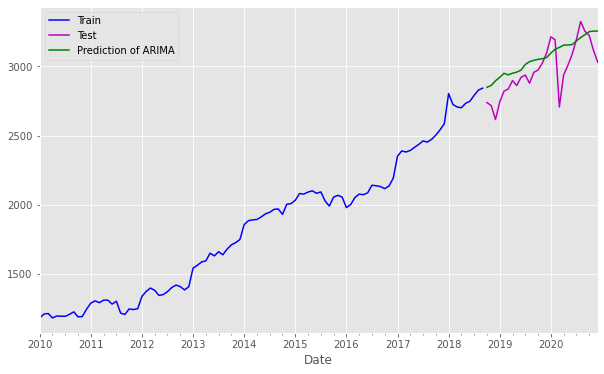

In [425]:
evalu_arima(train, test, pred_arima_Portfolio_2)

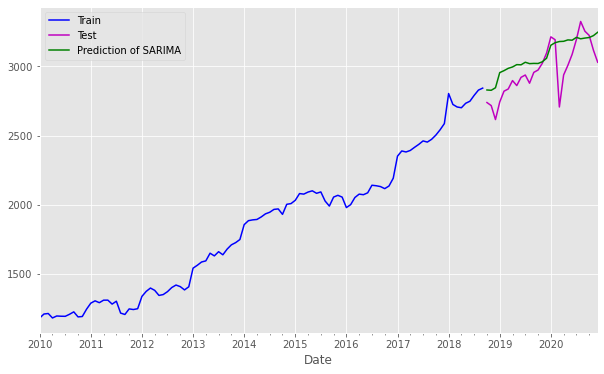

In [426]:
evalu_sarima(train, test,pred_sarima_Portfolio_2)

#### ix. Predict Future Data - Portfolio

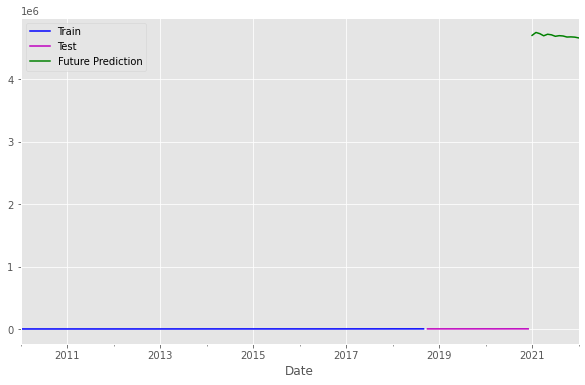

In [427]:
futuredata_arima(portfolio_2,train, test,4,0,2)

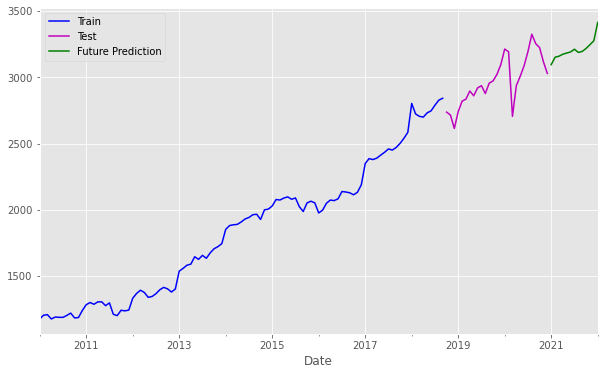

In [428]:
futuredata_sarima(portfolio_2,train, test,4,0,2)

In [430]:
portfolio_return_2.head()

,AAPL_TECH_Close,AMZN_TECH_Close,GOOG_TECH_Close,JNJ_HP_Close,MRK_HP_Close
Date,,,,,
2010-01-10,4.521761e+09,1.334725e+09,1.169484e+09,6.034951e+08,4.297535e+08
2010-04-10,4.331877e+09,8.307926e+08,1.013582e+09,5.367510e+08,3.372585e+08
2010-05-10,5.179943e+09,9.040894e+08,1.887602e+09,7.811943e+08,3.949738e+08
2010-06-10,6.928877e+09,9.418483e+08,1.476006e+09,7.167887e+08,2.791035e+08
2010-07-10,4.218476e+09,7.222800e+08,1.269756e+09,6.212377e+08,5.101882e+08


In [431]:
portfolio_return_2.to_csv("final_dataset.csv")